In [2]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
#file_path = 'loan.csv'
file_path = '/content/drive/MyDrive/lending-club-case-study/loan.csv'

df = pd.read_csv(file_path)
df = df[df['loan_status'] != 'Current']
# Display the dataframe
df.head()


,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
5,1075269,1311441,5000,5000,5000.0,36 months,7.90%,156.46,A,A4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [4]:
df.describe()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
count,3.857700e+04,3.857700e+04,38577.000000,38577.000000,38577.000000,38577.000000,3.857700e+04,38577.000000,38577.000000,38577.000000,...,0.0,0.0,0.0,0.0,37880.000000,38538.0,0.0,0.0,0.0,0.0
mean,6.763787e+05,8.422843e+05,11047.025430,10784.058506,10222.481123,322.466318,6.877797e+04,13.272727,0.146668,0.871737,...,NaN,NaN,NaN,NaN,0.043479,0.0,NaN,NaN,NaN,NaN
std,2.092639e+05,2.644519e+05,7348.441646,7090.306027,7022.720644,208.639215,6.421868e+04,6.673044,0.492271,1.071546,...,NaN,NaN,NaN,NaN,0.204583,0.0,NaN,NaN,NaN,NaN
min,5.473400e+04,7.069900e+04,500.000000,500.000000,0.000000,15.690000,4.000000e+03,0.000000,0.000000,0.000000,...,NaN,NaN,NaN,NaN,0.000000,0.0,NaN,NaN,NaN,NaN
25%,5.120330e+05,6.611310e+05,5300.000000,5200.000000,5000.000000,165.740000,4.000000e+04,8.130000,0.000000,0.000000,...,NaN,NaN,NaN,NaN,0.000000,0.0,NaN,NaN,NaN,NaN
50%,6.564230e+05,8.392920e+05,9600.000000,9550.000000,8733.440000,277.860000,5.886800e+04,13.370000,0.000000,1.000000,...,NaN,NaN,NaN,NaN,0.000000,0.0,NaN,NaN,NaN,NaN
75%,8.291460e+05,1.037336e+06,15000.000000,15000.000000,14000.000000,425.550000,8.200000e+04,18.560000,0.000000,1.000000,...,NaN,NaN,NaN,NaN,0.000000,0.0,NaN,NaN,NaN,NaN
max,1.077501e+06,1.314167e+06,35000.000000,35000.000000,35000.000000,1305.190000,6.000000e+06,29.990000,11.000000,8.000000,...,NaN,NaN,NaN,NaN,2.000000,0.0,NaN,NaN,NaN,NaN


In [5]:
df.columns

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       ...
       'num_tl_90g_dpd_24m', 'num_tl_op_past_12m', 'pct_tl_nvr_dlq',
       'percent_bc_gt_75', 'pub_rec_bankruptcies', 'tax_liens',
       'tot_hi_cred_lim', 'total_bal_ex_mort', 'total_bc_limit',
       'total_il_high_credit_limit'],
      dtype='object', length=111)

In [6]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

cols_null_val_perctg = df.isnull().mean()*100
cols_null_val_perctg

id                                  0.000000
member_id                           0.000000
loan_amnt                           0.000000
funded_amnt                         0.000000
funded_amnt_inv                     0.000000
term                                0.000000
int_rate                            0.000000
installment                         0.000000
grade                               0.000000
sub_grade                           0.000000
emp_title                           6.185033
emp_length                          2.677761
home_ownership                      0.000000
annual_inc                          0.000000
verification_status                 0.000000
issue_d                             0.000000
loan_status                         0.000000
pymnt_plan                          0.000000
url                                 0.000000
desc                               32.477901
purpose                             0.000000
title                               0.028514
zip_code  

In [7]:
cols_zero_null_val_perctg = cols_null_val_perctg[cols_null_val_perctg < 30].index

cols_zero_null_val_perctg

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'pymnt_plan', 'url', 'purpose', 'title',
       'zip_code', 'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util',
       'total_acc', 'initial_list_status', 'out_prncp', 'out_prncp_inv',
       'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'policy_code', 'application_type',
       'acc_now_delinq', 'chargeoff_within_12_mths', 'delinq_amnt',
       'pub_rec_bankruptcies', 'tax_liens'],
      dtype='object')

In [8]:
df = df[cols_zero_null_val_perctg]

non_neg_cols = df.nunique()

df = df[non_neg_cols[non_neg_cols > 1].index]

df.info()


<class 'pandas.core.frame.DataFrame'>
Index: 38577 entries, 0 to 39716
Data columns (total 42 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       38577 non-null  int64  
 1   member_id                38577 non-null  int64  
 2   loan_amnt                38577 non-null  int64  
 3   funded_amnt              38577 non-null  int64  
 4   funded_amnt_inv          38577 non-null  float64
 5   term                     38577 non-null  object 
 6   int_rate                 38577 non-null  object 
 7   installment              38577 non-null  float64
 8   grade                    38577 non-null  object 
 9   sub_grade                38577 non-null  object 
 10  emp_title                36191 non-null  object 
 11  emp_length               37544 non-null  object 
 12  home_ownership           38577 non-null  object 
 13  annual_inc               38577 non-null  float64
 14  verification_status      38

In [9]:
#'out_prncp', 'out_prncp_inv',

num_cols = ['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'int_rate', 'installment', 'annual_inc', 'dti', 'revol_bal', 'revol_util',  'total_pymnt',
            'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries', 'collection_recovery_fee', 'last_pymnt_amnt']
cat_cols = ['term', 'grade', 'sub_grade', 'emp_length', 'home_ownership', 'verification_status', 'loan_status', 'purpose', 'zip_code', 'addr_state', 'delinq_2yrs',
            'inq_last_6mths', 'open_acc', 'pub_rec', 'total_acc', 'pub_rec_bankruptcies']
date_cols = ['issue_d', 'last_pymnt_d', 'last_credit_pull_d', 'earliest_cr_line']
extra_cols = ['id', 'member_id','emp_title', 'pymnt_plan', 'url', 'title']

len(num_cols)+len(cat_cols)+len(extra_cols)+len(date_cols)

43

In [10]:
df[num_cols].isnull().mean()*100

loan_amnt                  0.000000
funded_amnt                0.000000
funded_amnt_inv            0.000000
int_rate                   0.000000
installment                0.000000
annual_inc                 0.000000
dti                        0.000000
revol_bal                  0.000000
revol_util                 0.129611
total_pymnt                0.000000
total_pymnt_inv            0.000000
total_rec_prncp            0.000000
total_rec_int              0.000000
total_rec_late_fee         0.000000
recoveries                 0.000000
collection_recovery_fee    0.000000
last_pymnt_amnt            0.000000
dtype: float64

In [11]:
df['revol_util'] = pd.to_numeric(df['revol_util'].str.replace('%', ''))/100

print("Number of NaN values before fillna:", df['revol_util'].isna().sum())
mean_revolve_util = df['revol_util'].mean()

# Fill NaN values in the specified column with the mean value
df['revol_util'].fillna(mean_revolve_util, inplace=True)
print("Number of NaN values before fillna:", df['revol_util'].isna().sum())

Number of NaN values before fillna: 50
Number of NaN values before fillna: 0


In [12]:
df[cat_cols].isnull().mean()*100

term                    0.000000
grade                   0.000000
sub_grade               0.000000
emp_length              2.677761
home_ownership          0.000000
verification_status     0.000000
loan_status             0.000000
purpose                 0.000000
zip_code                0.000000
addr_state              0.000000
delinq_2yrs             0.000000
inq_last_6mths          0.000000
open_acc                0.000000
pub_rec                 0.000000
total_acc               0.000000
pub_rec_bankruptcies    1.806776
dtype: float64

In [13]:
df['emp_length'] = df['emp_length'].str.replace('years?', '', regex=True)
mode_emp_length = df['emp_length'].mode()

print("Number of NaN values before fillna:", df['emp_length'].isna().sum())
df['emp_length'].fillna(mode_emp_length[0], inplace=True)

print("Number of NaN values before fillna:", df['emp_length'].isna().sum())

Number of NaN values before fillna: 1033
Number of NaN values before fillna: 0


In [14]:
mode_emp_length = df['pub_rec_bankruptcies'].mode()

print("Number of NaN values before fillna:", df['pub_rec_bankruptcies'].isna().sum())
df['pub_rec_bankruptcies'].fillna(mode_emp_length[0], inplace=True)

print("Number of NaN values before fillna:", df['pub_rec_bankruptcies'].isna().sum())

Number of NaN values before fillna: 697
Number of NaN values before fillna: 0



 Creating Histogram for: loan_amnt


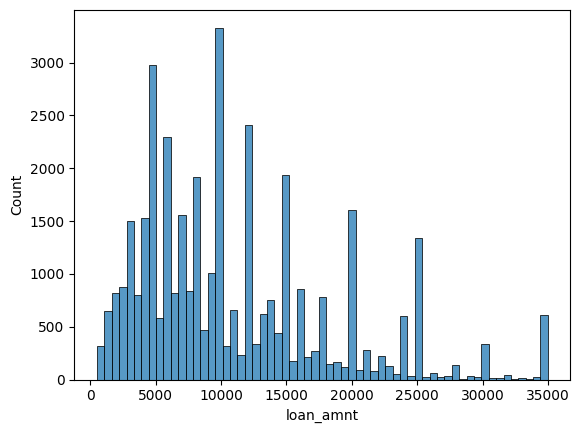


 Creating Histogram for: funded_amnt


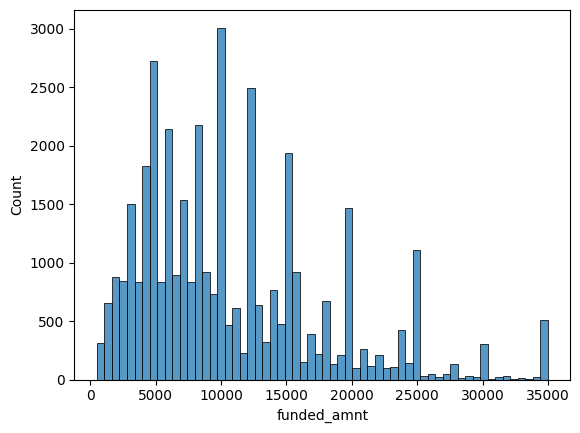


 Creating Histogram for: funded_amnt_inv


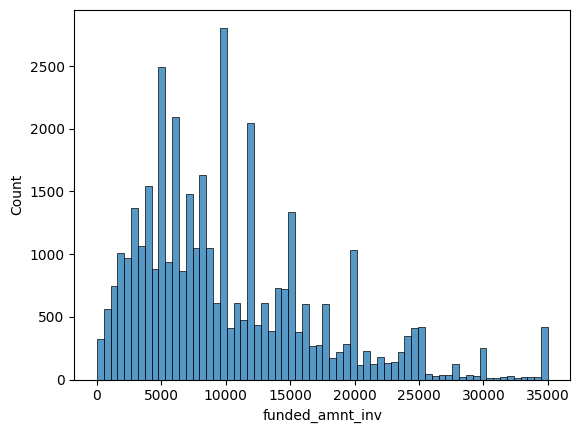


 Creating Histogram for: int_rate


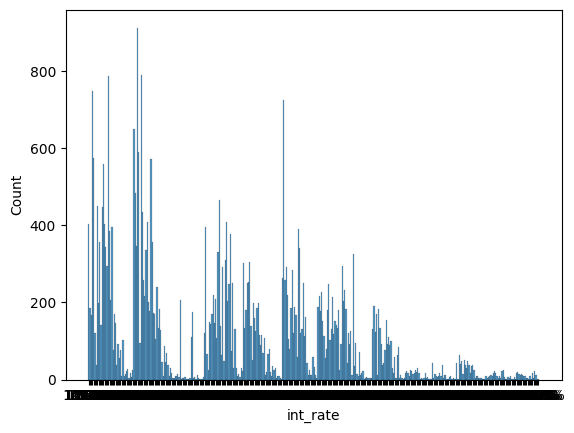


 Creating Histogram for: installment


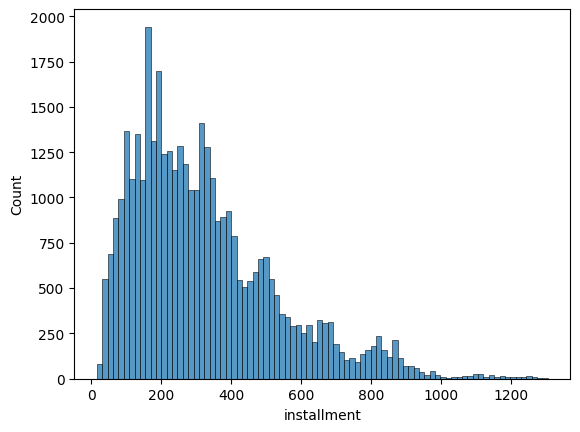


 Creating Histogram for: annual_inc


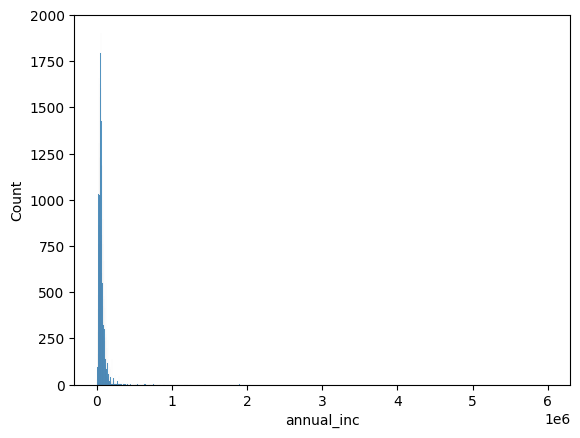


 Creating Histogram for: dti


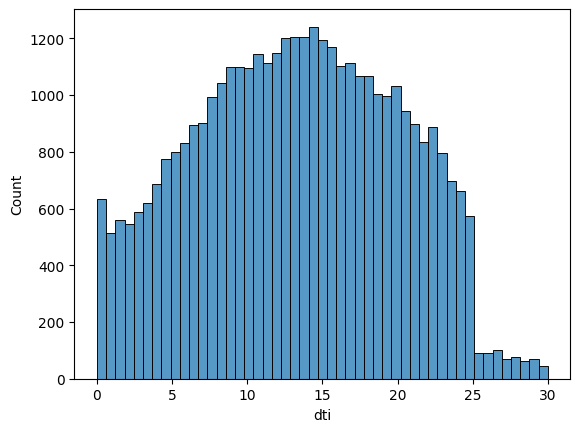


 Creating Histogram for: revol_bal


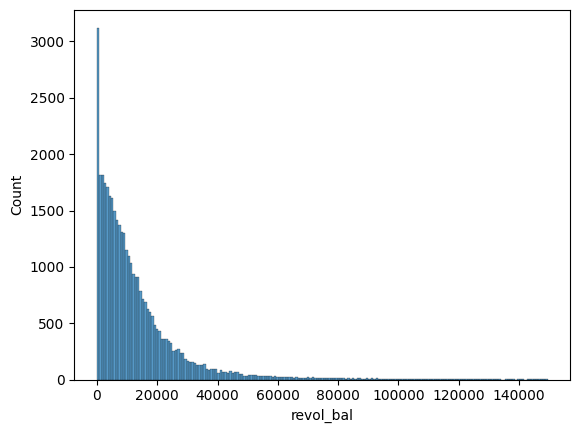


 Creating Histogram for: revol_util


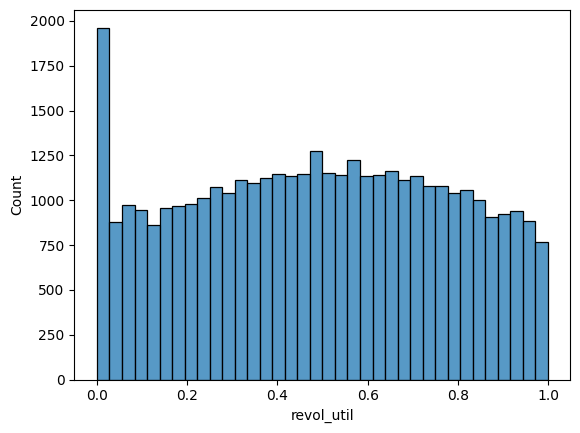


 Creating Histogram for: total_pymnt


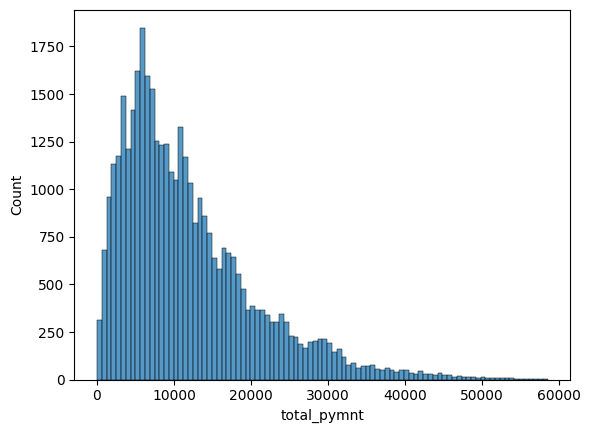


 Creating Histogram for: total_pymnt_inv


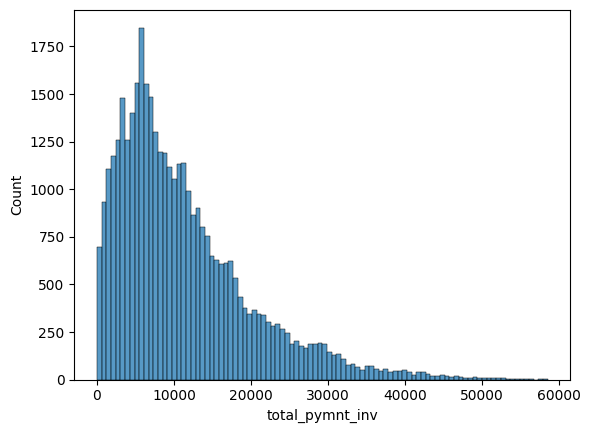


 Creating Histogram for: total_rec_prncp


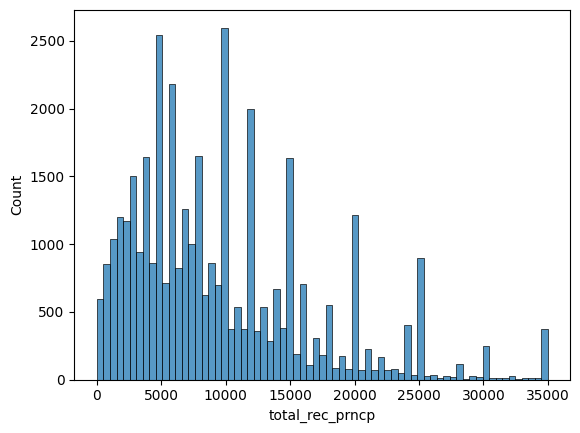


 Creating Histogram for: total_rec_int


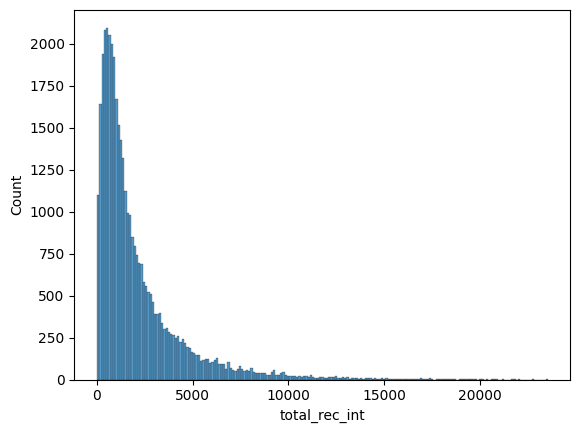


 Creating Histogram for: total_rec_late_fee


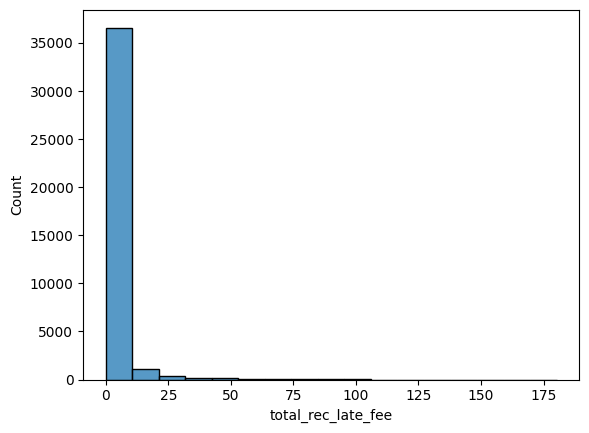


 Creating Histogram for: recoveries


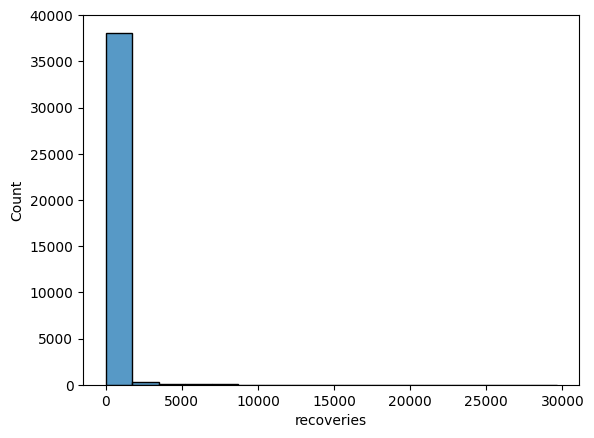


 Creating Histogram for: collection_recovery_fee


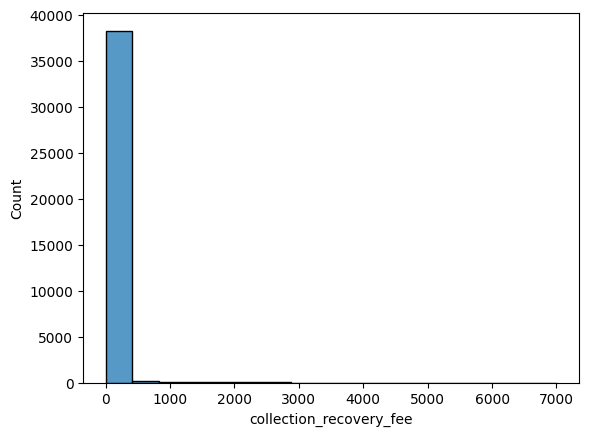


 Creating Histogram for: last_pymnt_amnt


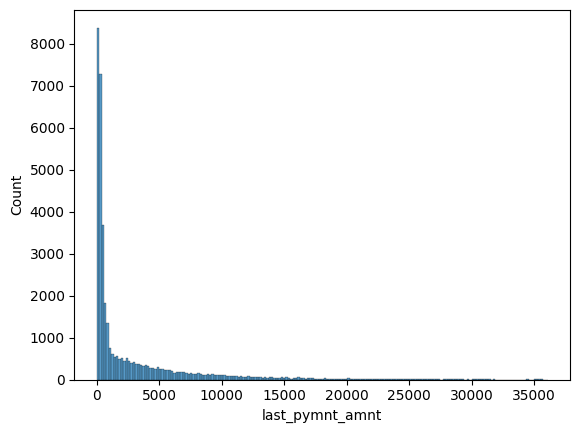

In [15]:
#Univariate Analysis for Numerical Columns

for num in num_cols:
  print('\n Creating Histogram for:', num)
  sns.histplot(df[num])
  plt.show()



 Creating Boxplot for: loan_amnt


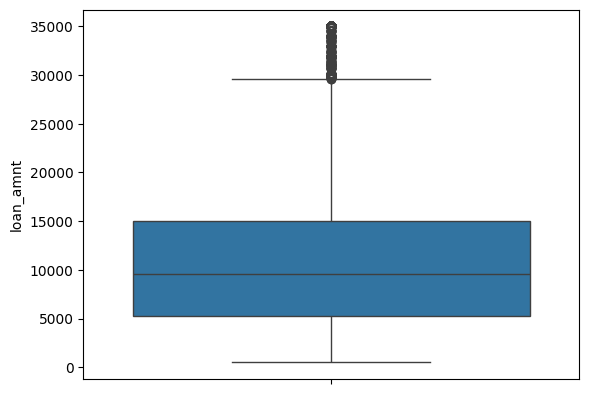


 Creating Boxplot for: funded_amnt


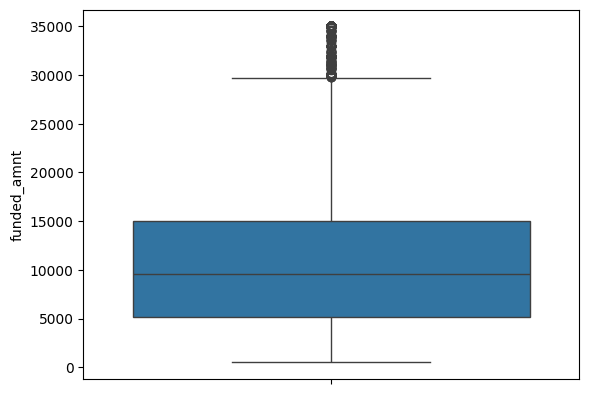


 Creating Boxplot for: funded_amnt_inv


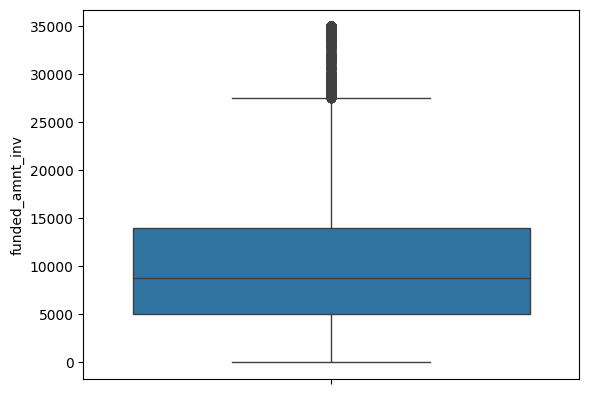


 Creating Boxplot for: int_rate


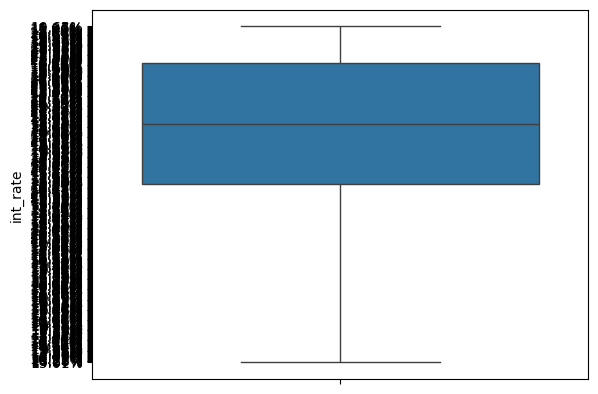


 Creating Boxplot for: installment


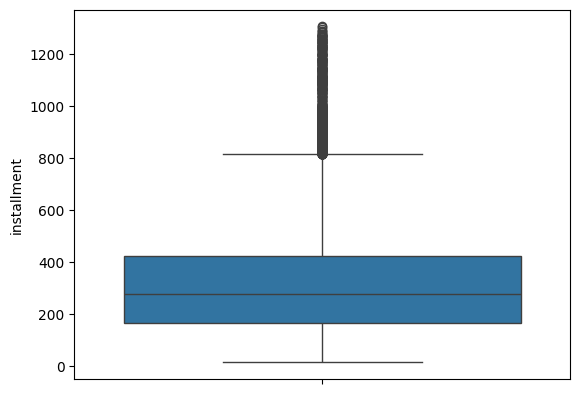


 Creating Boxplot for: annual_inc


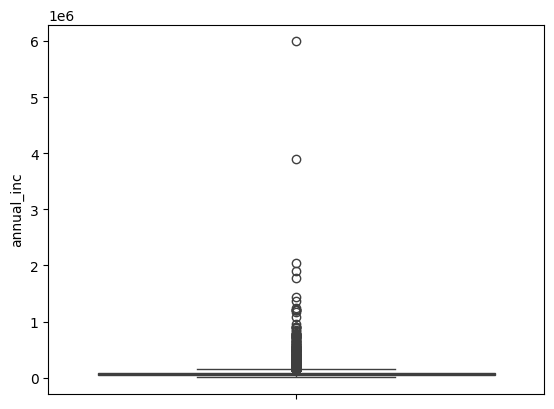


 Creating Boxplot for: dti


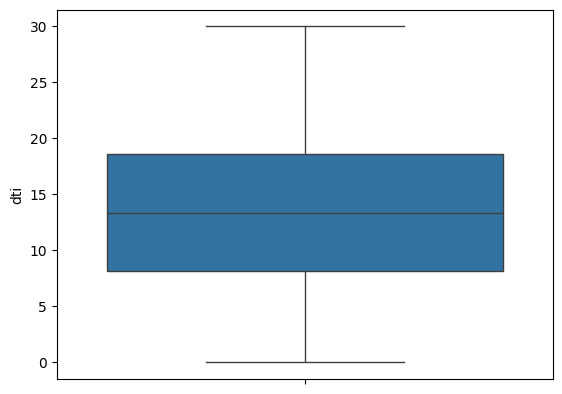


 Creating Boxplot for: revol_bal


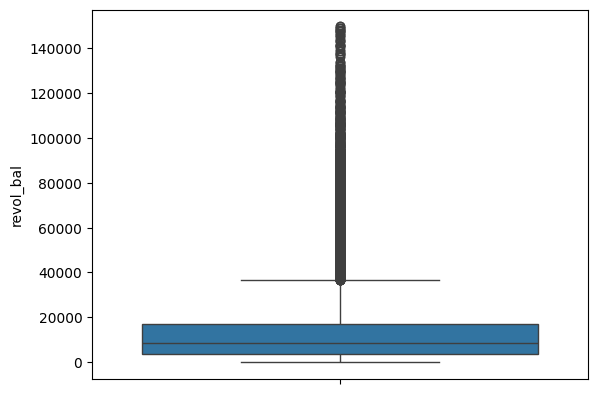


 Creating Boxplot for: revol_util


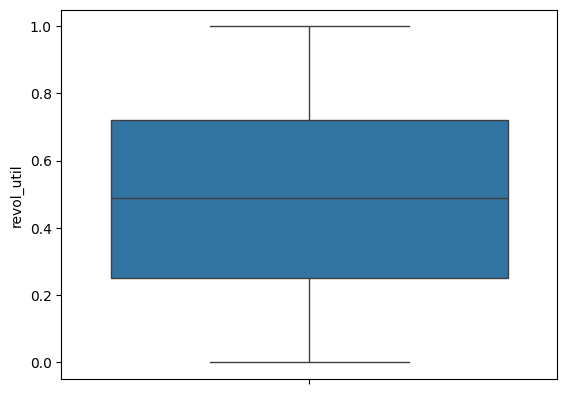


 Creating Boxplot for: total_pymnt


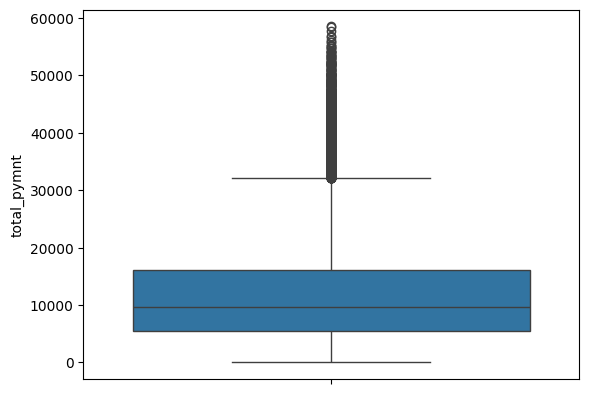


 Creating Boxplot for: total_pymnt_inv


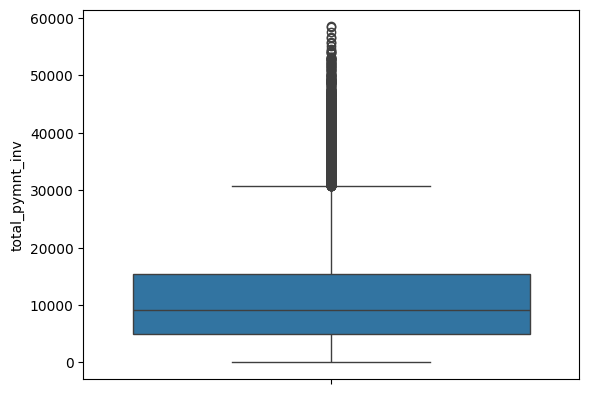


 Creating Boxplot for: total_rec_prncp


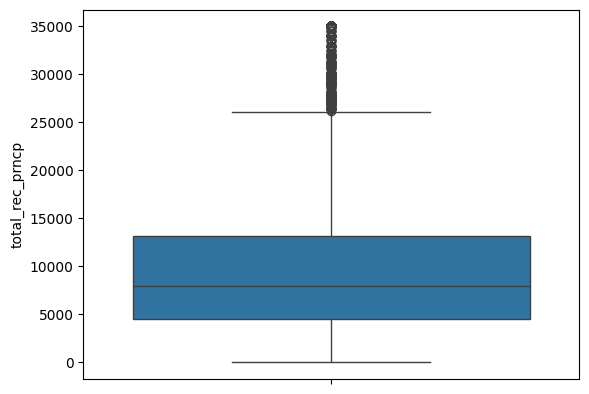


 Creating Boxplot for: total_rec_int


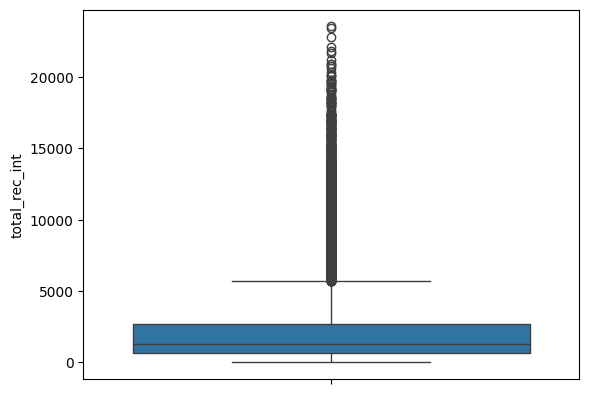


 Creating Boxplot for: total_rec_late_fee


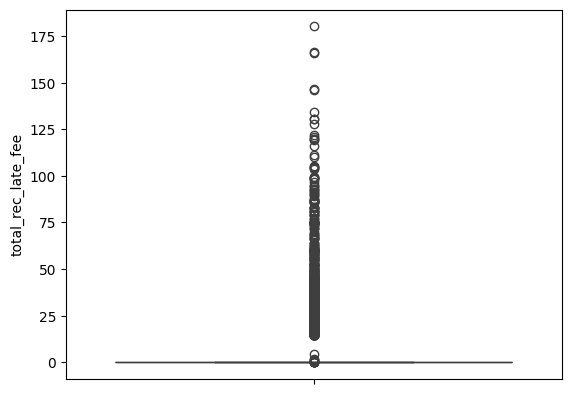


 Creating Boxplot for: recoveries


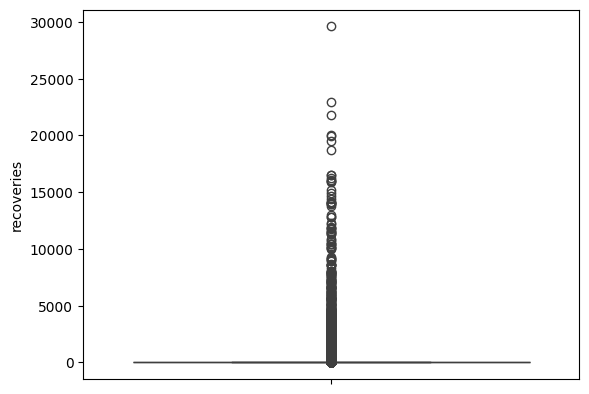


 Creating Boxplot for: collection_recovery_fee


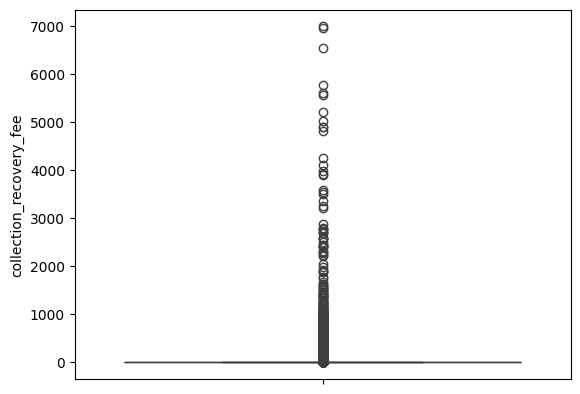


 Creating Boxplot for: last_pymnt_amnt


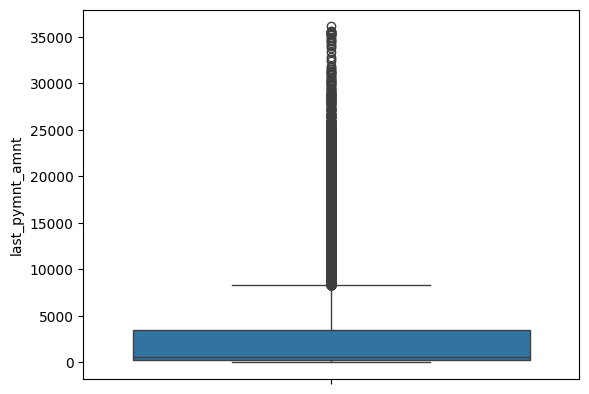

In [16]:
for num in num_cols:
  print('\n Creating Boxplot for:', num)
  sns.boxplot(df[num])
  plt.show()


 Creating Countplot for: term


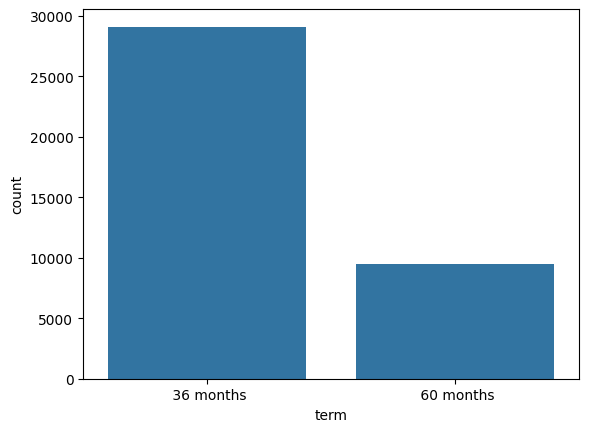


 Creating Countplot for: grade


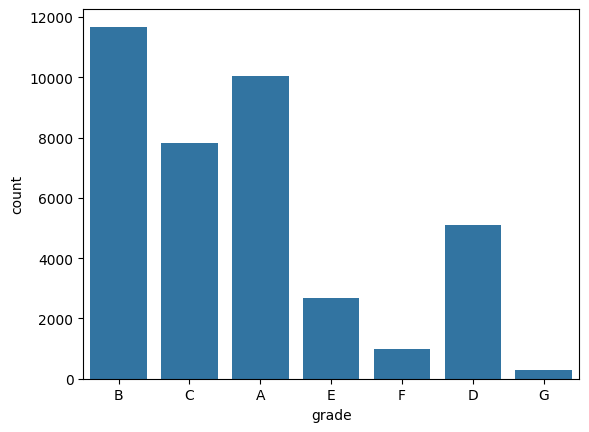


 Creating Countplot for: sub_grade


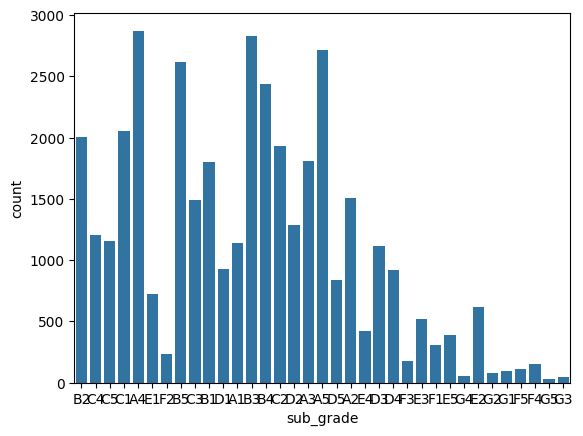


 Creating Countplot for: emp_length


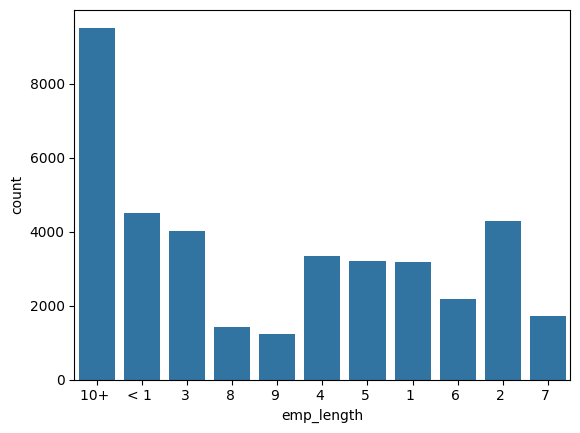


 Creating Countplot for: home_ownership


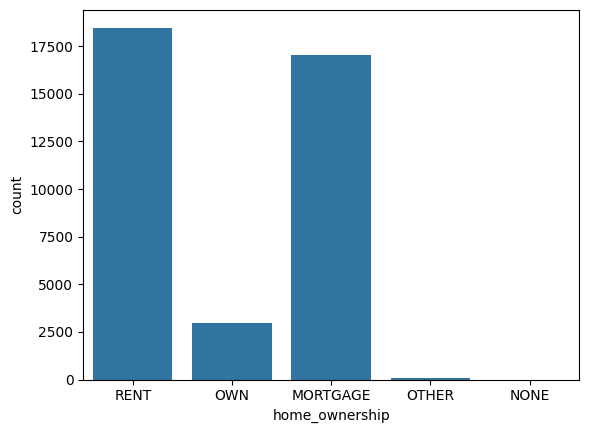


 Creating Countplot for: verification_status


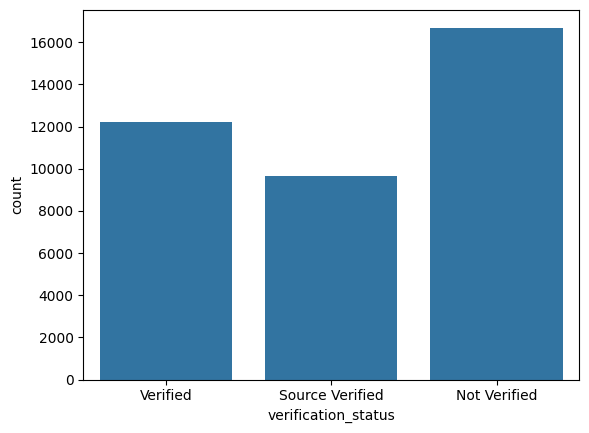


 Creating Countplot for: loan_status


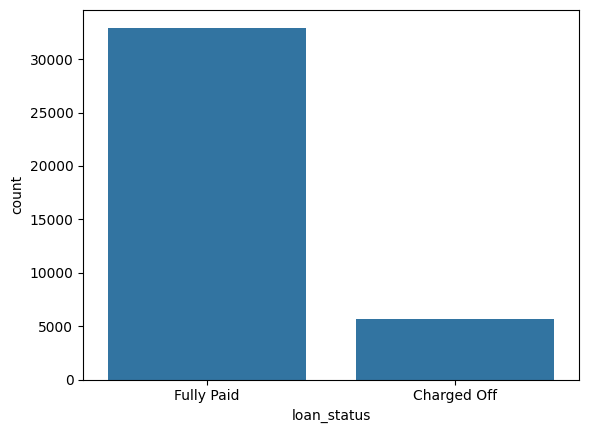


 Creating Countplot for: purpose


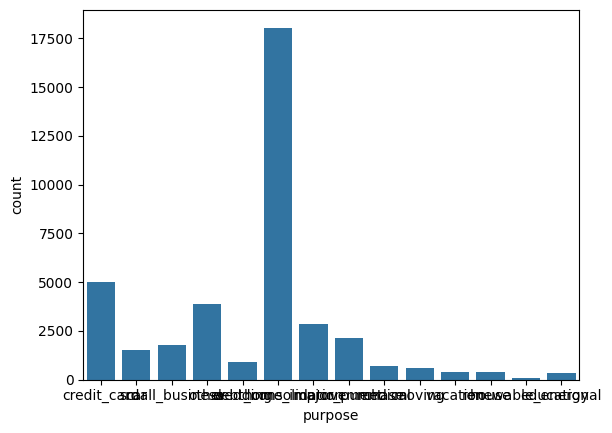


 Creating Countplot for: zip_code


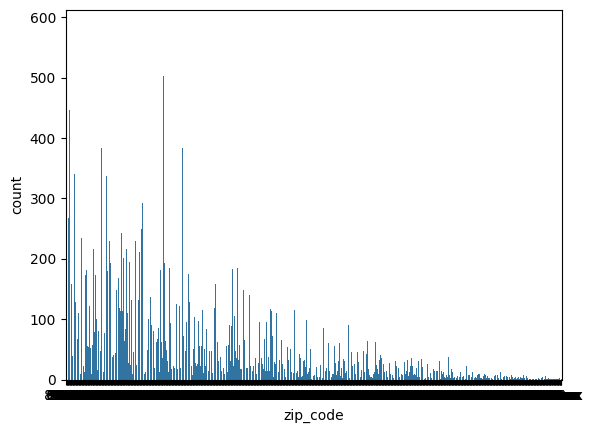


 Creating Countplot for: addr_state


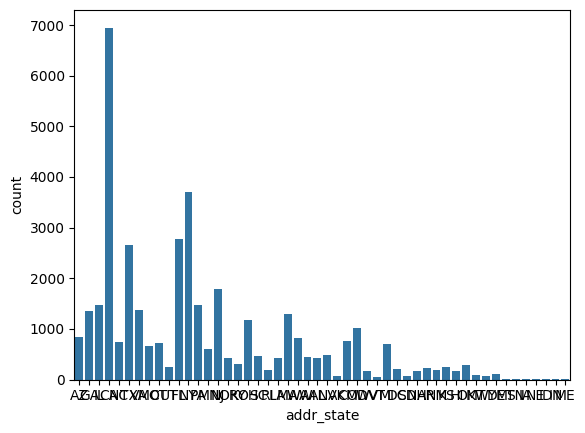


 Creating Countplot for: delinq_2yrs


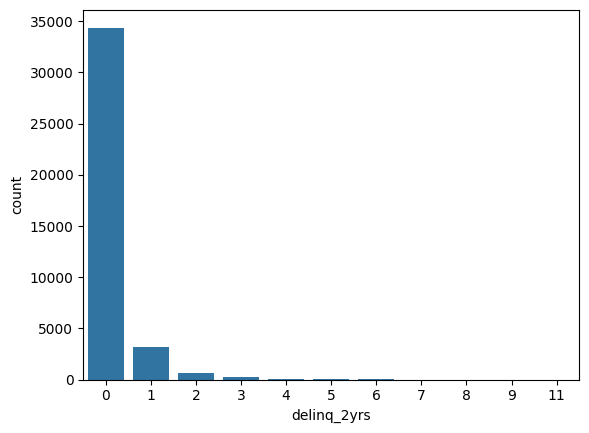


 Creating Countplot for: inq_last_6mths


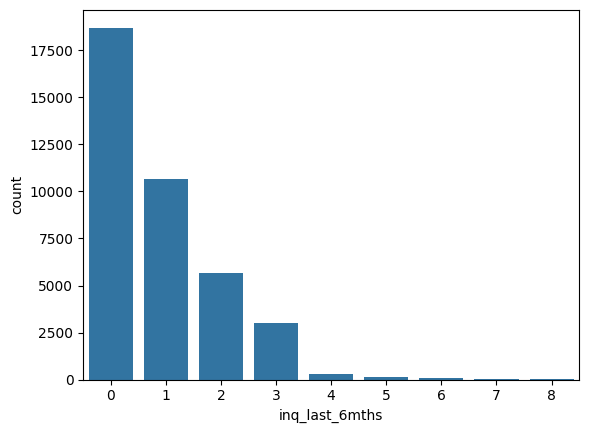


 Creating Countplot for: open_acc


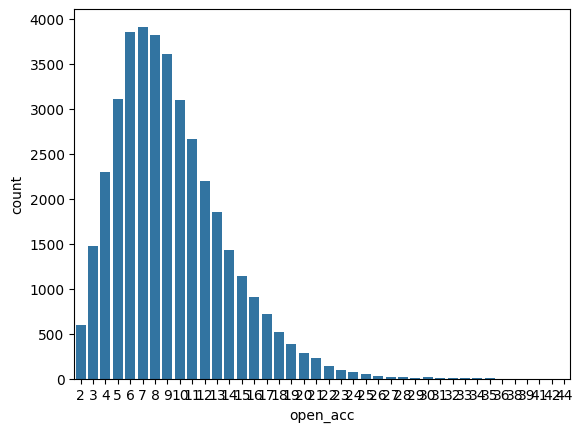


 Creating Countplot for: pub_rec


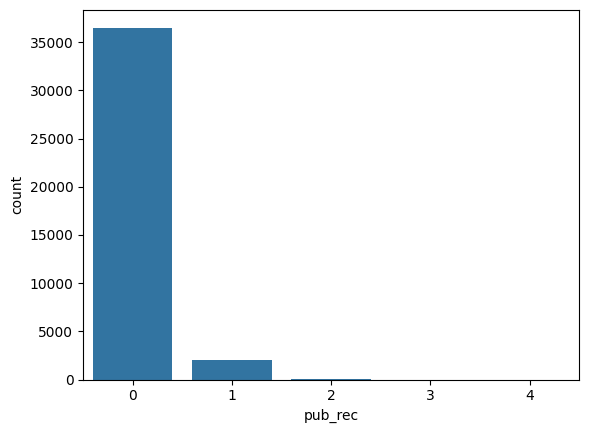


 Creating Countplot for: total_acc


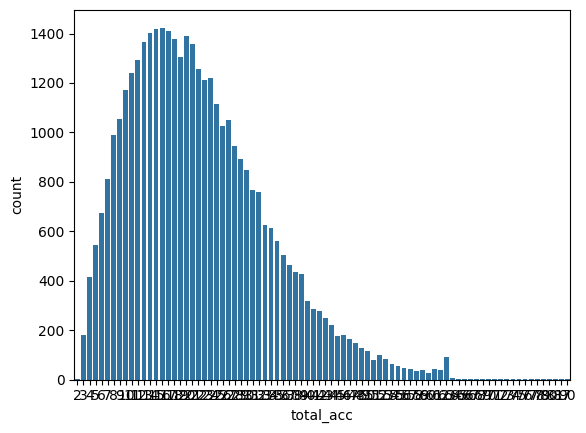


 Creating Countplot for: pub_rec_bankruptcies


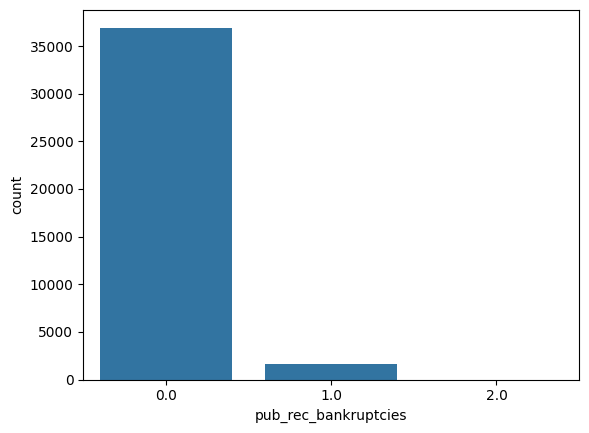

In [17]:
# Categorical Columns

for cat in cat_cols:
  print('\n Creating Countplot for:', cat)
  sns.countplot(x = df[cat])
  plt.show()

Creating Scatterplot for  loan_amnt vs loan_amnt


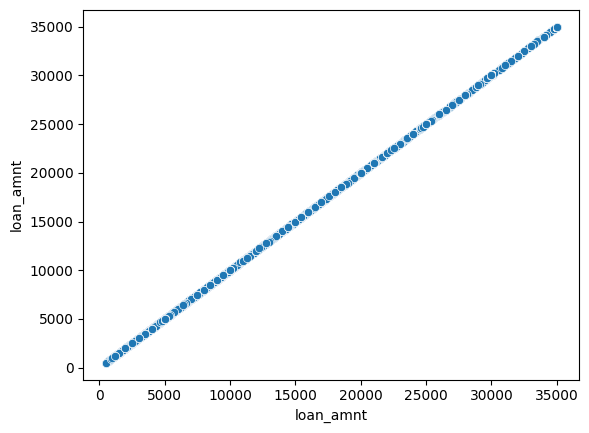

Creating Scatterplot for  loan_amnt vs funded_amnt


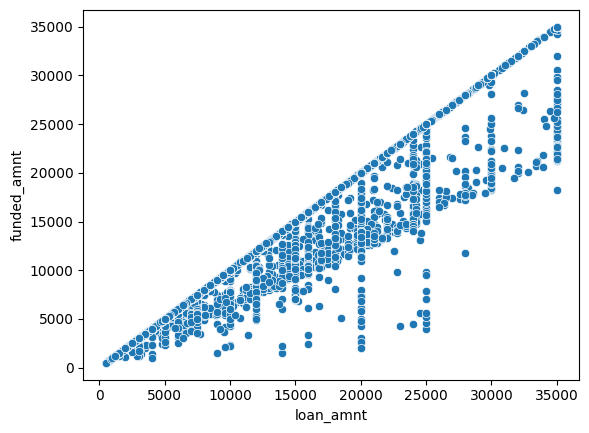

Creating Scatterplot for  loan_amnt vs funded_amnt_inv


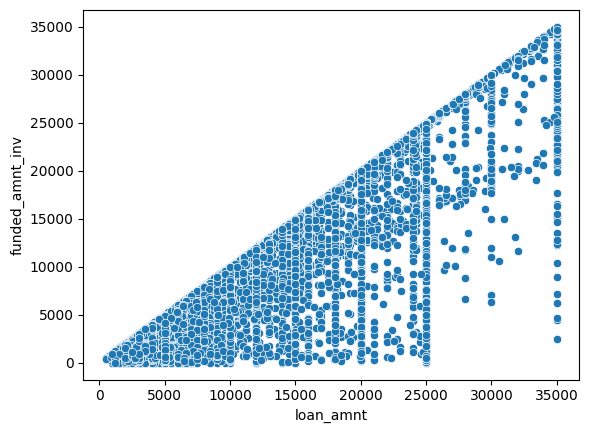

Creating Scatterplot for  loan_amnt vs int_rate


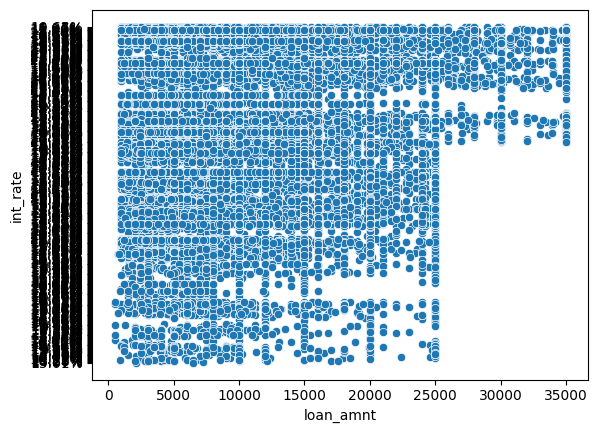

Creating Scatterplot for  loan_amnt vs installment


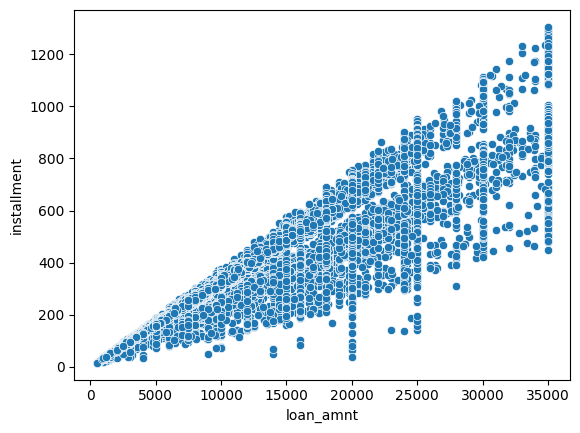

Creating Scatterplot for  loan_amnt vs annual_inc


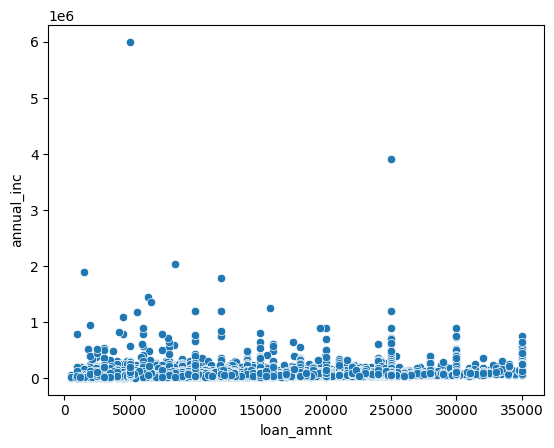

Creating Scatterplot for  loan_amnt vs dti


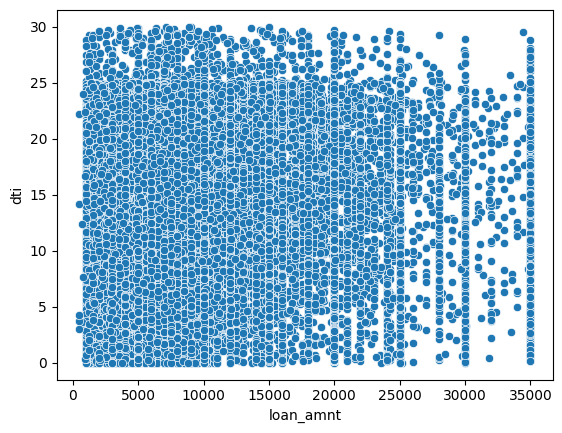

Creating Scatterplot for  loan_amnt vs revol_bal


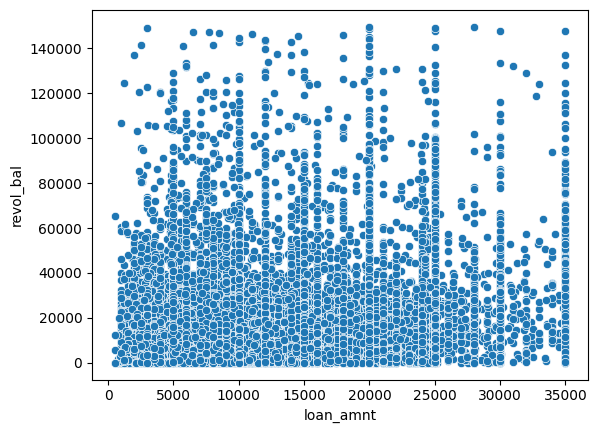

Creating Scatterplot for  loan_amnt vs revol_util


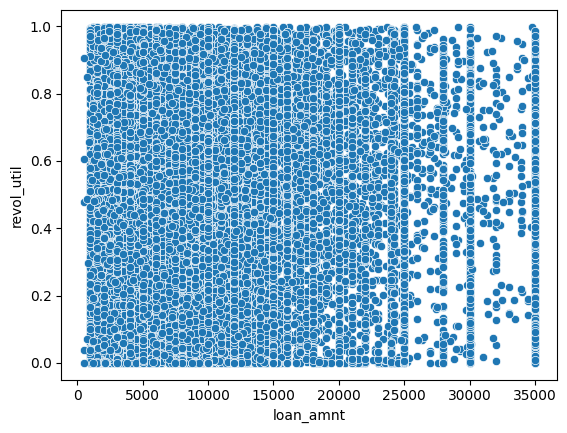

Creating Scatterplot for  loan_amnt vs total_pymnt


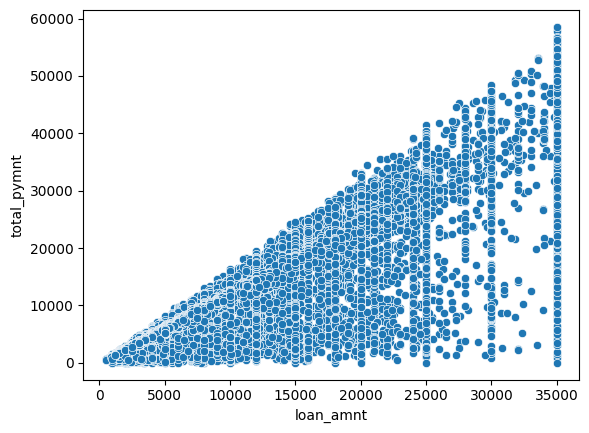

Creating Scatterplot for  loan_amnt vs total_pymnt_inv


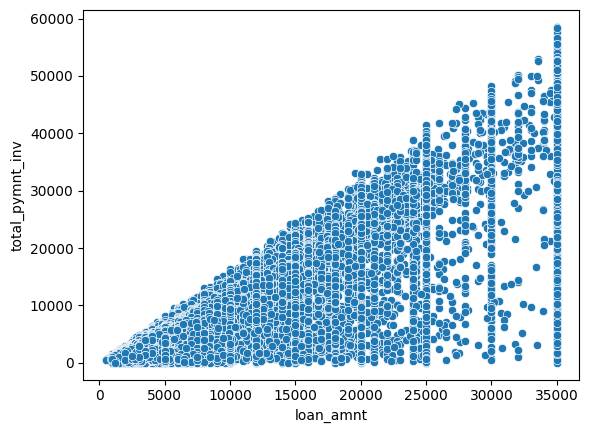

Creating Scatterplot for  loan_amnt vs total_rec_prncp


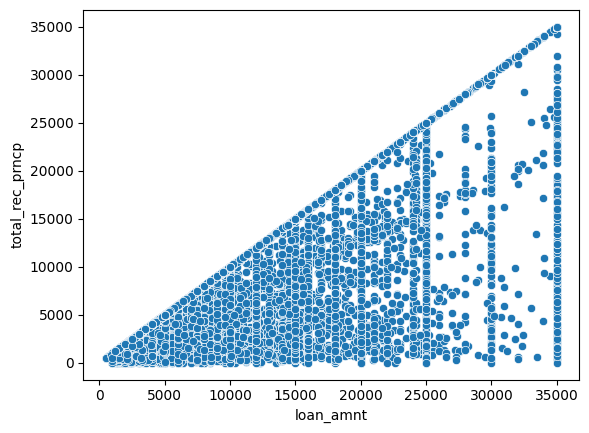

Creating Scatterplot for  loan_amnt vs total_rec_int


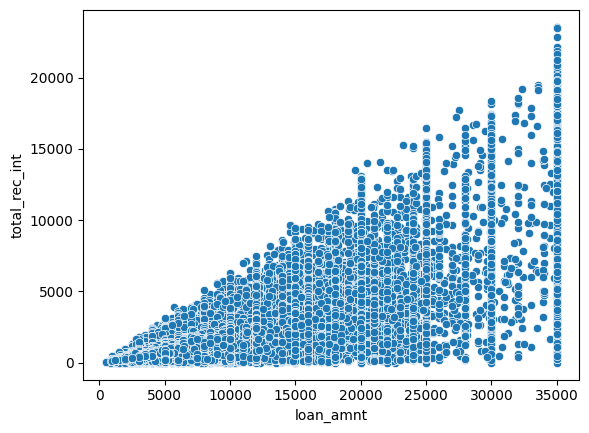

Creating Scatterplot for  loan_amnt vs total_rec_late_fee


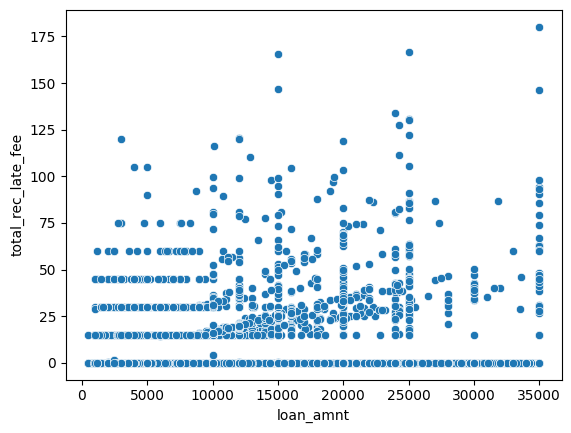

Creating Scatterplot for  loan_amnt vs recoveries


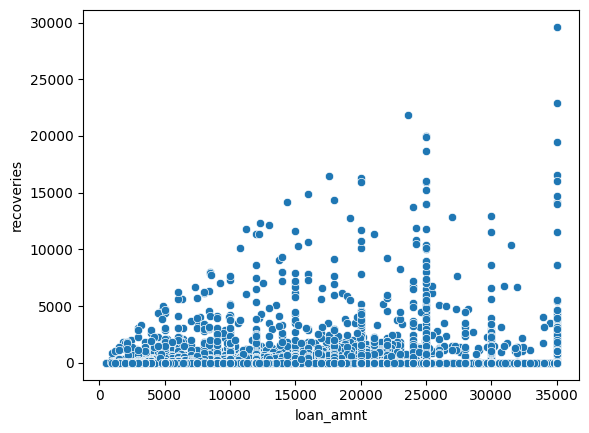

Creating Scatterplot for  loan_amnt vs collection_recovery_fee


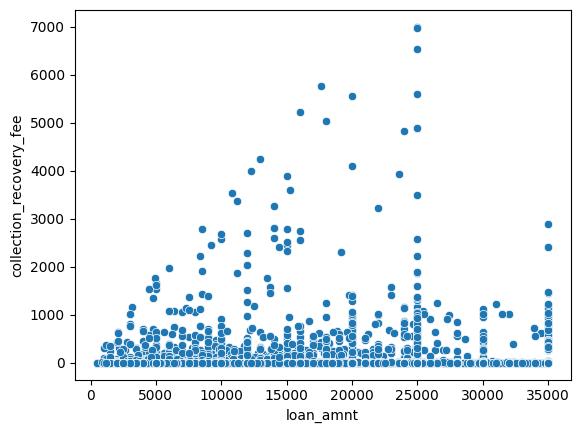

Creating Scatterplot for  loan_amnt vs last_pymnt_amnt


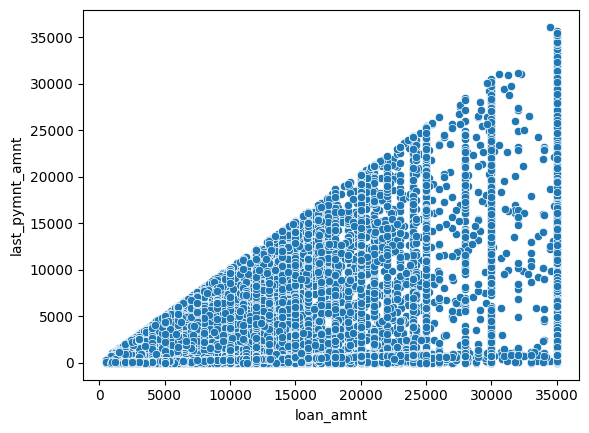

Creating Scatterplot for  funded_amnt vs loan_amnt


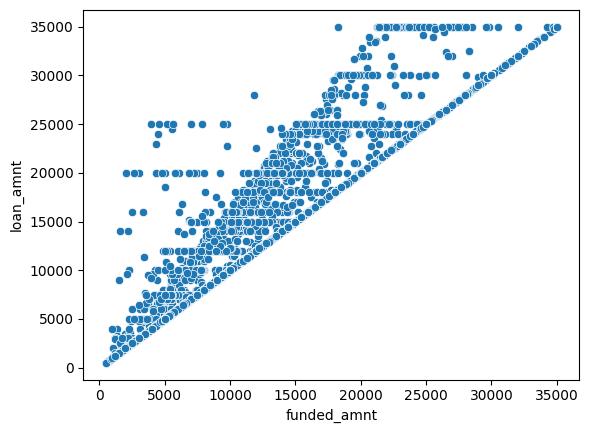

Creating Scatterplot for  funded_amnt vs funded_amnt


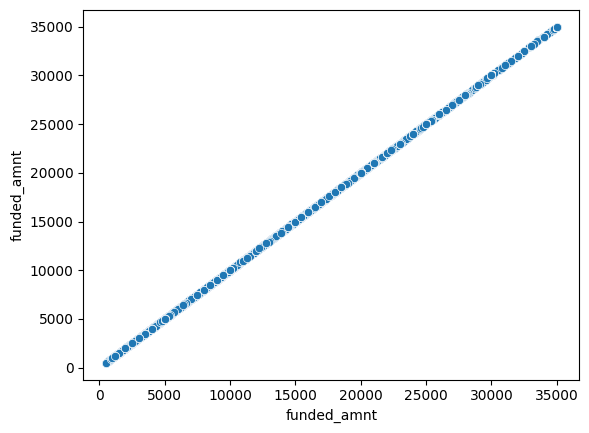

Creating Scatterplot for  funded_amnt vs funded_amnt_inv


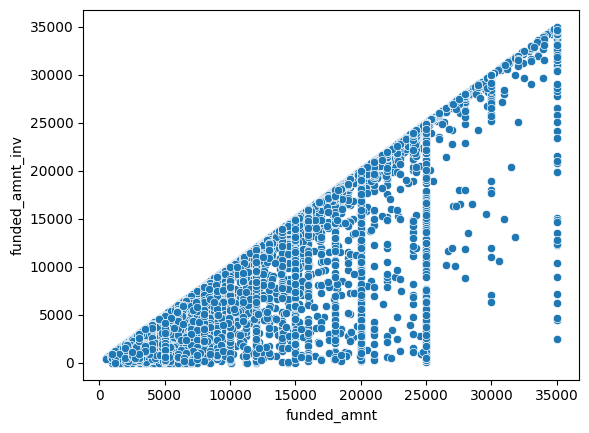

Creating Scatterplot for  funded_amnt vs int_rate


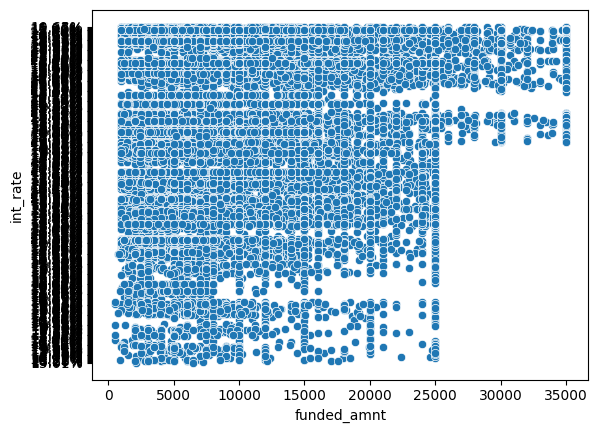

Creating Scatterplot for  funded_amnt vs installment


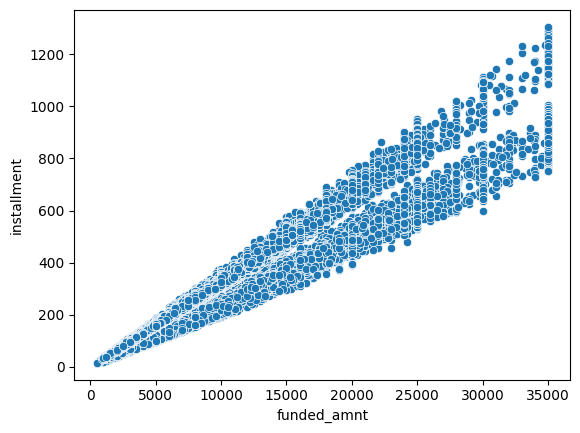

Creating Scatterplot for  funded_amnt vs annual_inc


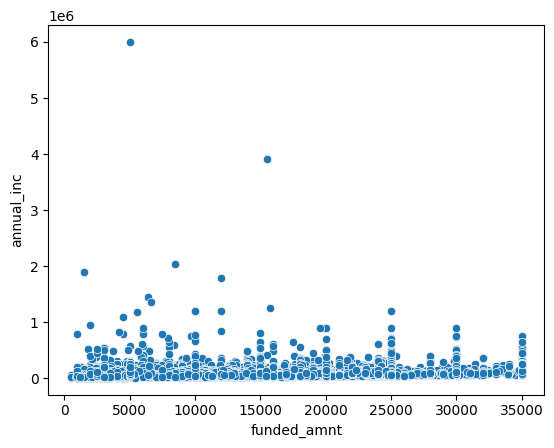

Creating Scatterplot for  funded_amnt vs dti


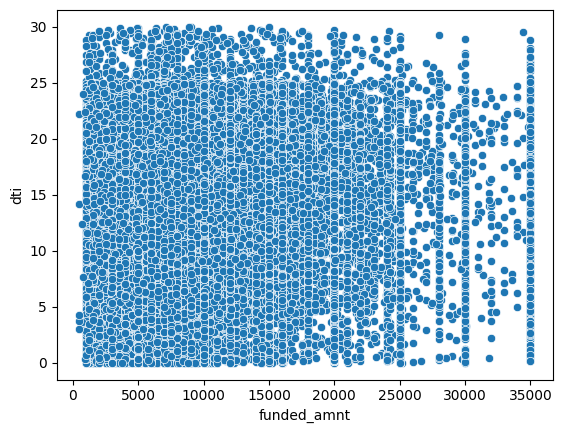

Creating Scatterplot for  funded_amnt vs revol_bal


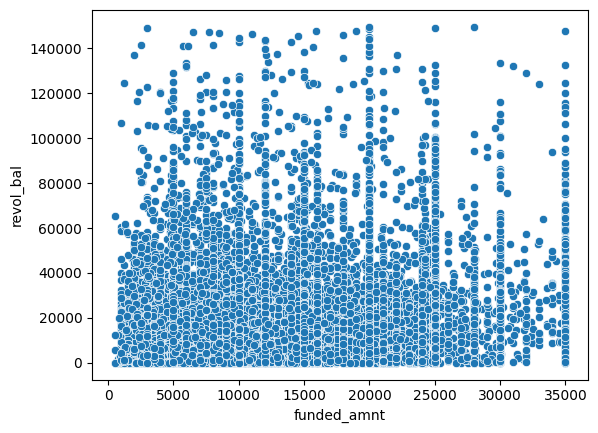

Creating Scatterplot for  funded_amnt vs revol_util


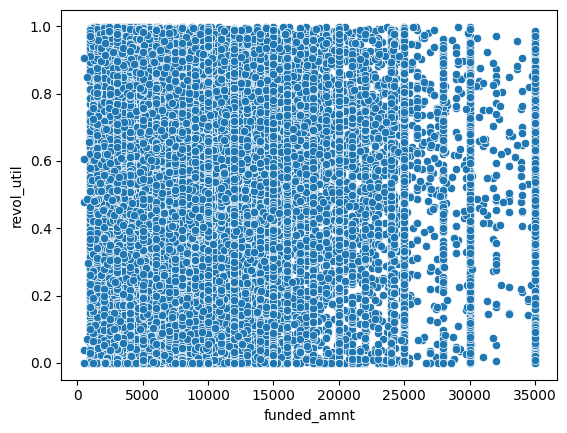

Creating Scatterplot for  funded_amnt vs total_pymnt


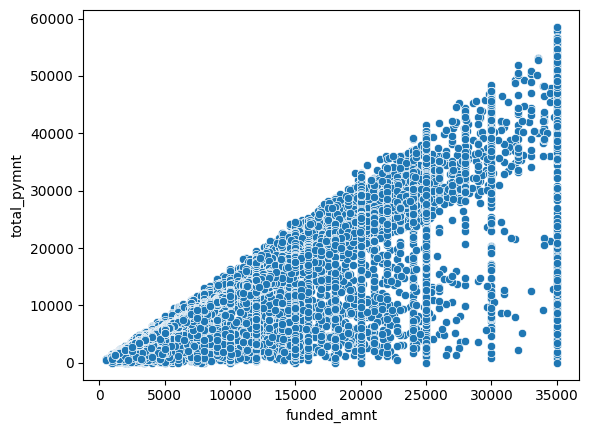

Creating Scatterplot for  funded_amnt vs total_pymnt_inv


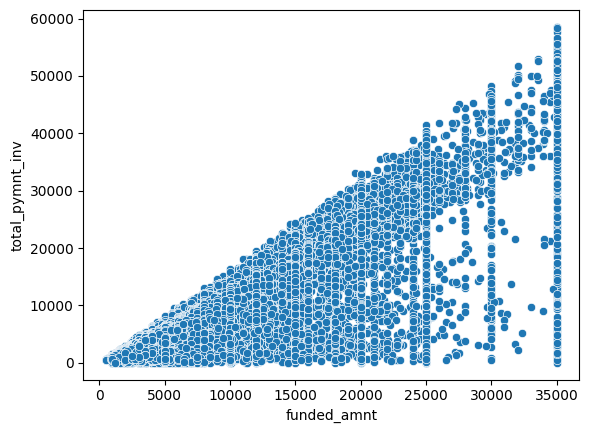

Creating Scatterplot for  funded_amnt vs total_rec_prncp


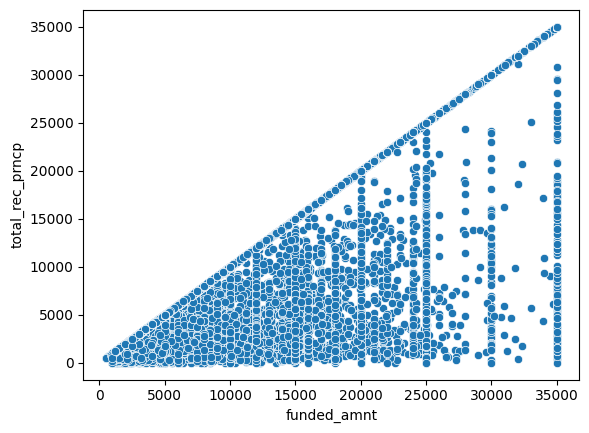

Creating Scatterplot for  funded_amnt vs total_rec_int


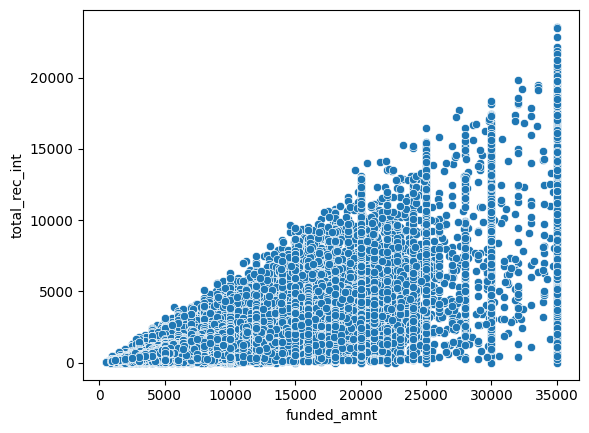

Creating Scatterplot for  funded_amnt vs total_rec_late_fee


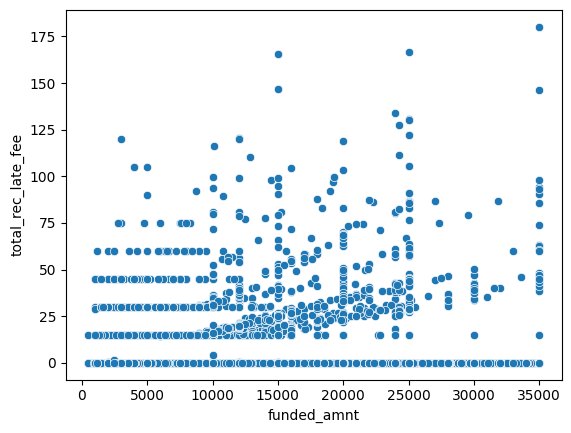

Creating Scatterplot for  funded_amnt vs recoveries


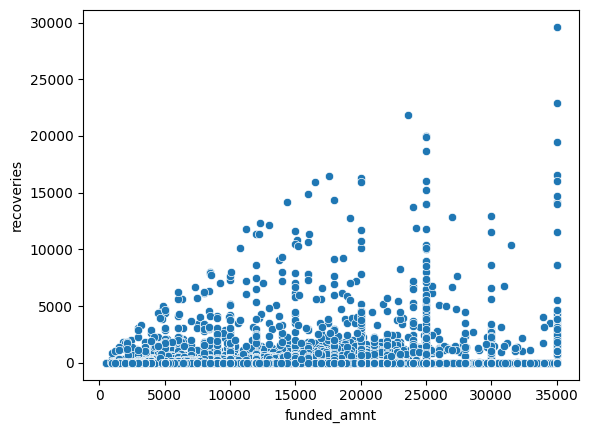

Creating Scatterplot for  funded_amnt vs collection_recovery_fee


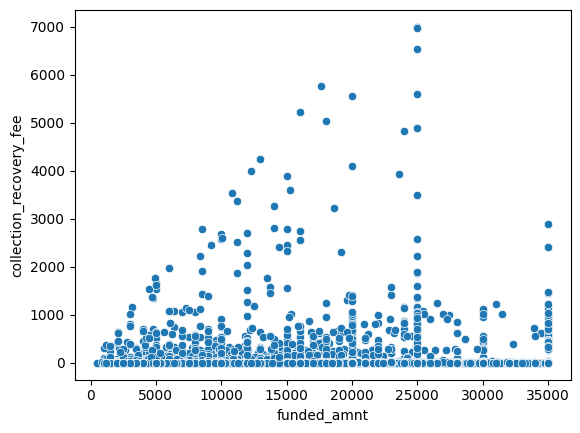

Creating Scatterplot for  funded_amnt vs last_pymnt_amnt


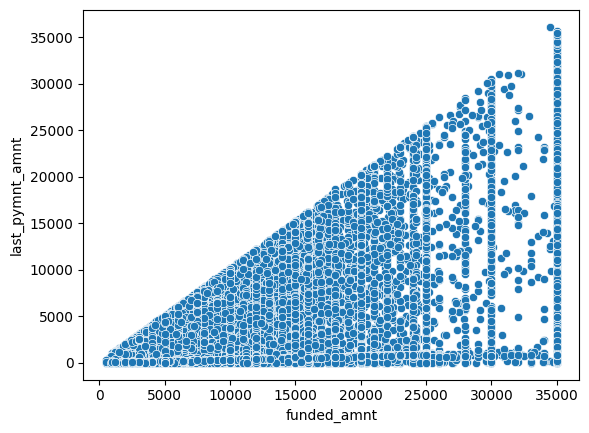

Creating Scatterplot for  funded_amnt_inv vs loan_amnt


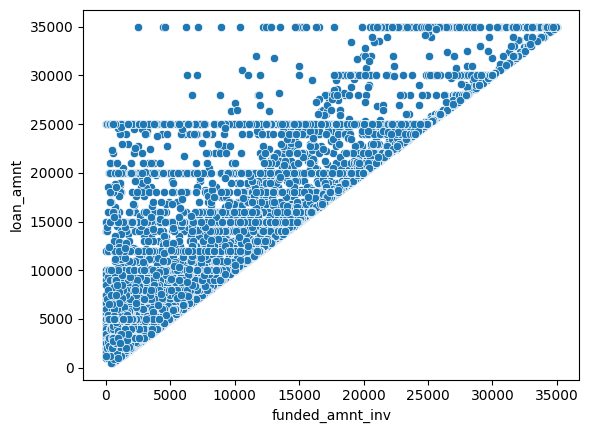

Creating Scatterplot for  funded_amnt_inv vs funded_amnt


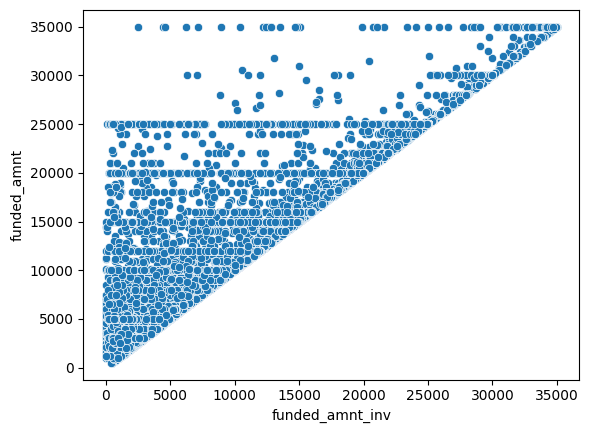

Creating Scatterplot for  funded_amnt_inv vs funded_amnt_inv


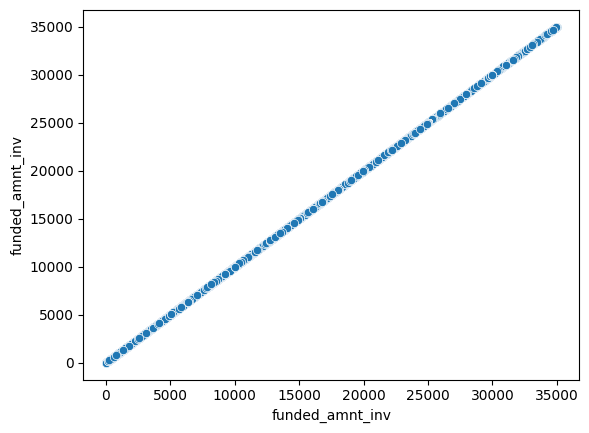

Creating Scatterplot for  funded_amnt_inv vs int_rate


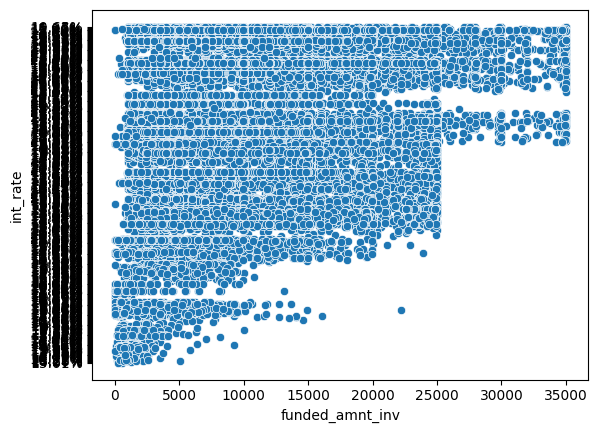

Creating Scatterplot for  funded_amnt_inv vs installment


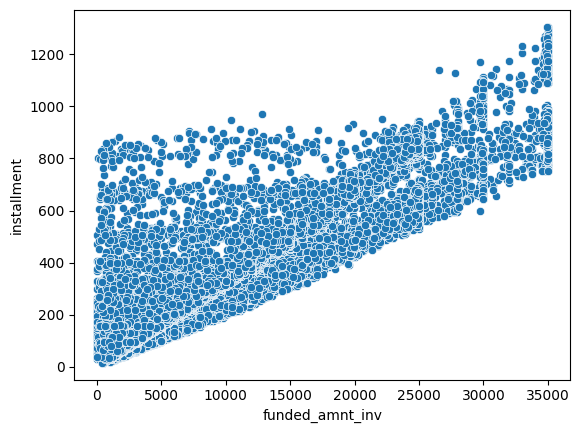

Creating Scatterplot for  funded_amnt_inv vs annual_inc


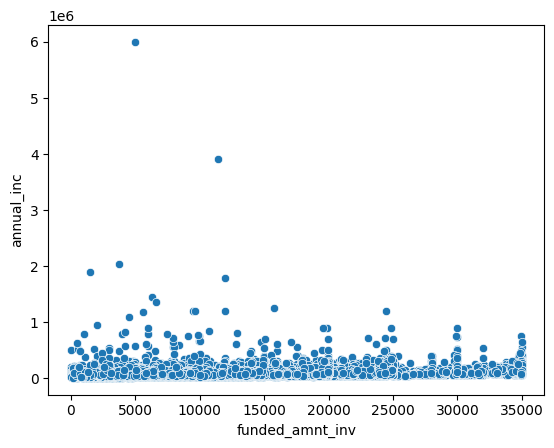

Creating Scatterplot for  funded_amnt_inv vs dti


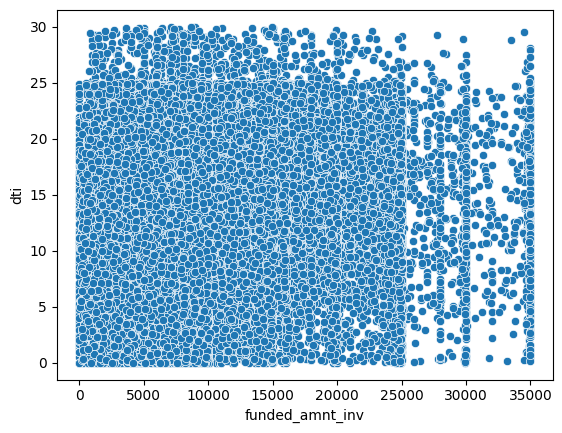

Creating Scatterplot for  funded_amnt_inv vs revol_bal


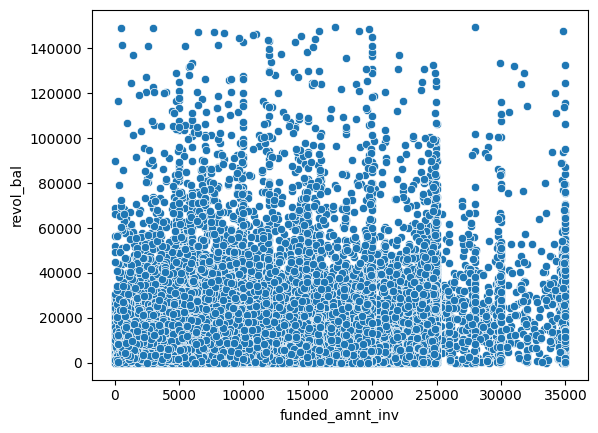

Creating Scatterplot for  funded_amnt_inv vs revol_util


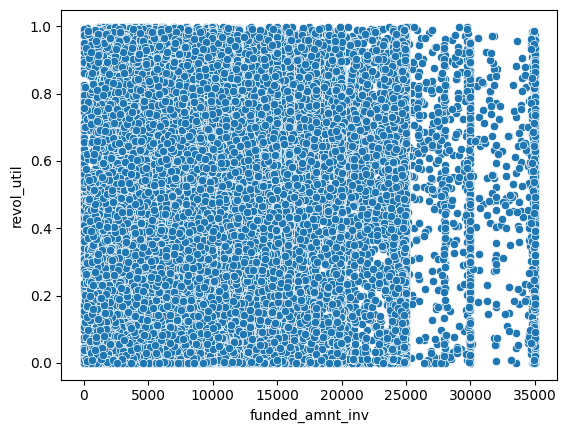

Creating Scatterplot for  funded_amnt_inv vs total_pymnt


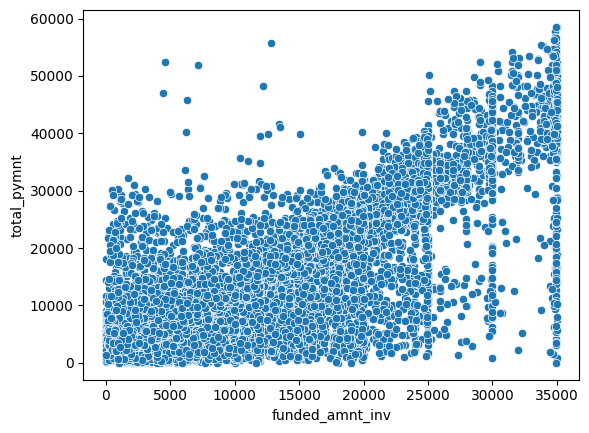

Creating Scatterplot for  funded_amnt_inv vs total_pymnt_inv


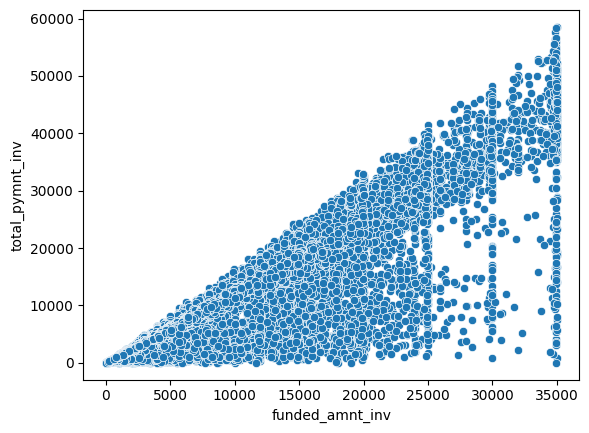

Creating Scatterplot for  funded_amnt_inv vs total_rec_prncp


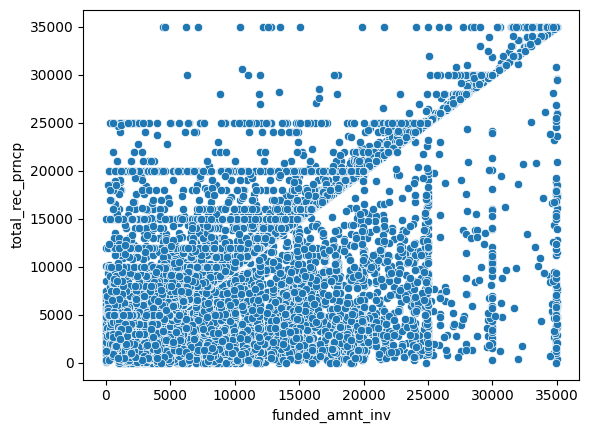

Creating Scatterplot for  funded_amnt_inv vs total_rec_int


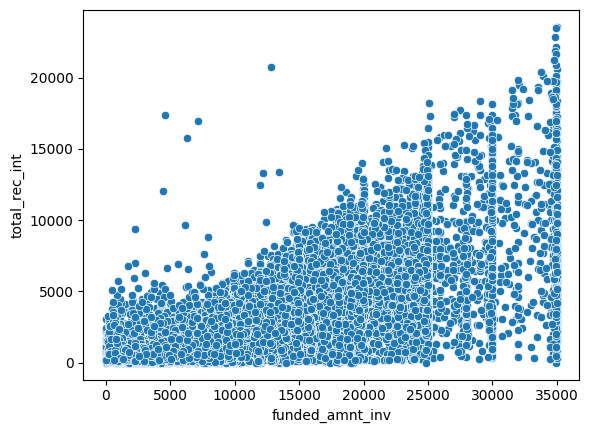

Creating Scatterplot for  funded_amnt_inv vs total_rec_late_fee


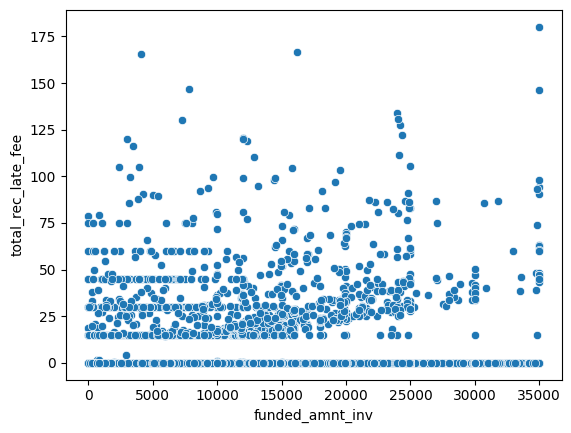

Creating Scatterplot for  funded_amnt_inv vs recoveries


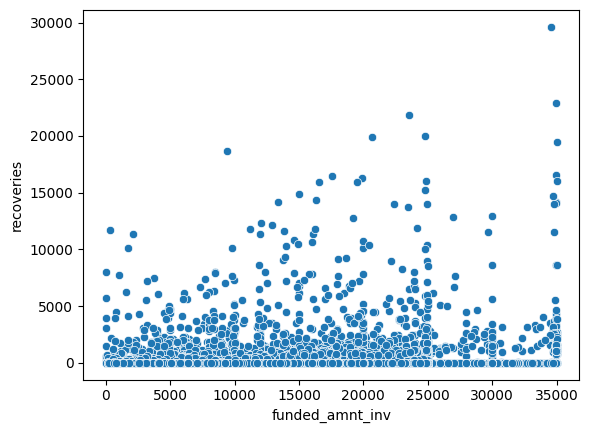

Creating Scatterplot for  funded_amnt_inv vs collection_recovery_fee


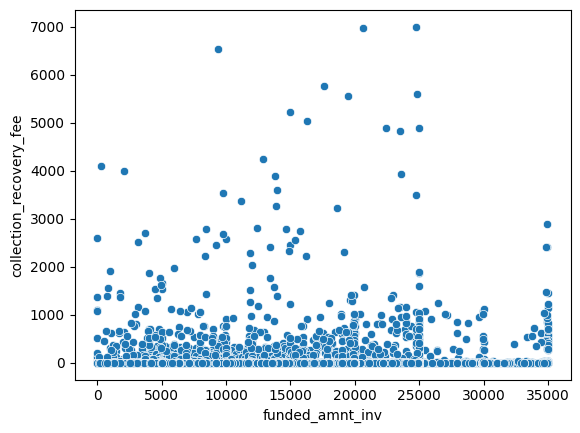

Creating Scatterplot for  funded_amnt_inv vs last_pymnt_amnt


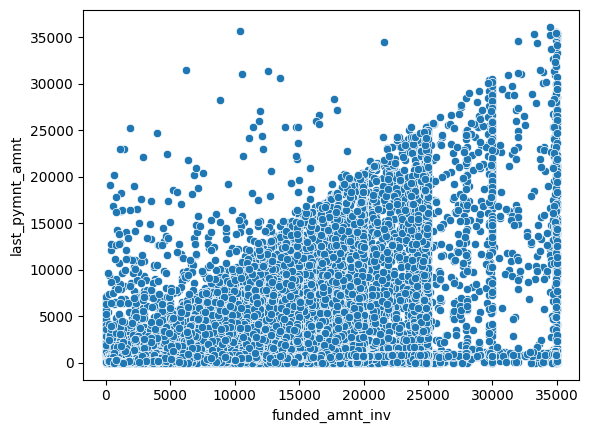

Creating Scatterplot for  int_rate vs loan_amnt


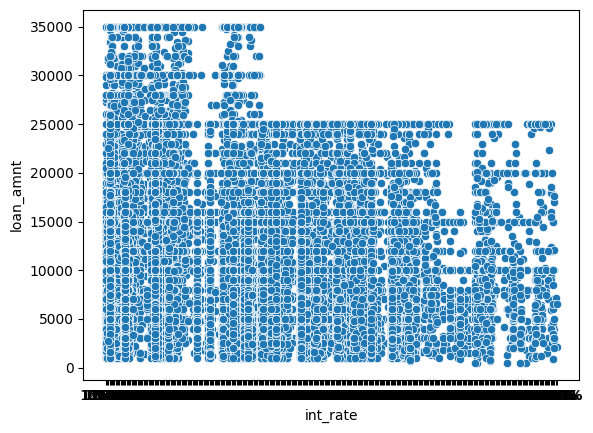

Creating Scatterplot for  int_rate vs funded_amnt


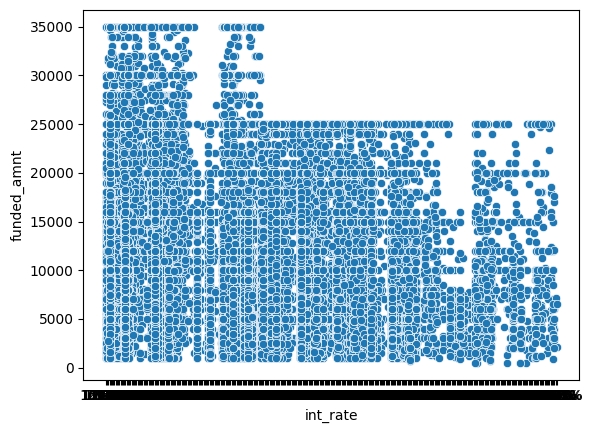

Creating Scatterplot for  int_rate vs funded_amnt_inv


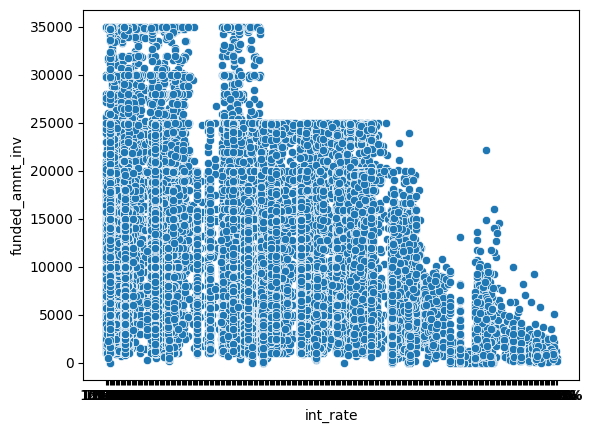

Creating Scatterplot for  int_rate vs int_rate


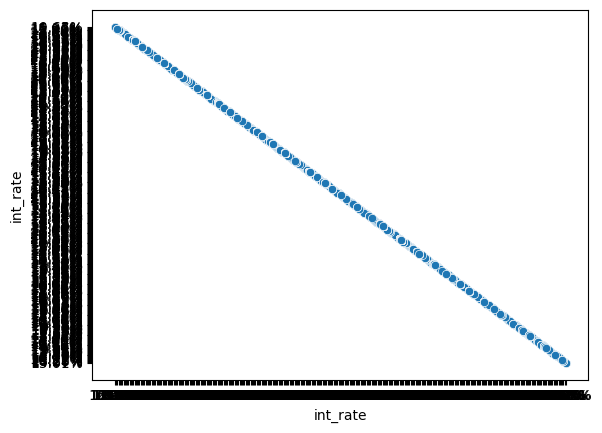

Creating Scatterplot for  int_rate vs installment


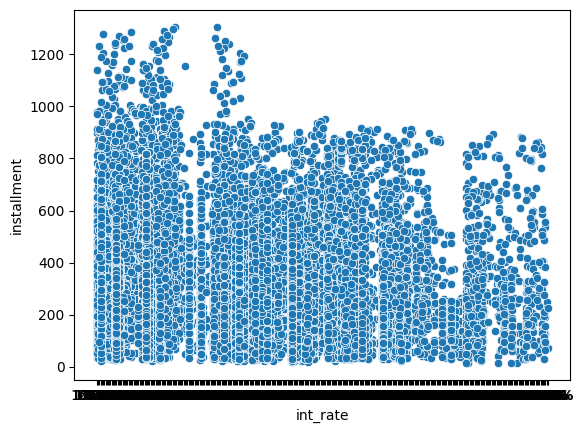

Creating Scatterplot for  int_rate vs annual_inc


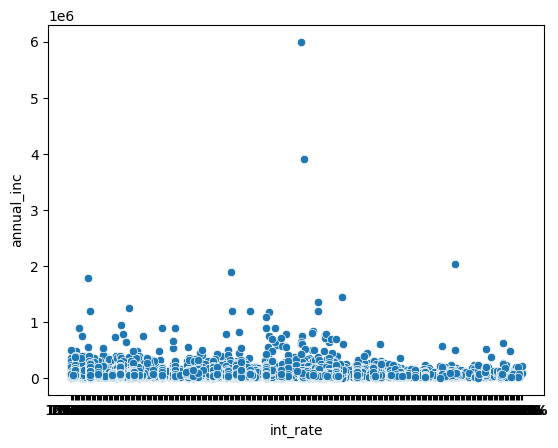

Creating Scatterplot for  int_rate vs dti


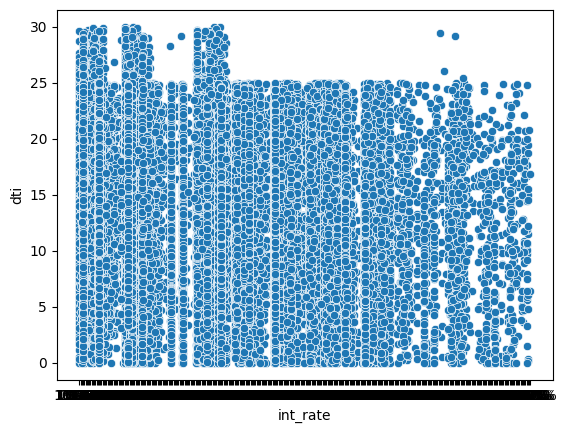

Creating Scatterplot for  int_rate vs revol_bal


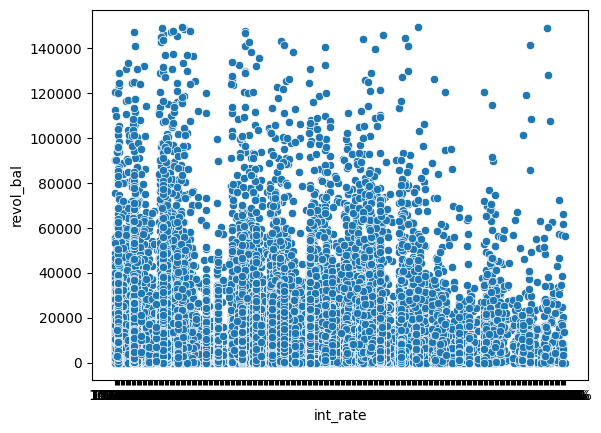

Creating Scatterplot for  int_rate vs revol_util


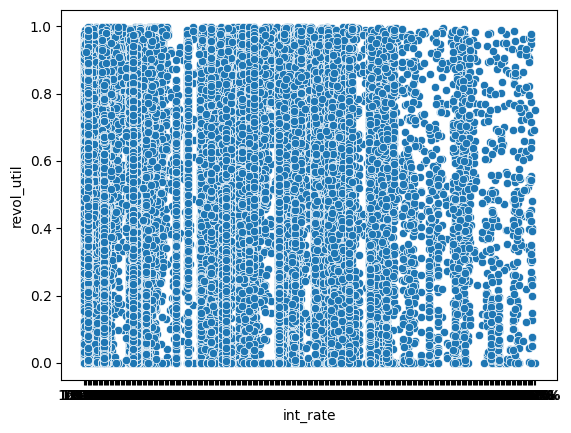

Creating Scatterplot for  int_rate vs total_pymnt


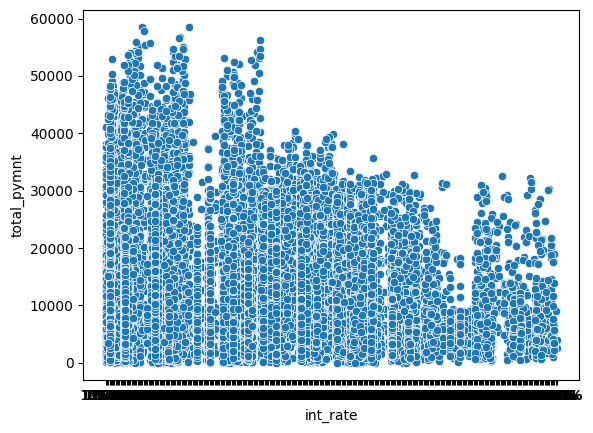

Creating Scatterplot for  int_rate vs total_pymnt_inv


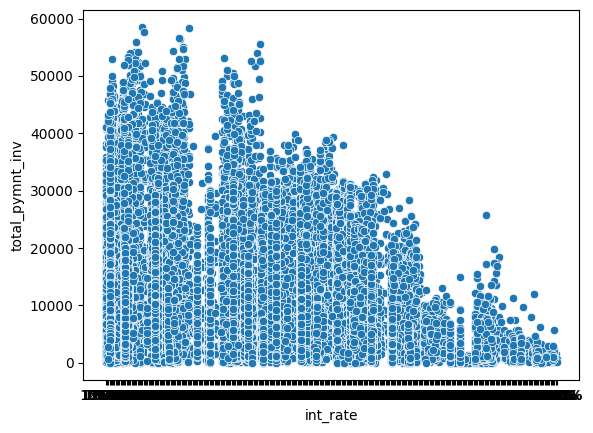

Creating Scatterplot for  int_rate vs total_rec_prncp


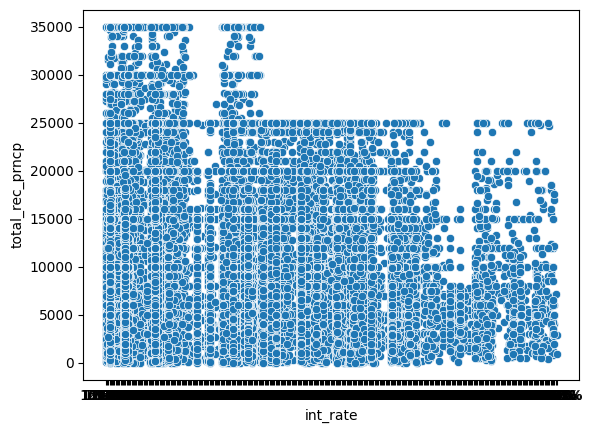

Creating Scatterplot for  int_rate vs total_rec_int


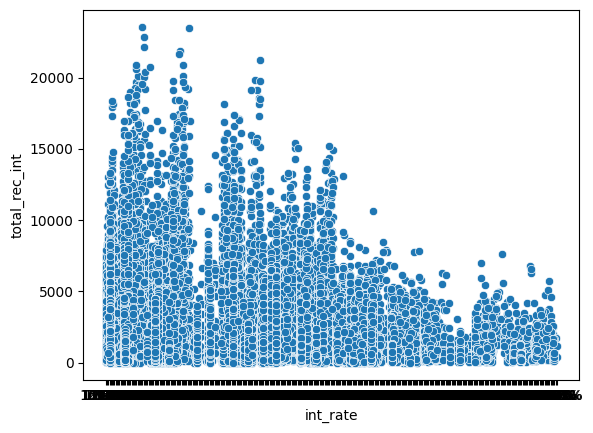

Creating Scatterplot for  int_rate vs total_rec_late_fee


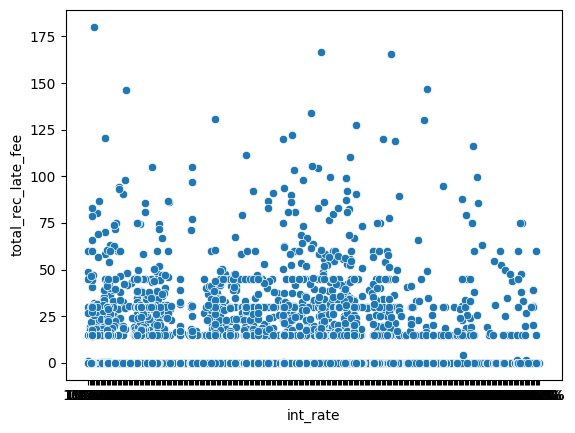

Creating Scatterplot for  int_rate vs recoveries


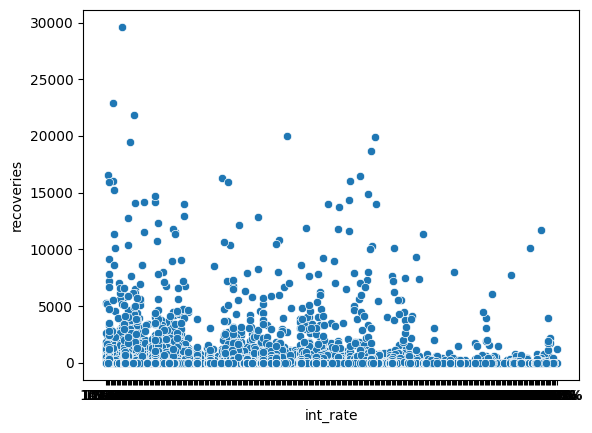

Creating Scatterplot for  int_rate vs collection_recovery_fee


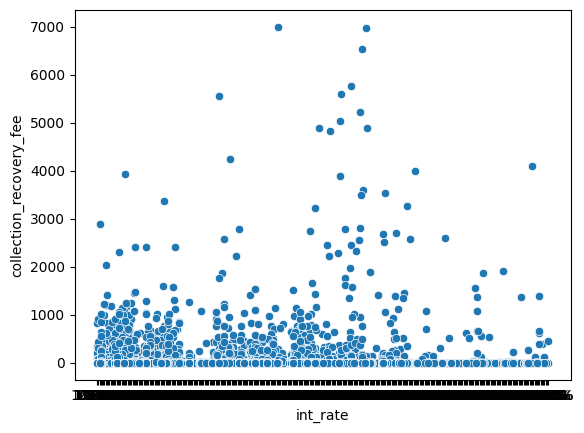

Creating Scatterplot for  int_rate vs last_pymnt_amnt


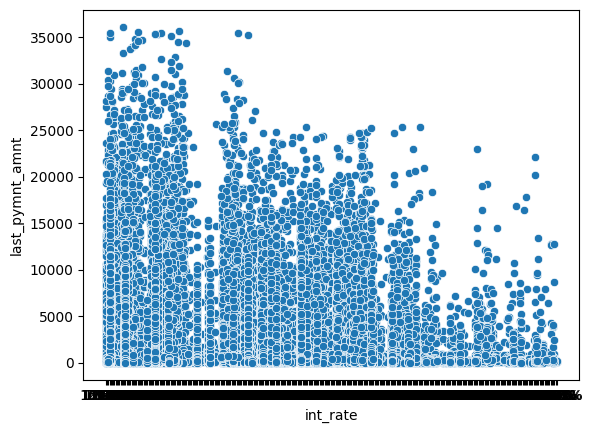

Creating Scatterplot for  installment vs loan_amnt


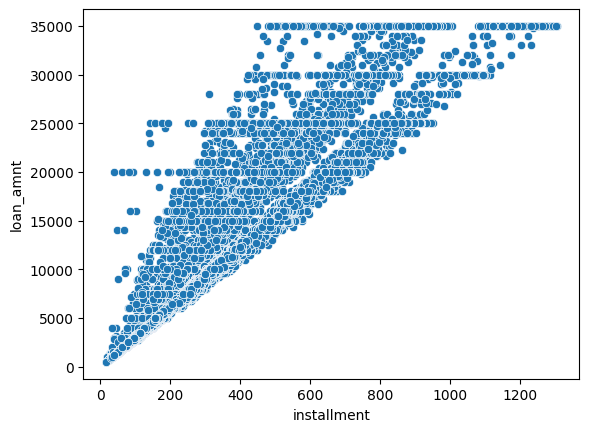

Creating Scatterplot for  installment vs funded_amnt


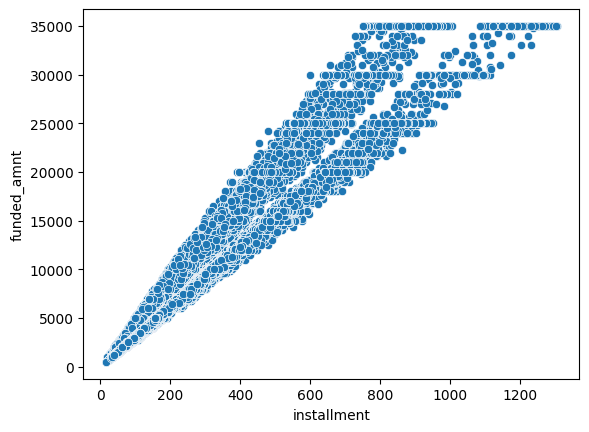

Creating Scatterplot for  installment vs funded_amnt_inv


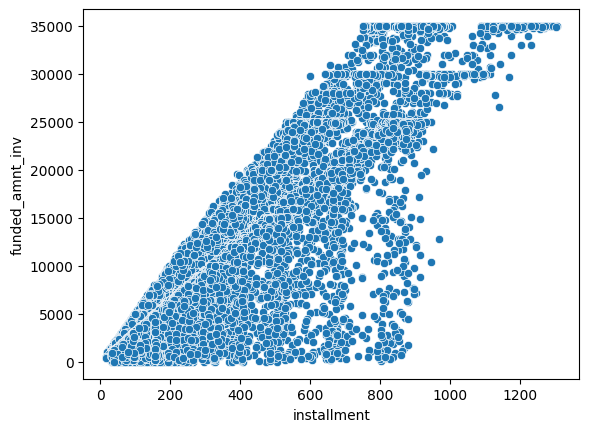

Creating Scatterplot for  installment vs int_rate


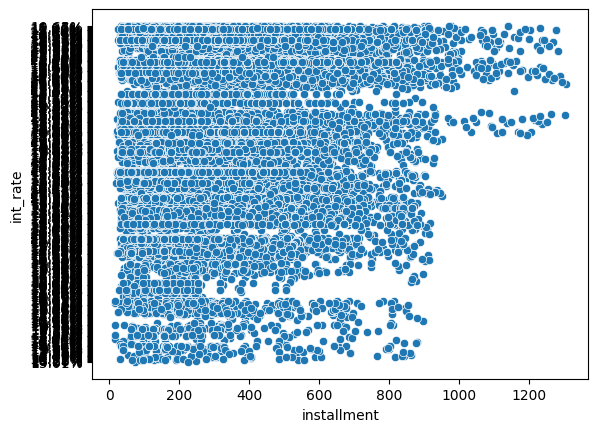

Creating Scatterplot for  installment vs installment


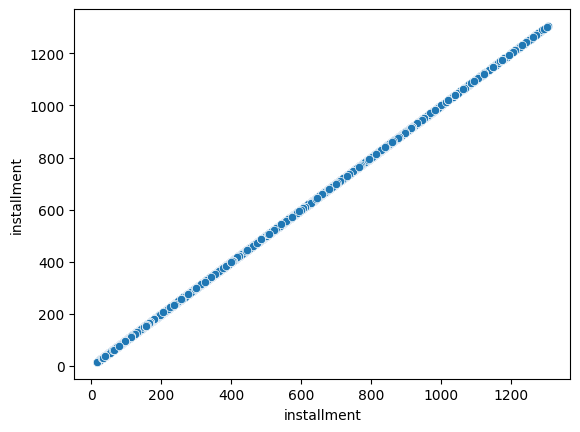

Creating Scatterplot for  installment vs annual_inc


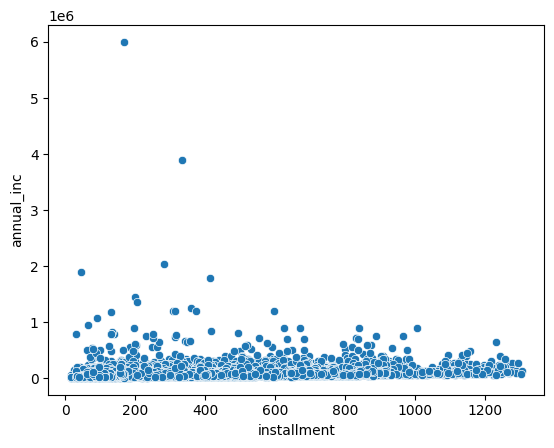

Creating Scatterplot for  installment vs dti


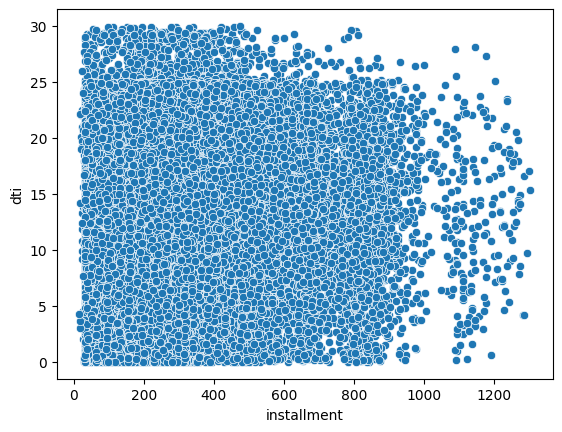

Creating Scatterplot for  installment vs revol_bal


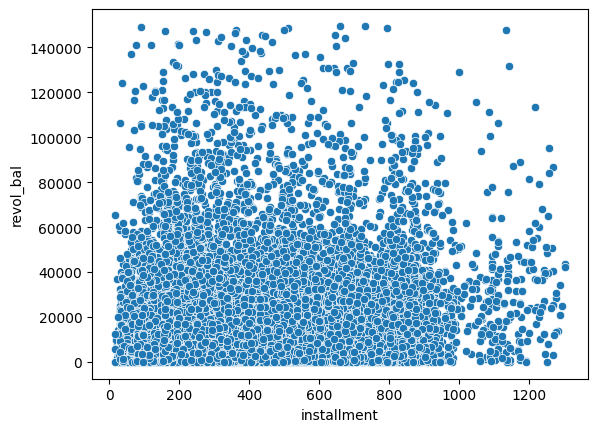

Creating Scatterplot for  installment vs revol_util


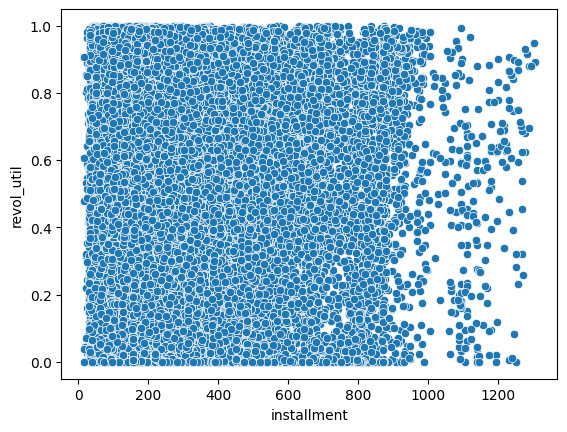

Creating Scatterplot for  installment vs total_pymnt


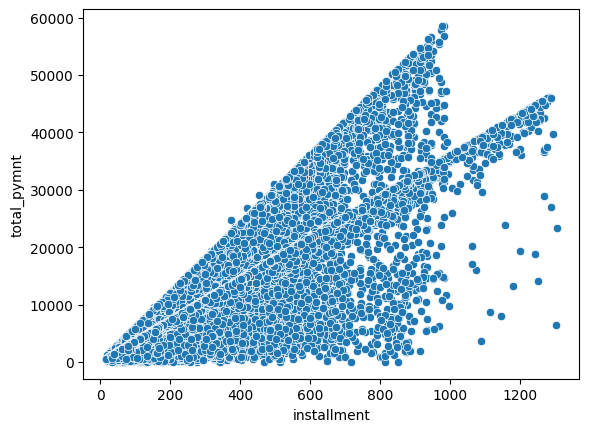

Creating Scatterplot for  installment vs total_pymnt_inv


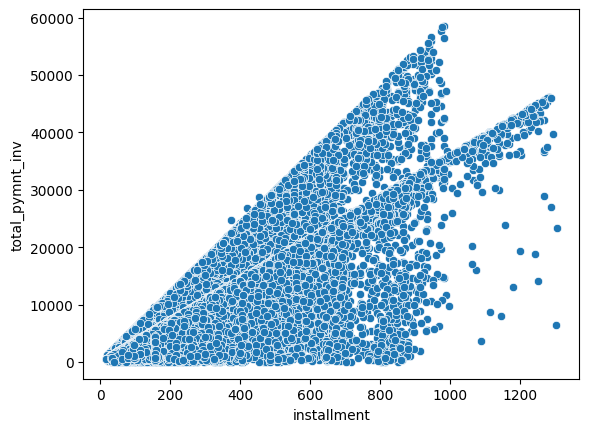

Creating Scatterplot for  installment vs total_rec_prncp


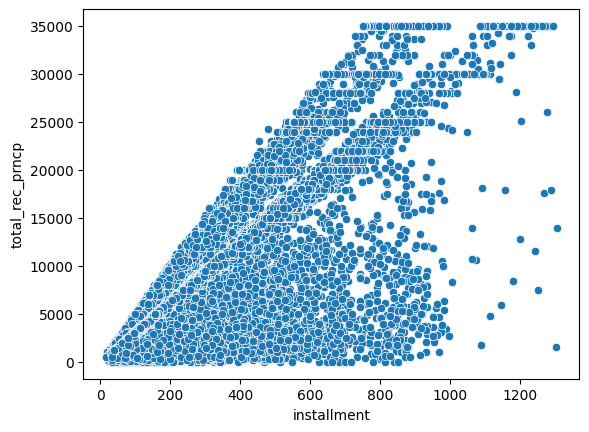

Creating Scatterplot for  installment vs total_rec_int


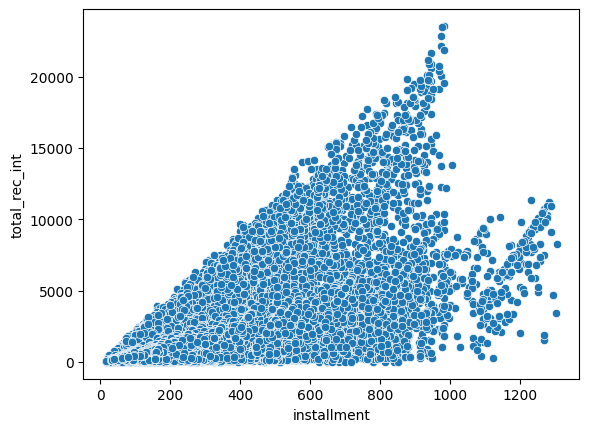

Creating Scatterplot for  installment vs total_rec_late_fee


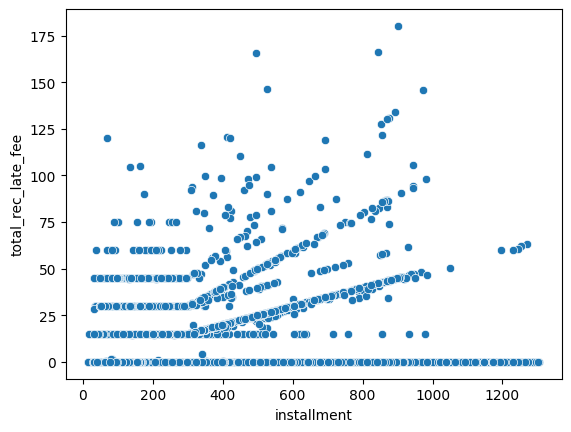

Creating Scatterplot for  installment vs recoveries


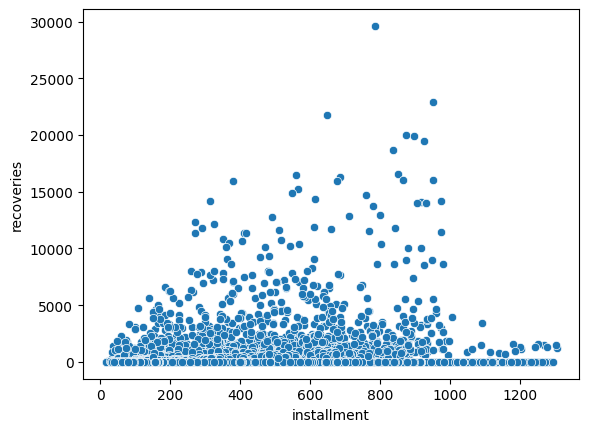

Creating Scatterplot for  installment vs collection_recovery_fee


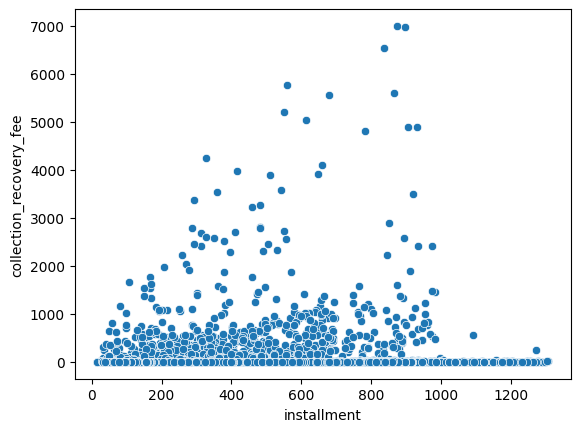

Creating Scatterplot for  installment vs last_pymnt_amnt


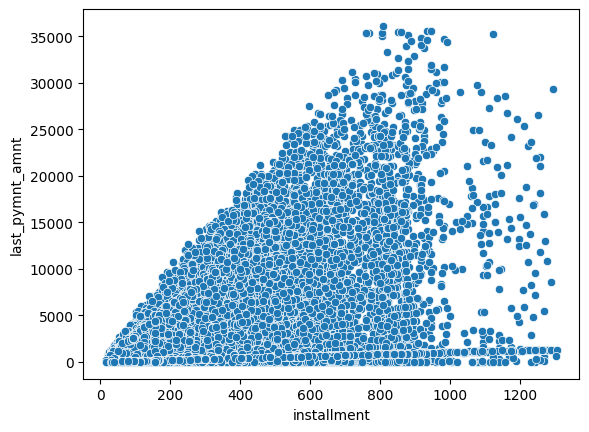

Creating Scatterplot for  annual_inc vs loan_amnt


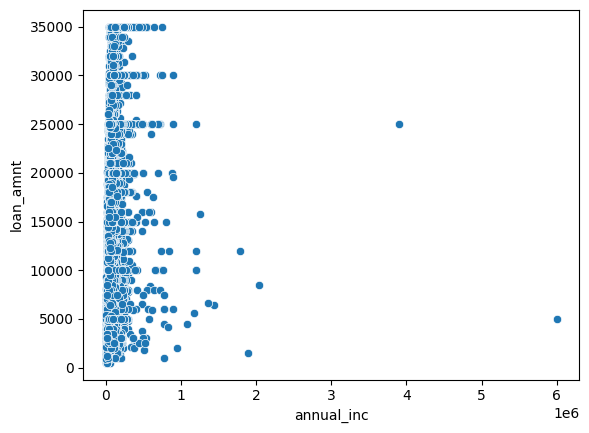

Creating Scatterplot for  annual_inc vs funded_amnt


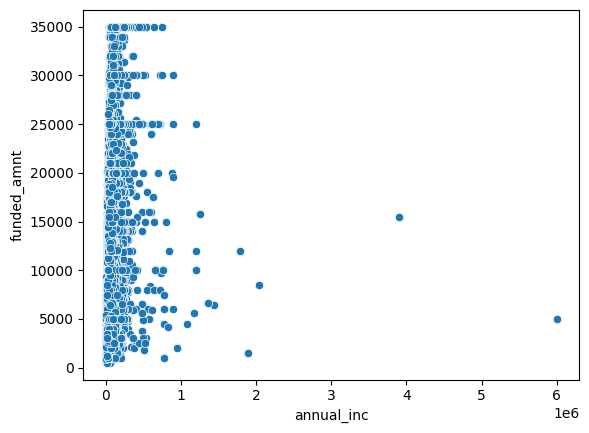

Creating Scatterplot for  annual_inc vs funded_amnt_inv


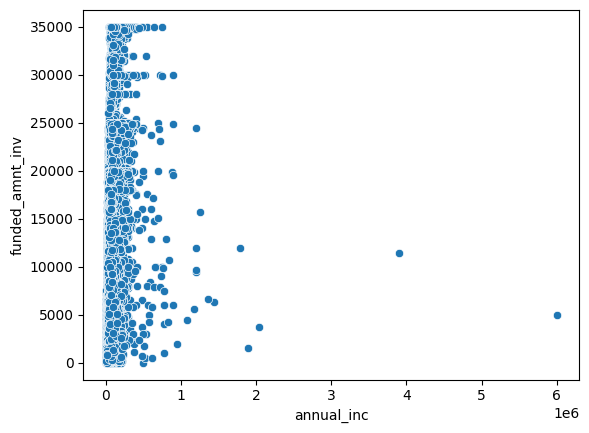

Creating Scatterplot for  annual_inc vs int_rate


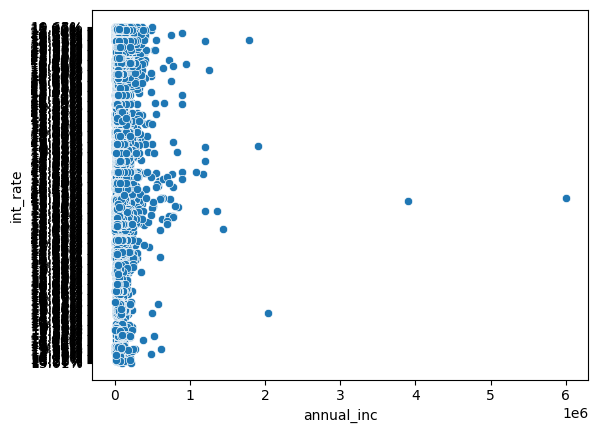

Creating Scatterplot for  annual_inc vs installment


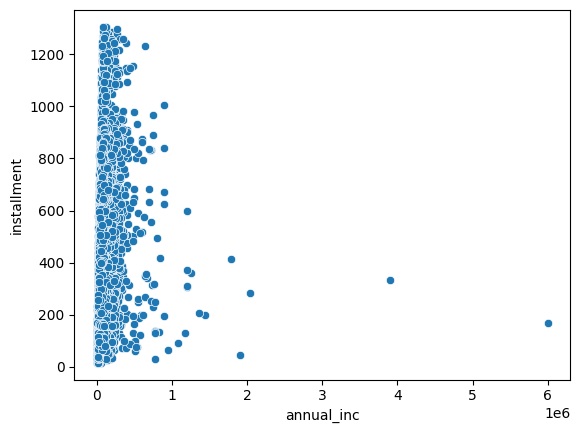

Creating Scatterplot for  annual_inc vs annual_inc


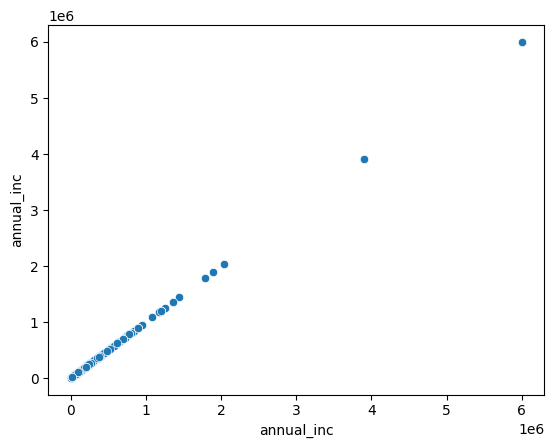

Creating Scatterplot for  annual_inc vs dti


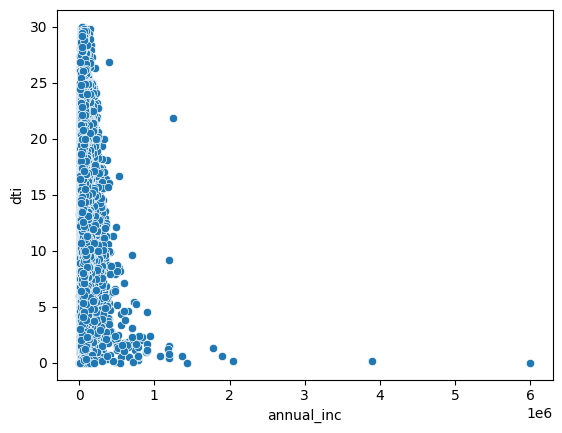

Creating Scatterplot for  annual_inc vs revol_bal


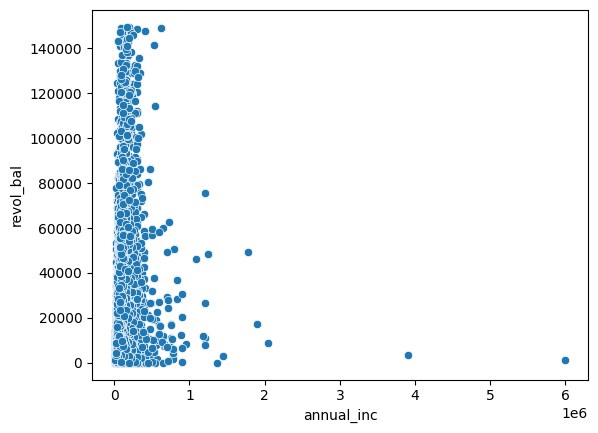

Creating Scatterplot for  annual_inc vs revol_util


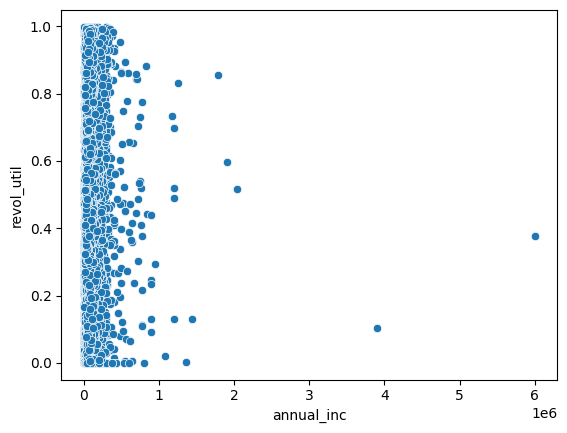

Creating Scatterplot for  annual_inc vs total_pymnt


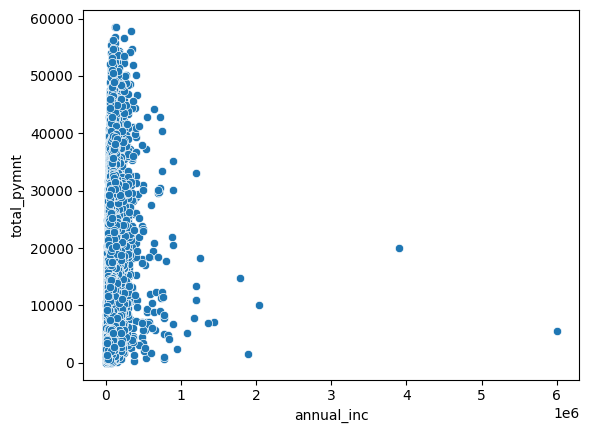

Creating Scatterplot for  annual_inc vs total_pymnt_inv


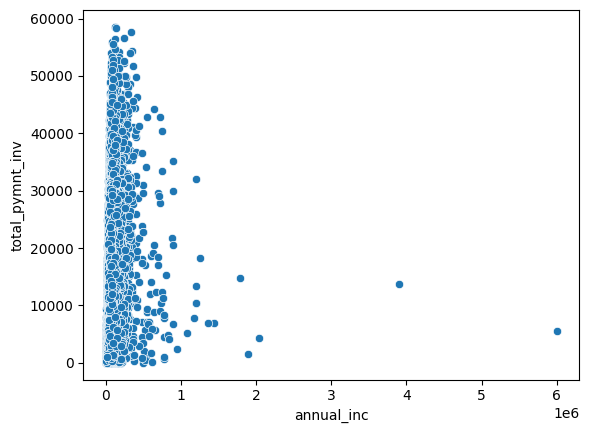

Creating Scatterplot for  annual_inc vs total_rec_prncp


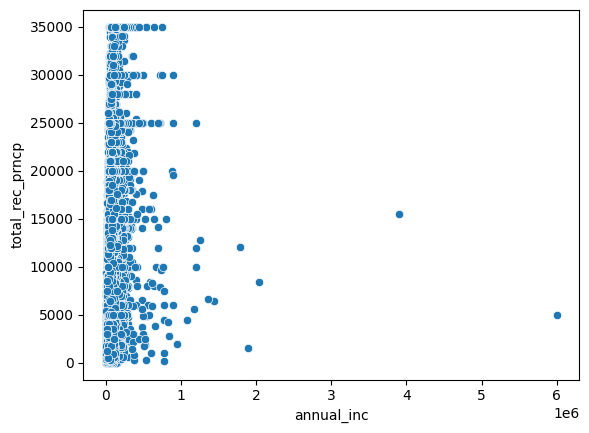

Creating Scatterplot for  annual_inc vs total_rec_int


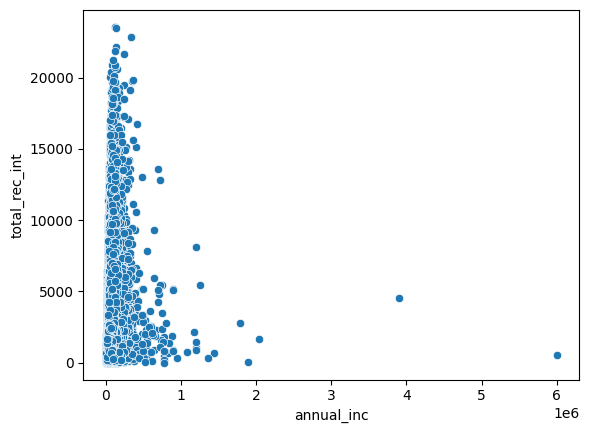

Creating Scatterplot for  annual_inc vs total_rec_late_fee


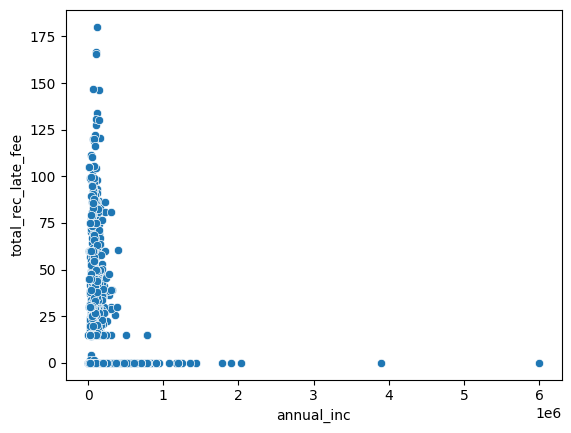

Creating Scatterplot for  annual_inc vs recoveries


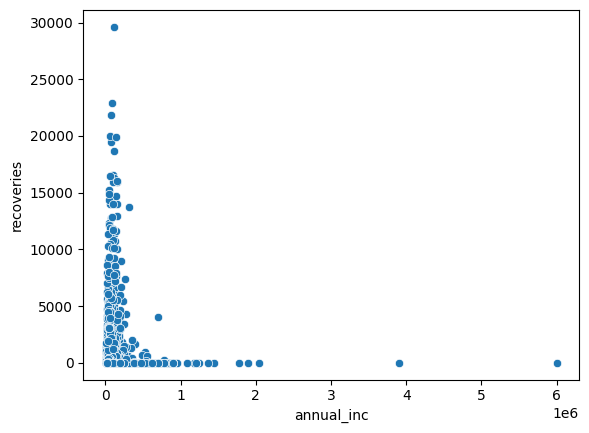

Creating Scatterplot for  annual_inc vs collection_recovery_fee


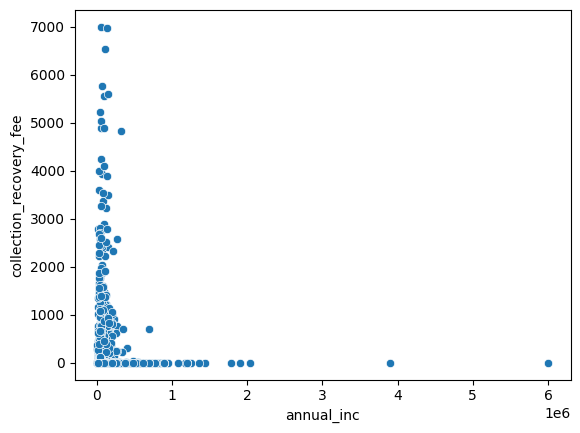

Creating Scatterplot for  annual_inc vs last_pymnt_amnt


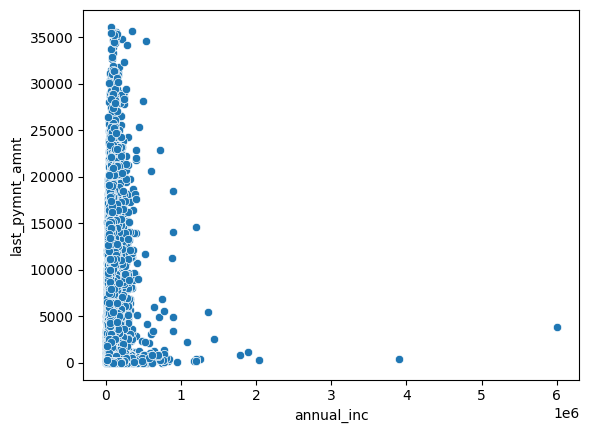

Creating Scatterplot for  dti vs loan_amnt


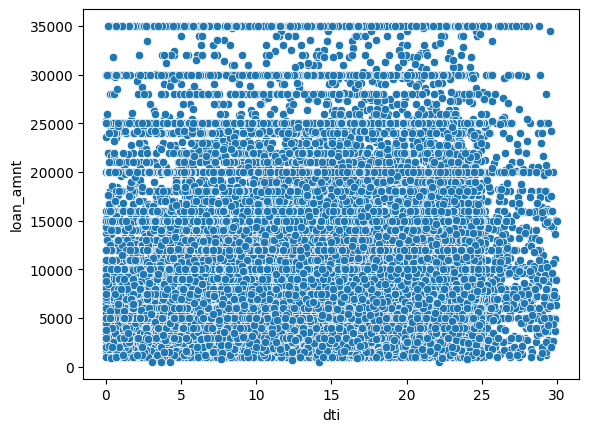

Creating Scatterplot for  dti vs funded_amnt


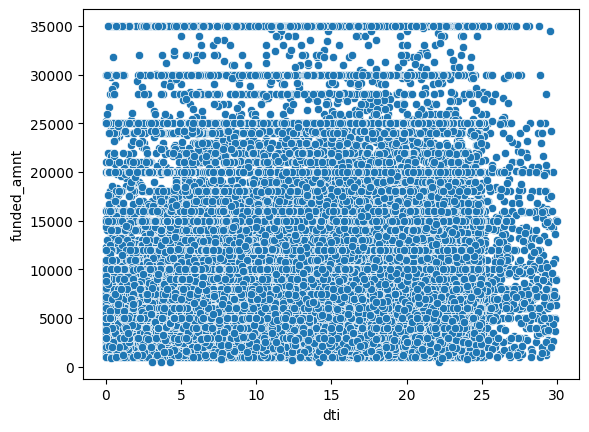

Creating Scatterplot for  dti vs funded_amnt_inv


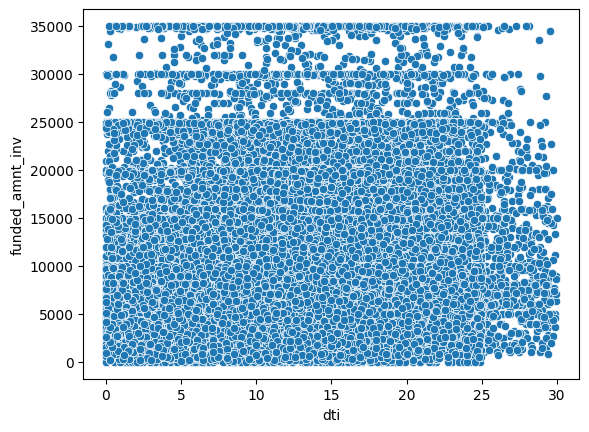

Creating Scatterplot for  dti vs int_rate


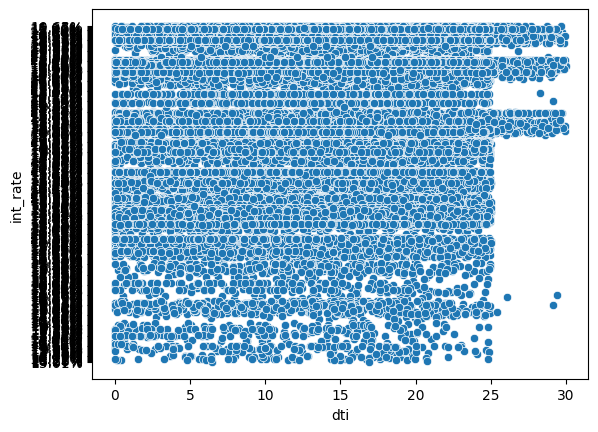

Creating Scatterplot for  dti vs installment


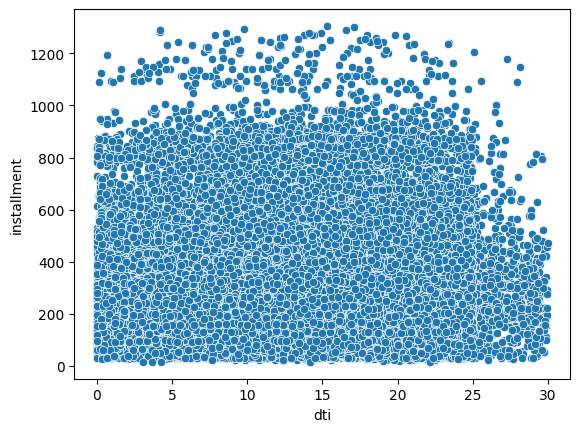

Creating Scatterplot for  dti vs annual_inc


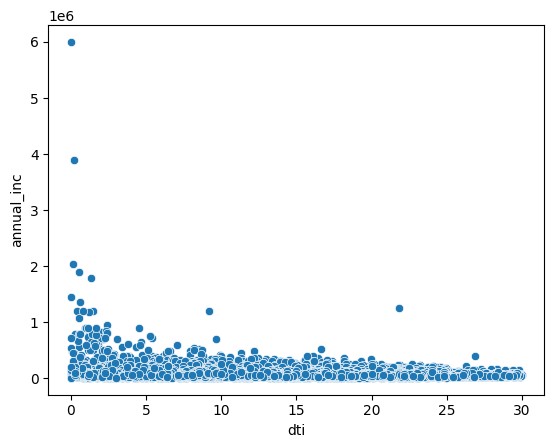

Creating Scatterplot for  dti vs dti


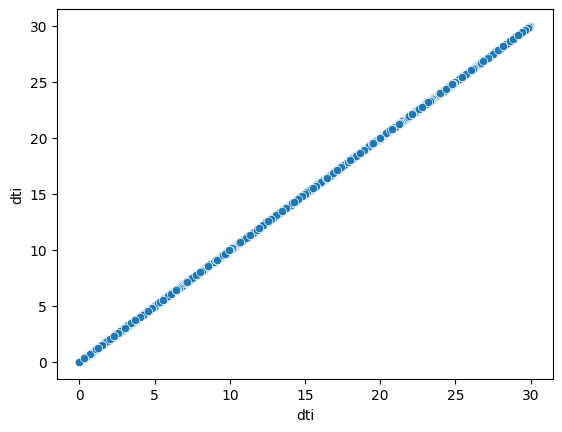

Creating Scatterplot for  dti vs revol_bal


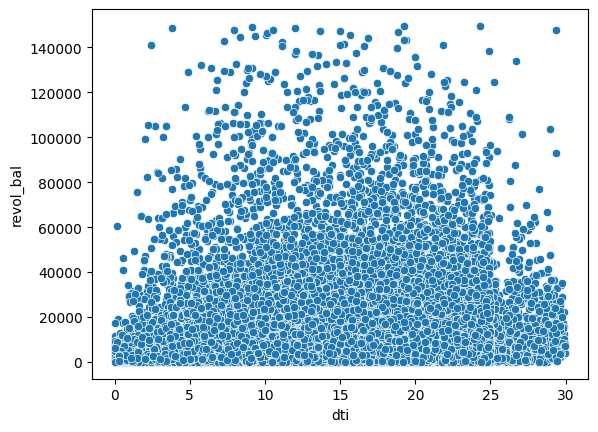

Creating Scatterplot for  dti vs revol_util


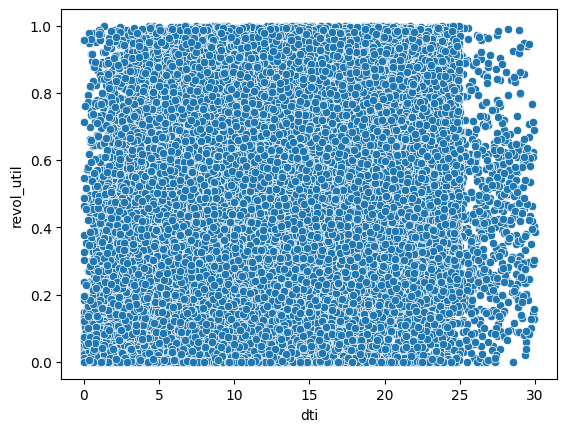

Creating Scatterplot for  dti vs total_pymnt


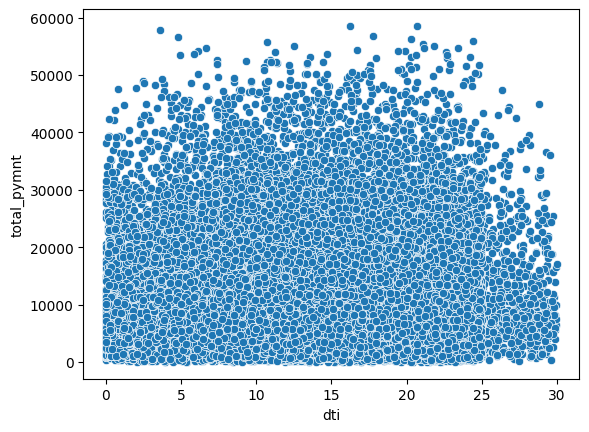

Creating Scatterplot for  dti vs total_pymnt_inv


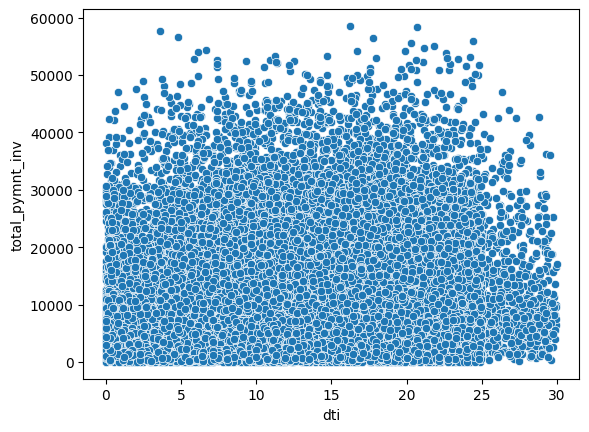

Creating Scatterplot for  dti vs total_rec_prncp


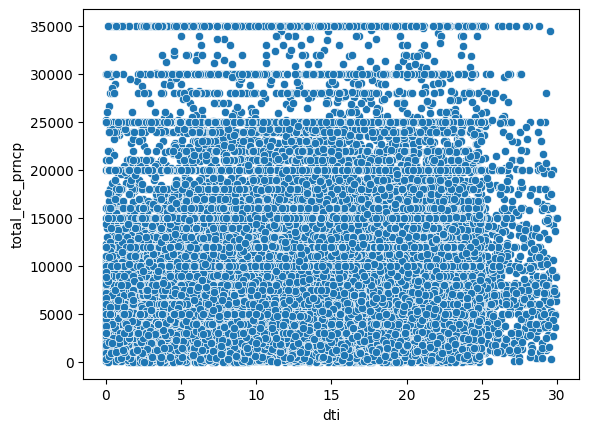

Creating Scatterplot for  dti vs total_rec_int


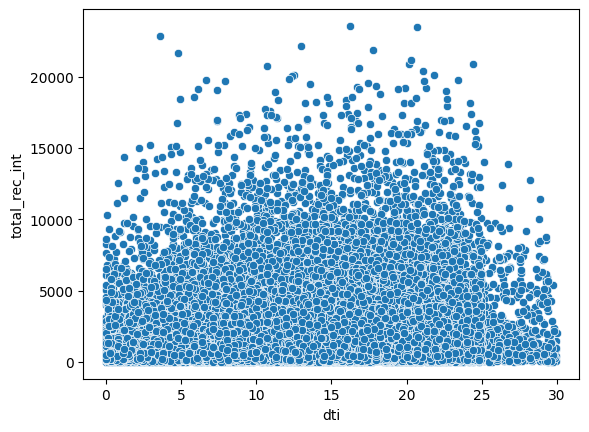

Creating Scatterplot for  dti vs total_rec_late_fee


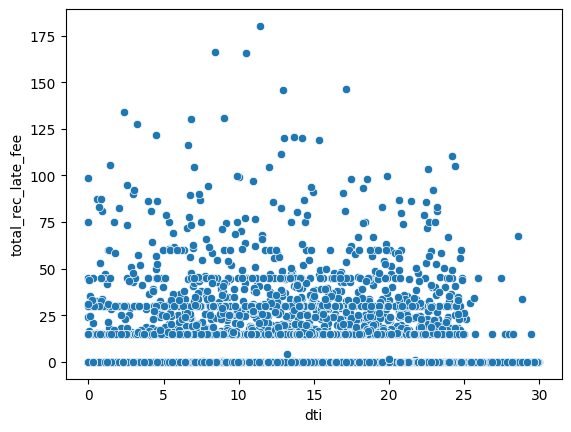

Creating Scatterplot for  dti vs recoveries


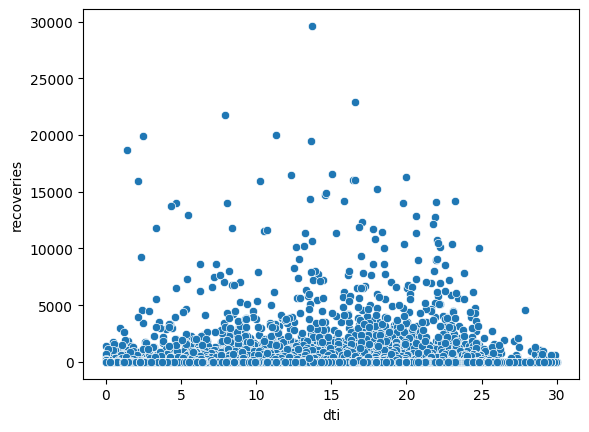

Creating Scatterplot for  dti vs collection_recovery_fee


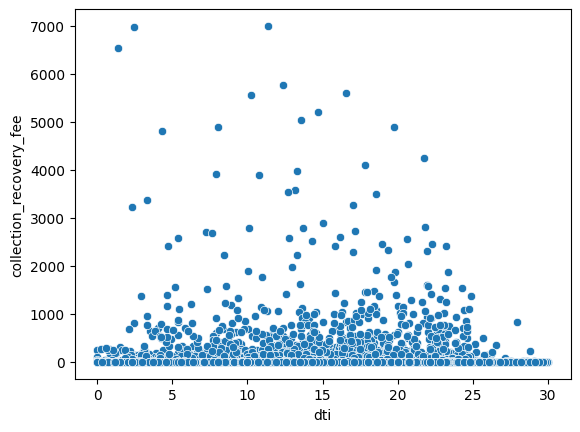

Creating Scatterplot for  dti vs last_pymnt_amnt


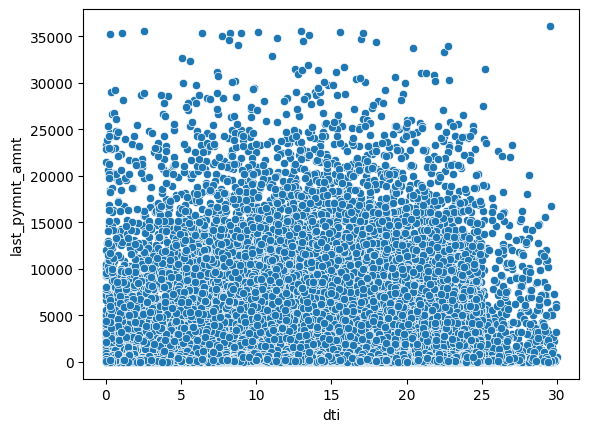

Creating Scatterplot for  revol_bal vs loan_amnt


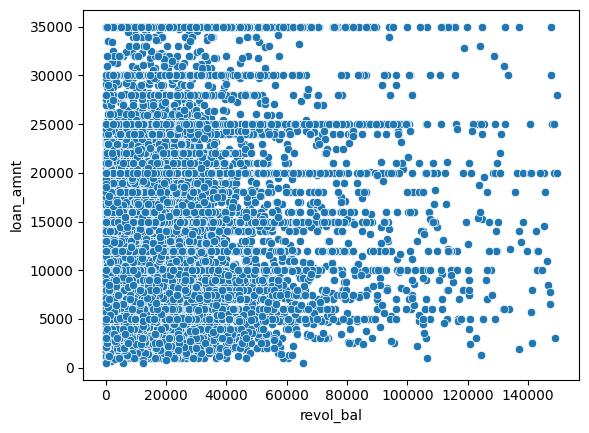

Creating Scatterplot for  revol_bal vs funded_amnt


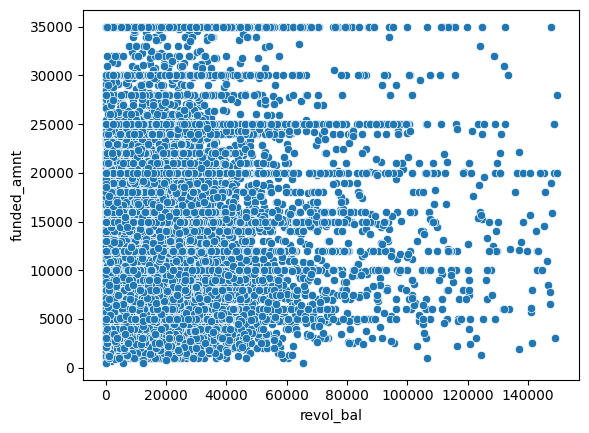

Creating Scatterplot for  revol_bal vs funded_amnt_inv


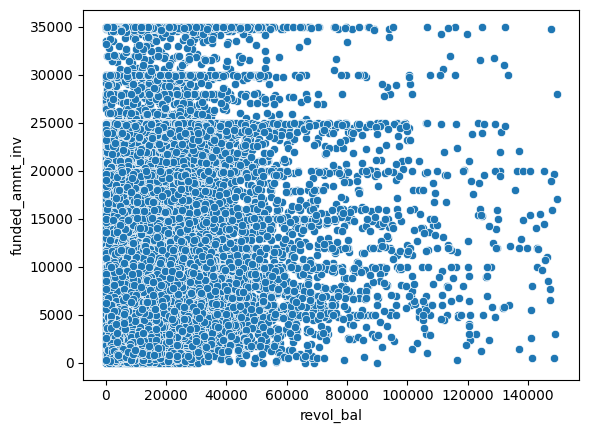

Creating Scatterplot for  revol_bal vs int_rate


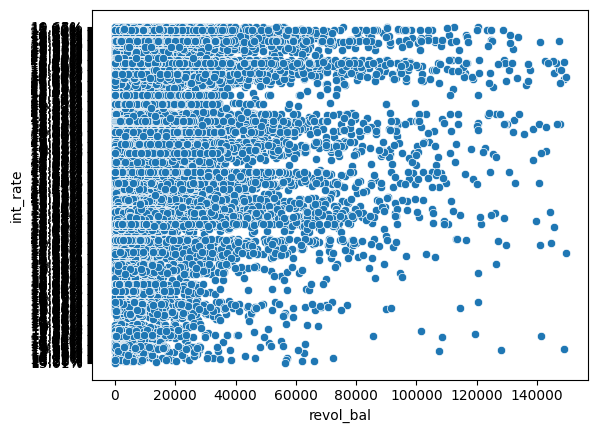

Creating Scatterplot for  revol_bal vs installment


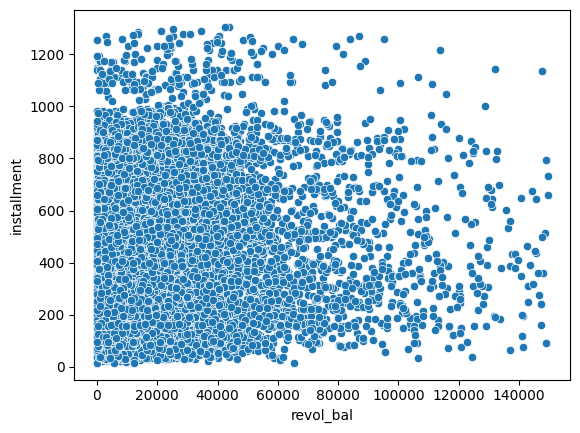

Creating Scatterplot for  revol_bal vs annual_inc


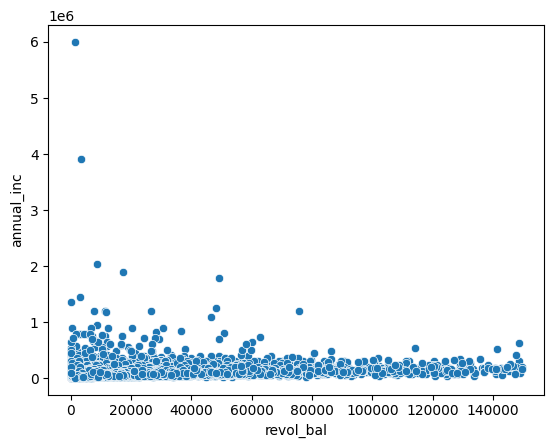

Creating Scatterplot for  revol_bal vs dti


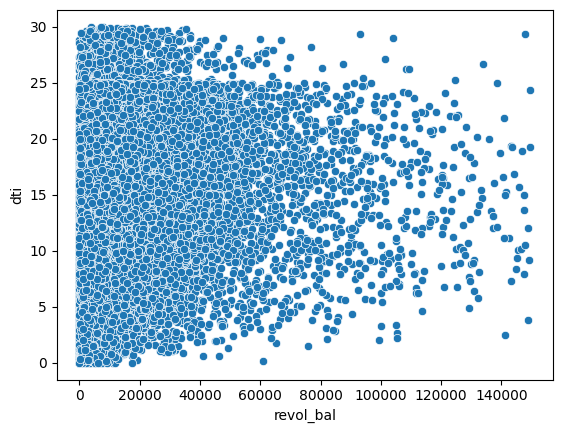

Creating Scatterplot for  revol_bal vs revol_bal


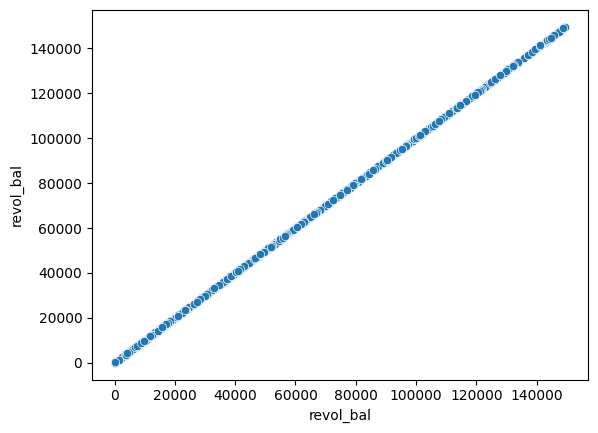

Creating Scatterplot for  revol_bal vs revol_util


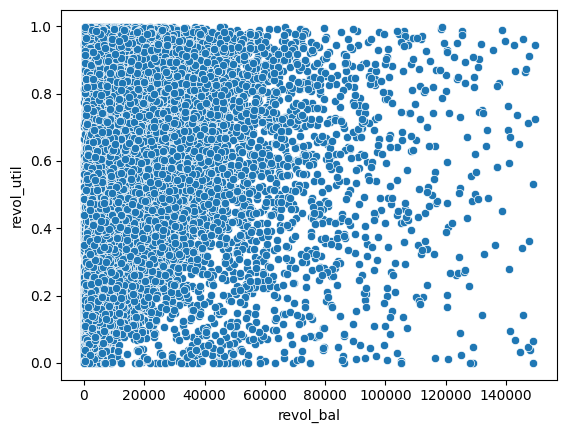

Creating Scatterplot for  revol_bal vs total_pymnt


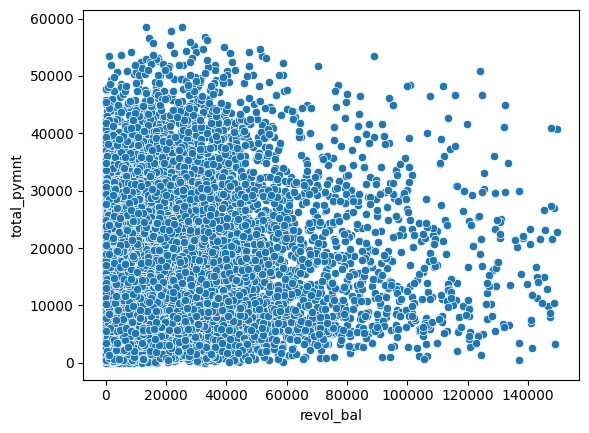

Creating Scatterplot for  revol_bal vs total_pymnt_inv


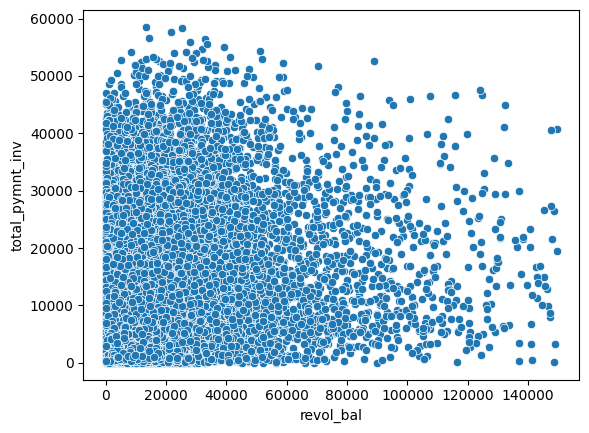

Creating Scatterplot for  revol_bal vs total_rec_prncp


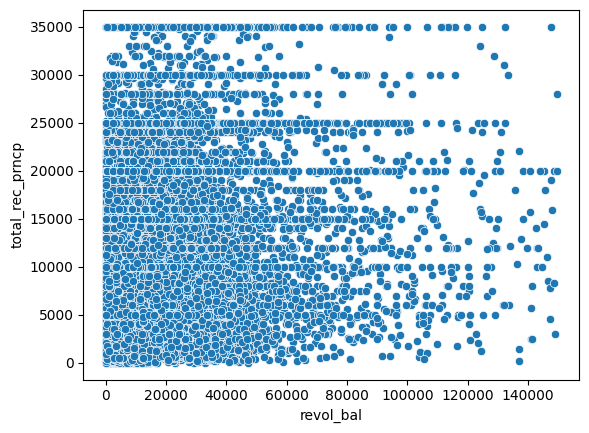

Creating Scatterplot for  revol_bal vs total_rec_int


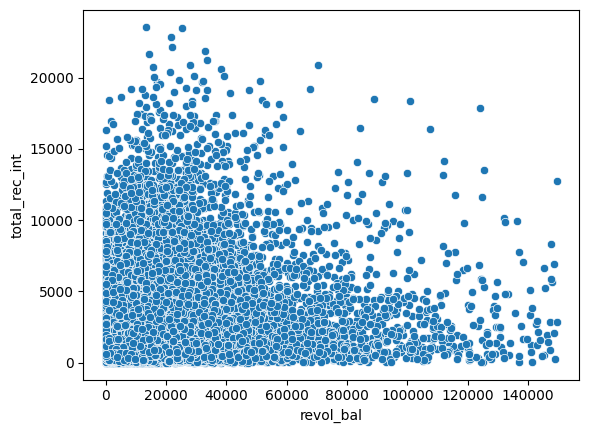

Creating Scatterplot for  revol_bal vs total_rec_late_fee


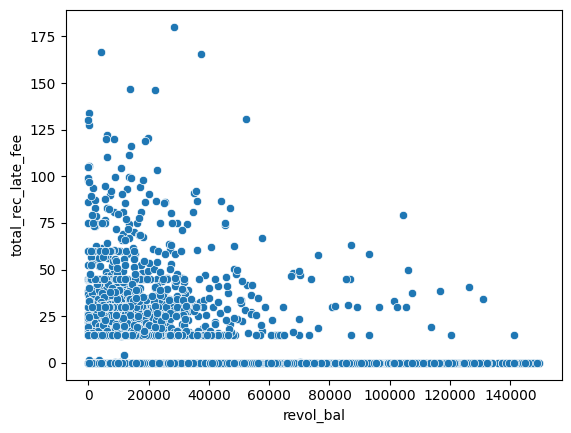

Creating Scatterplot for  revol_bal vs recoveries


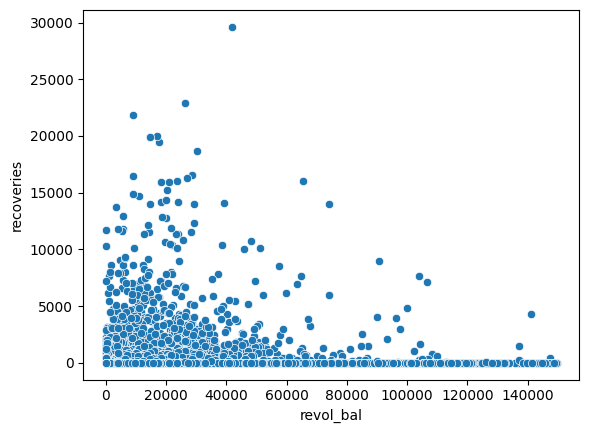

Creating Scatterplot for  revol_bal vs collection_recovery_fee


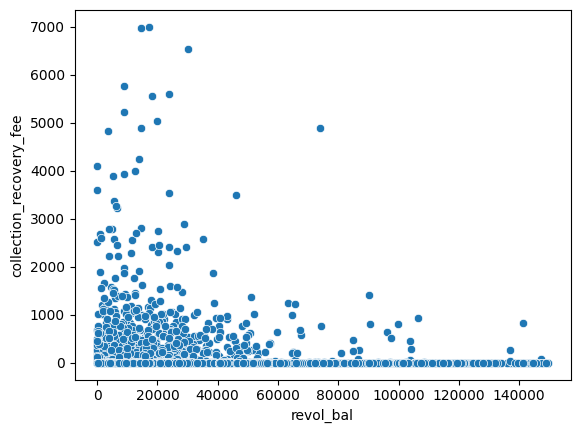

Creating Scatterplot for  revol_bal vs last_pymnt_amnt


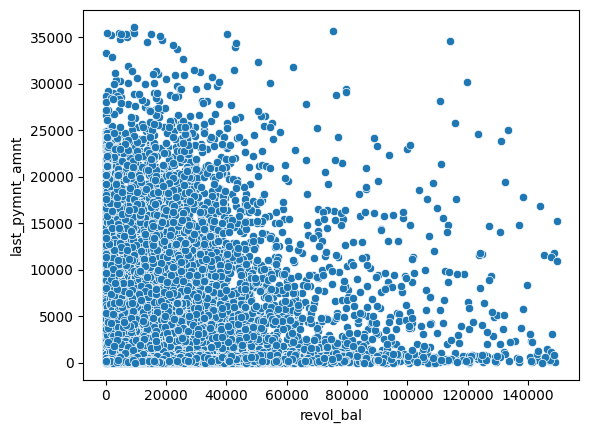

Creating Scatterplot for  revol_util vs loan_amnt


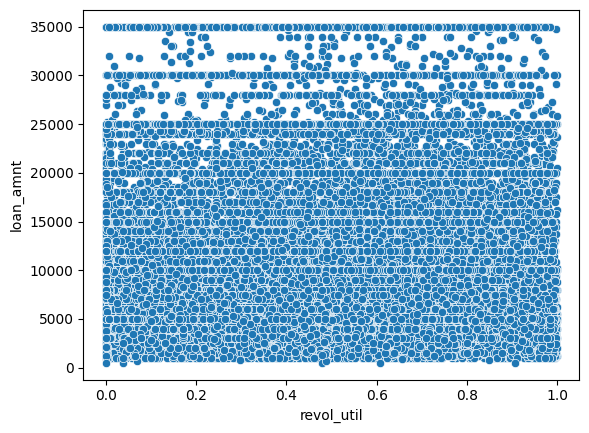

Creating Scatterplot for  revol_util vs funded_amnt


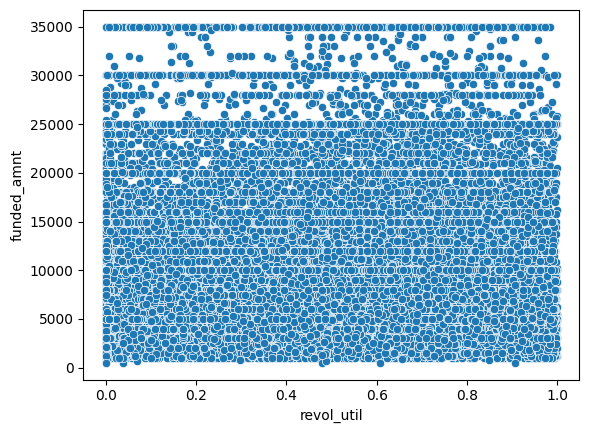

Creating Scatterplot for  revol_util vs funded_amnt_inv


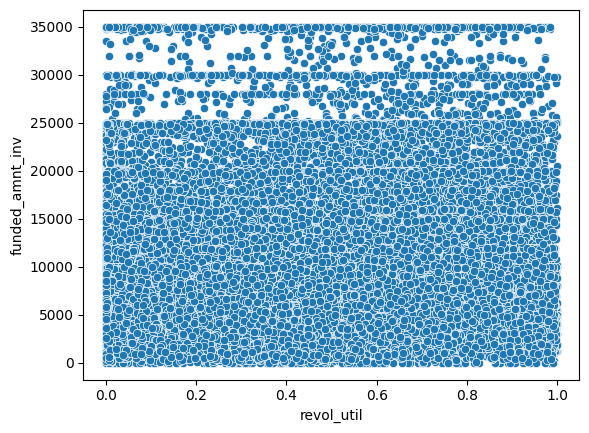

Creating Scatterplot for  revol_util vs int_rate


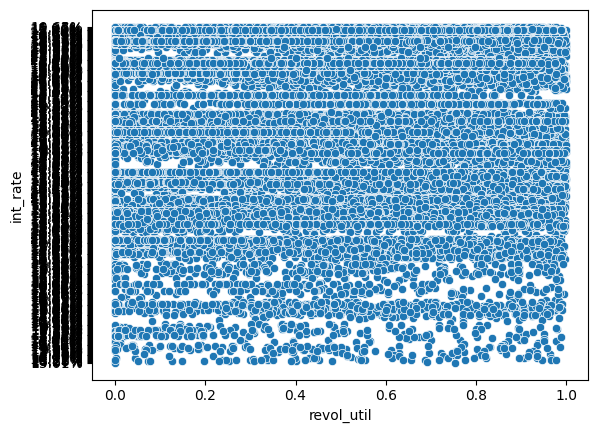

Creating Scatterplot for  revol_util vs installment


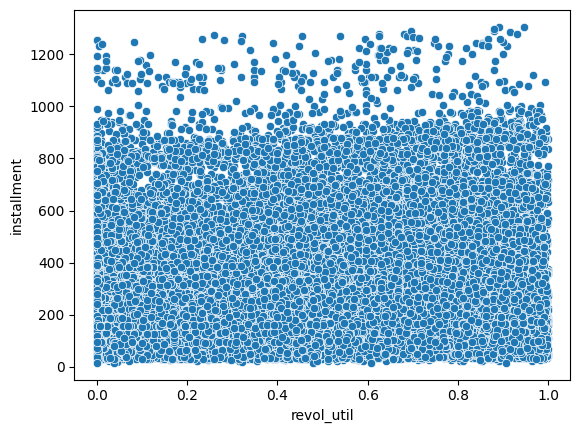

Creating Scatterplot for  revol_util vs annual_inc


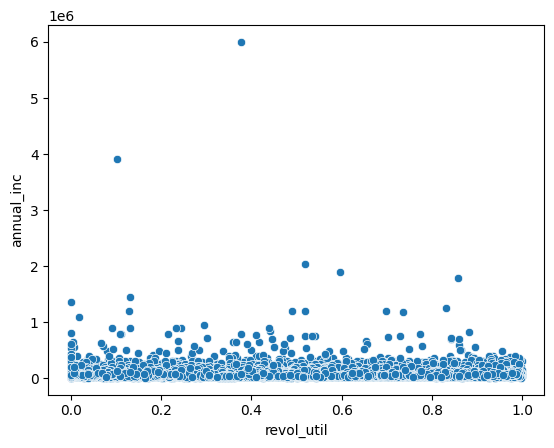

Creating Scatterplot for  revol_util vs dti


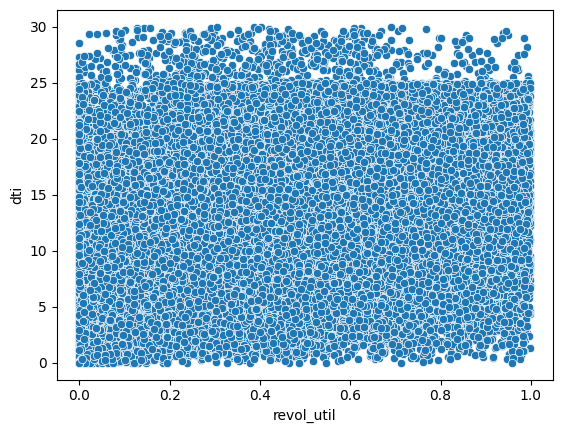

Creating Scatterplot for  revol_util vs revol_bal


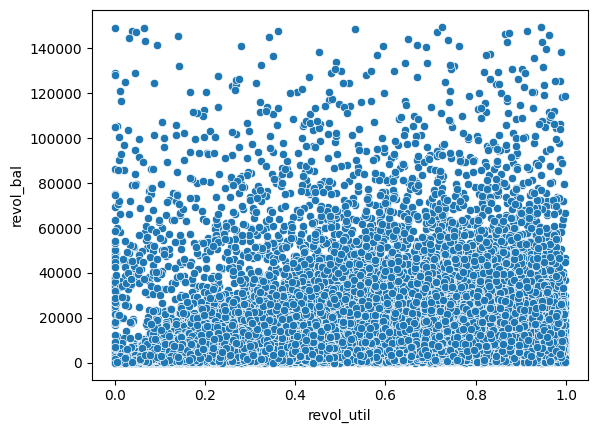

Creating Scatterplot for  revol_util vs revol_util


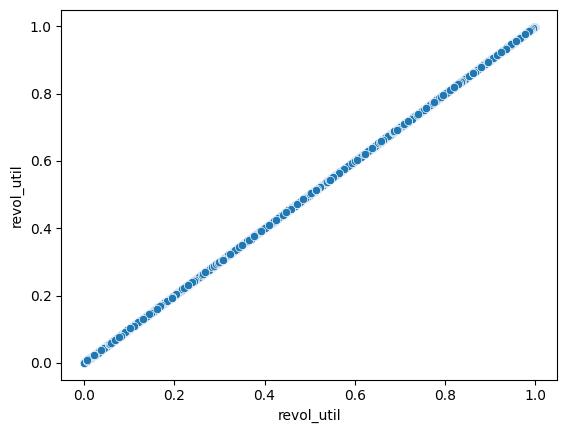

Creating Scatterplot for  revol_util vs total_pymnt


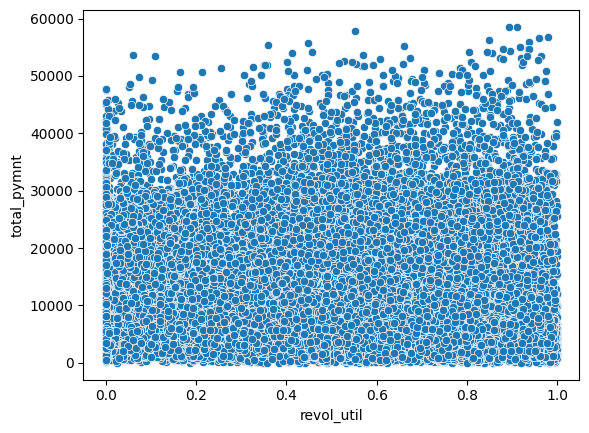

Creating Scatterplot for  revol_util vs total_pymnt_inv


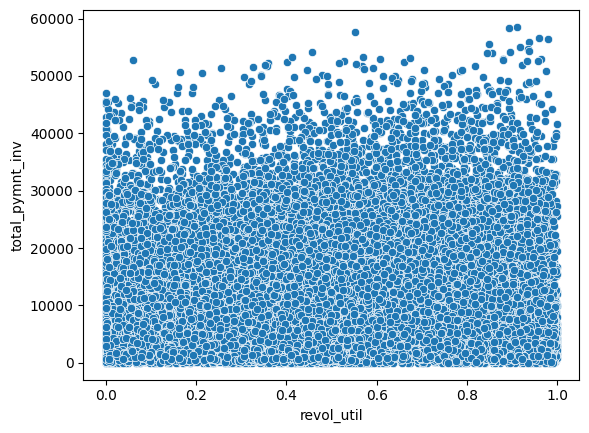

Creating Scatterplot for  revol_util vs total_rec_prncp


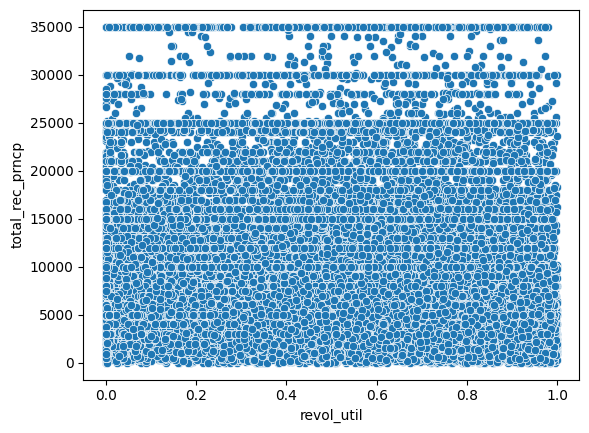

Creating Scatterplot for  revol_util vs total_rec_int


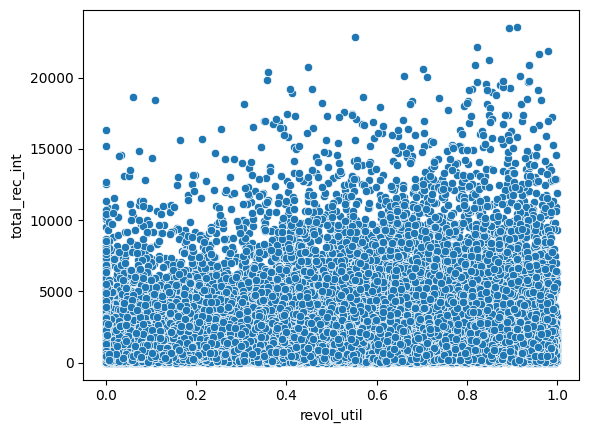

Creating Scatterplot for  revol_util vs total_rec_late_fee


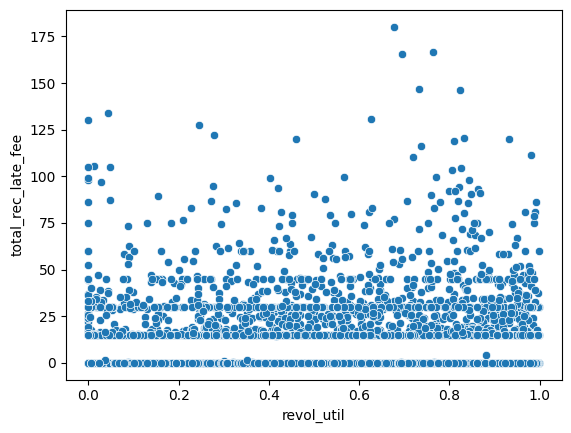

Creating Scatterplot for  revol_util vs recoveries


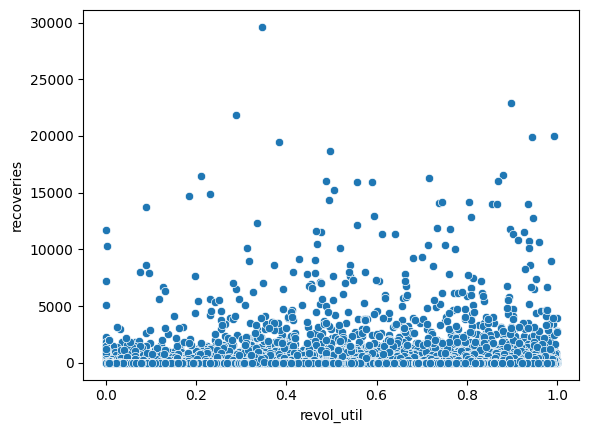

Creating Scatterplot for  revol_util vs collection_recovery_fee


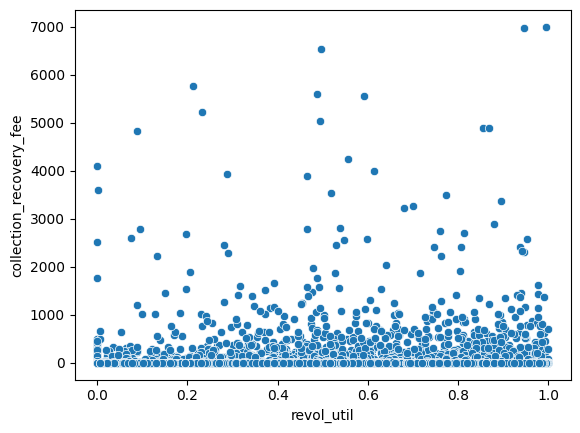

Creating Scatterplot for  revol_util vs last_pymnt_amnt


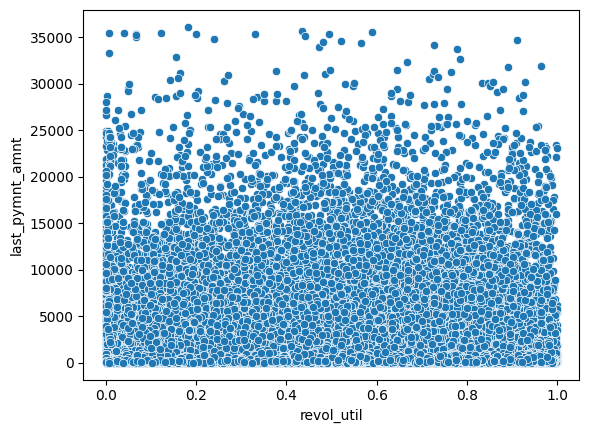

Creating Scatterplot for  total_pymnt vs loan_amnt


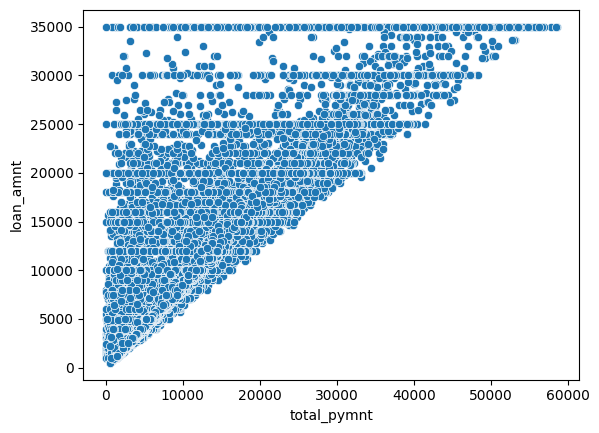

Creating Scatterplot for  total_pymnt vs funded_amnt


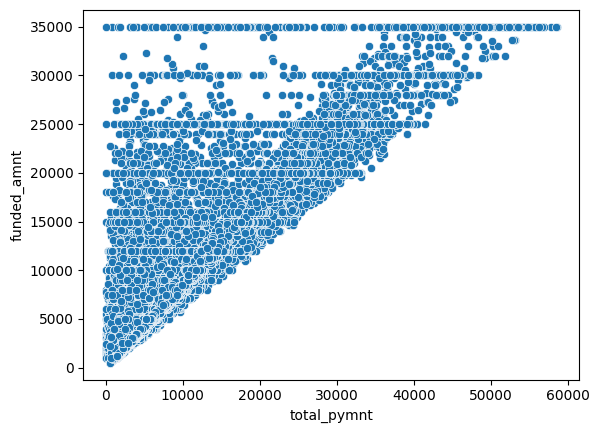

Creating Scatterplot for  total_pymnt vs funded_amnt_inv


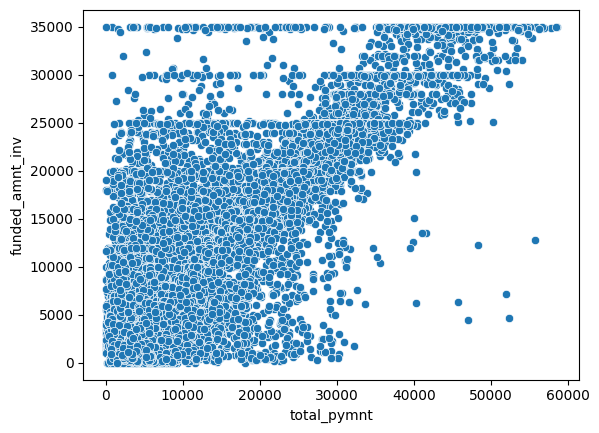

Creating Scatterplot for  total_pymnt vs int_rate


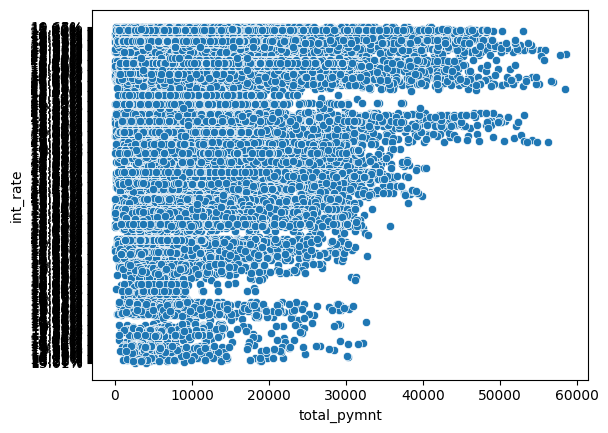

Creating Scatterplot for  total_pymnt vs installment


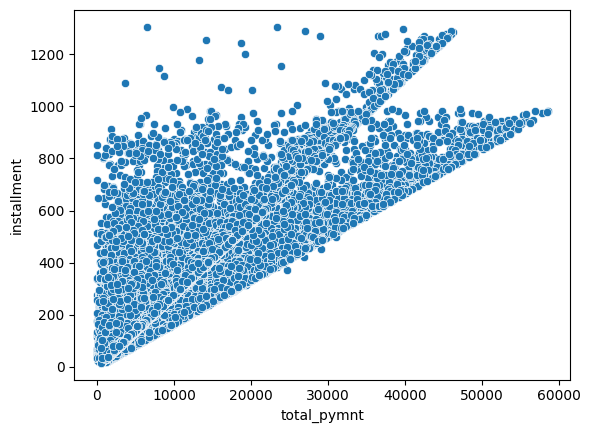

Creating Scatterplot for  total_pymnt vs annual_inc


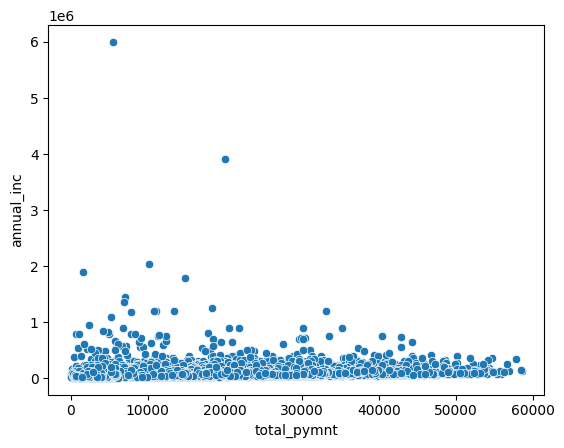

Creating Scatterplot for  total_pymnt vs dti


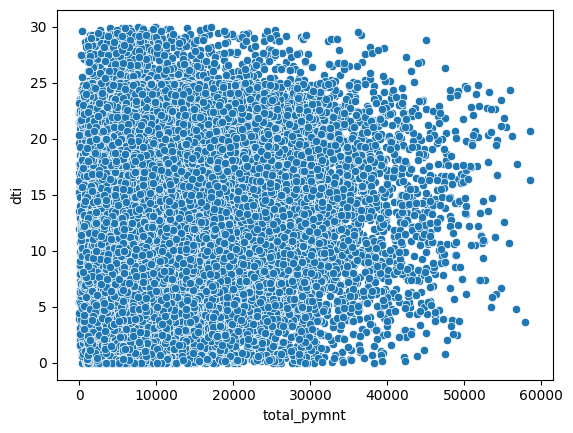

Creating Scatterplot for  total_pymnt vs revol_bal


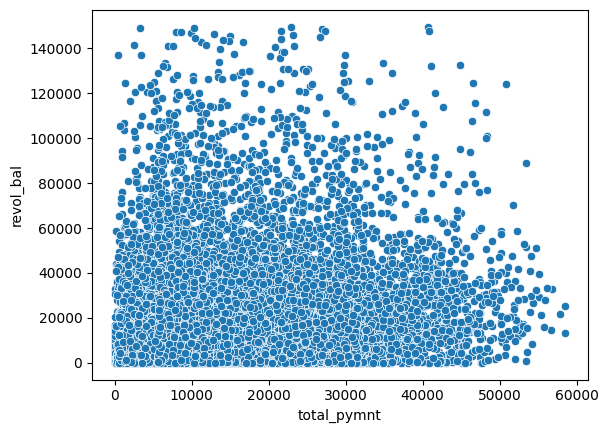

Creating Scatterplot for  total_pymnt vs revol_util


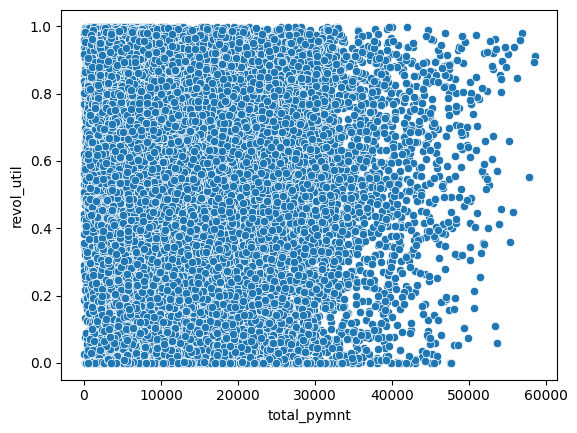

Creating Scatterplot for  total_pymnt vs total_pymnt


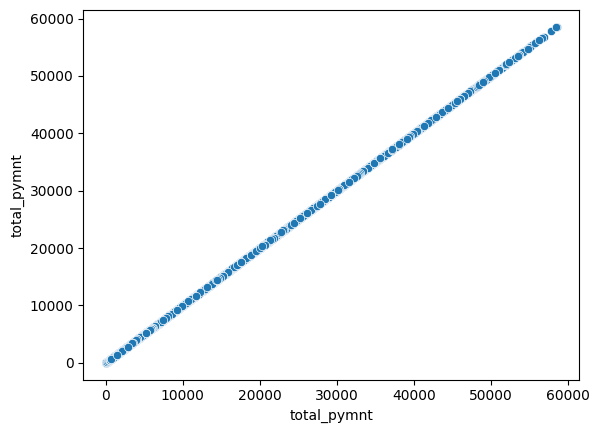

Creating Scatterplot for  total_pymnt vs total_pymnt_inv


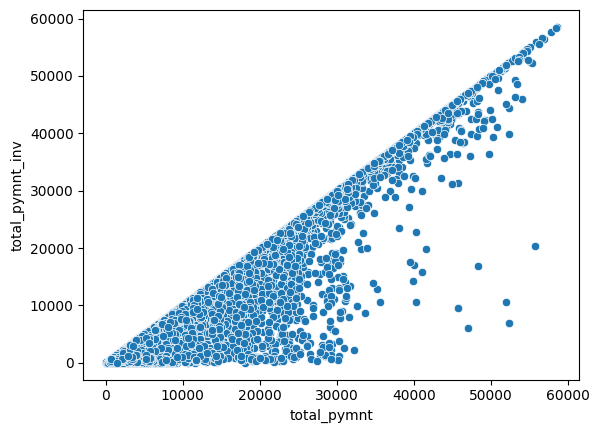

Creating Scatterplot for  total_pymnt vs total_rec_prncp


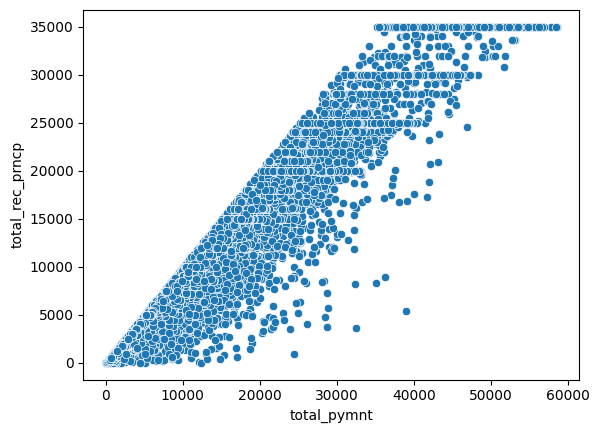

Creating Scatterplot for  total_pymnt vs total_rec_int


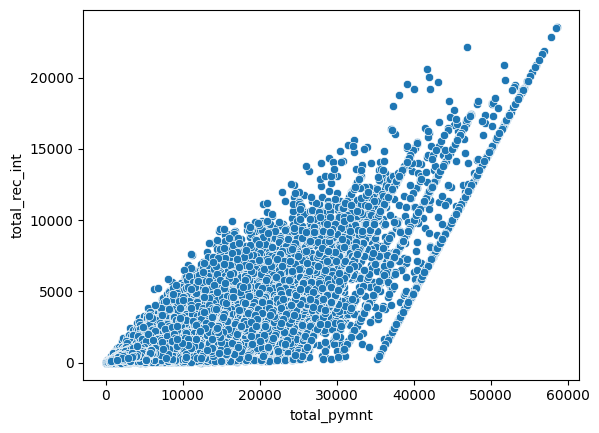

Creating Scatterplot for  total_pymnt vs total_rec_late_fee


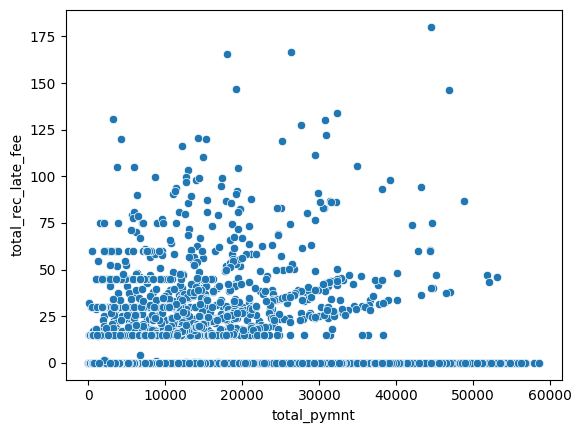

Creating Scatterplot for  total_pymnt vs recoveries


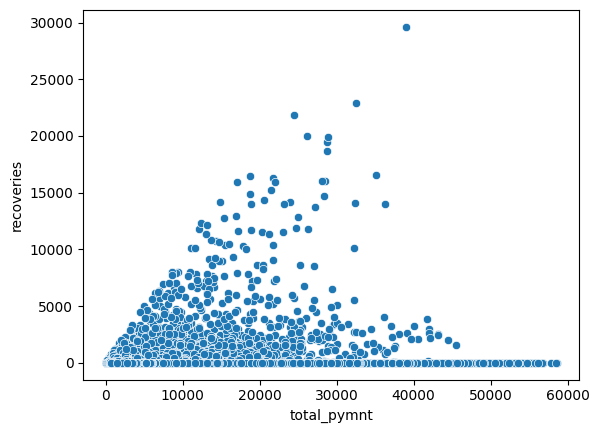

Creating Scatterplot for  total_pymnt vs collection_recovery_fee


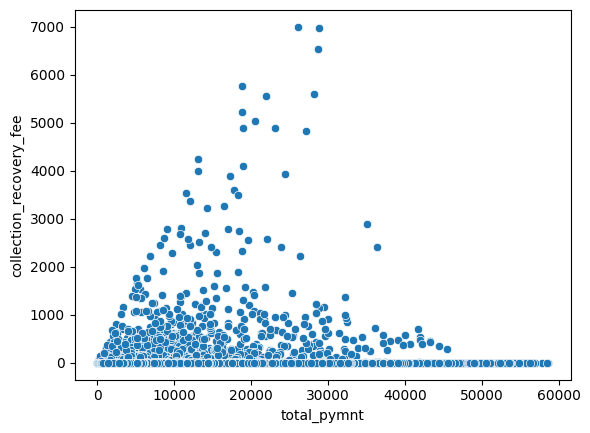

Creating Scatterplot for  total_pymnt vs last_pymnt_amnt


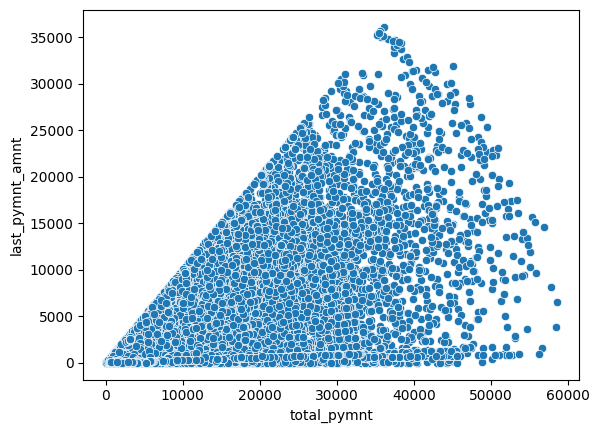

Creating Scatterplot for  total_pymnt_inv vs loan_amnt


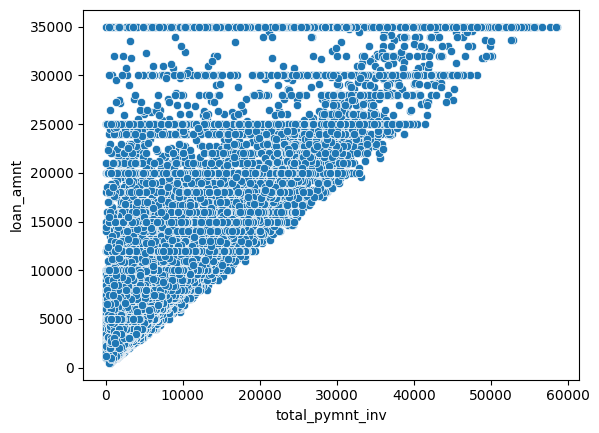

Creating Scatterplot for  total_pymnt_inv vs funded_amnt


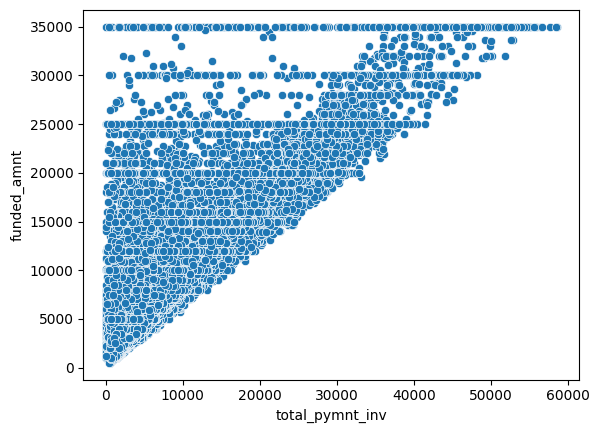

Creating Scatterplot for  total_pymnt_inv vs funded_amnt_inv


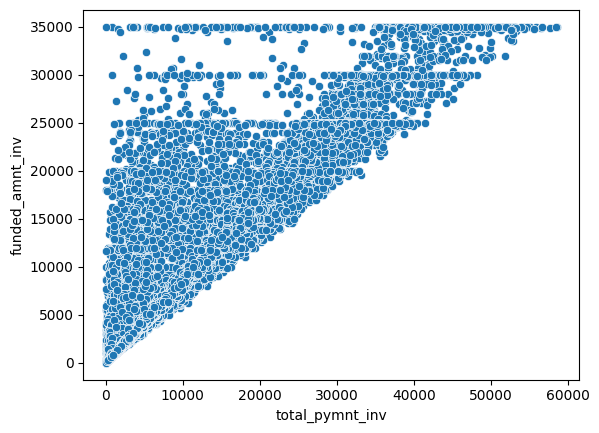

Creating Scatterplot for  total_pymnt_inv vs int_rate


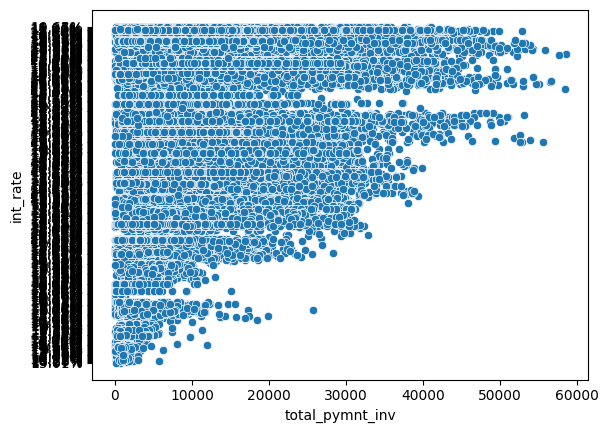

Creating Scatterplot for  total_pymnt_inv vs installment


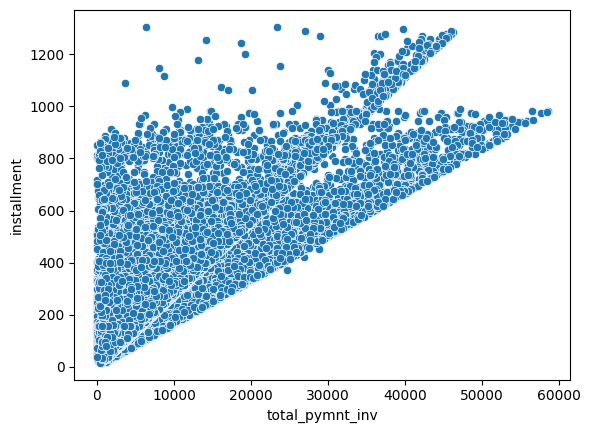

Creating Scatterplot for  total_pymnt_inv vs annual_inc


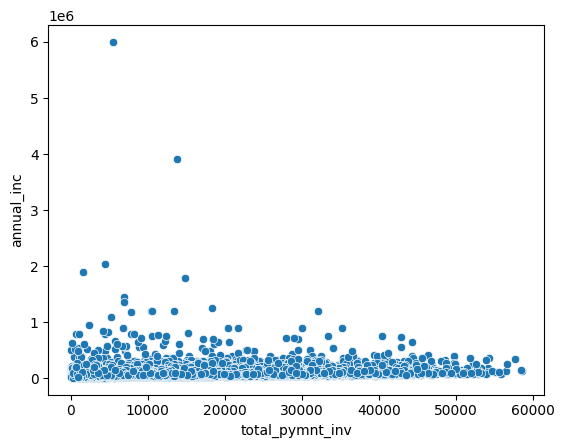

Creating Scatterplot for  total_pymnt_inv vs dti


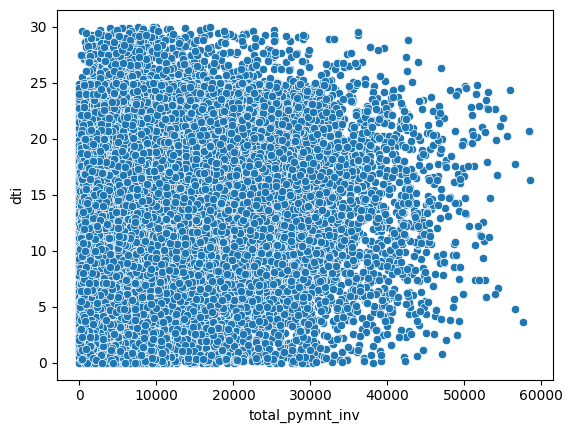

Creating Scatterplot for  total_pymnt_inv vs revol_bal


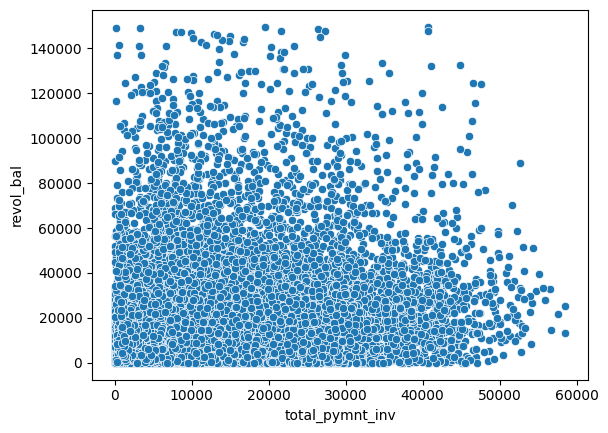

Creating Scatterplot for  total_pymnt_inv vs revol_util


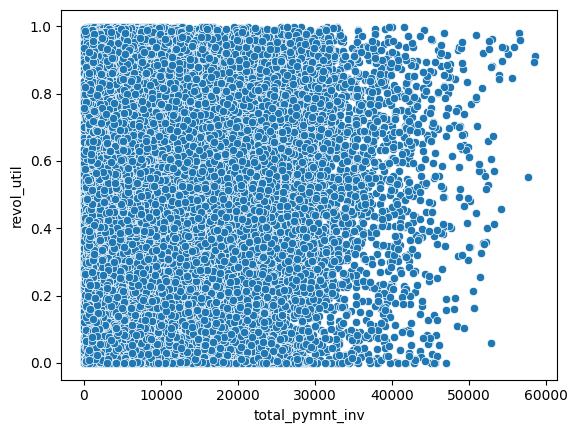

Creating Scatterplot for  total_pymnt_inv vs total_pymnt


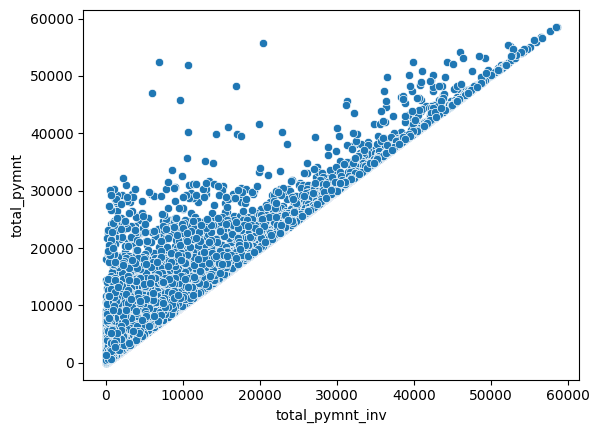

Creating Scatterplot for  total_pymnt_inv vs total_pymnt_inv


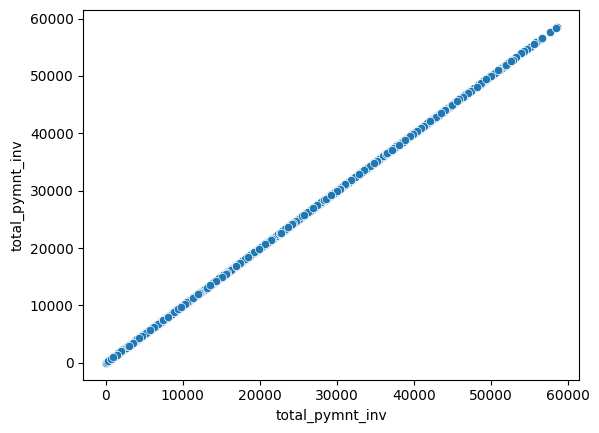

Creating Scatterplot for  total_pymnt_inv vs total_rec_prncp


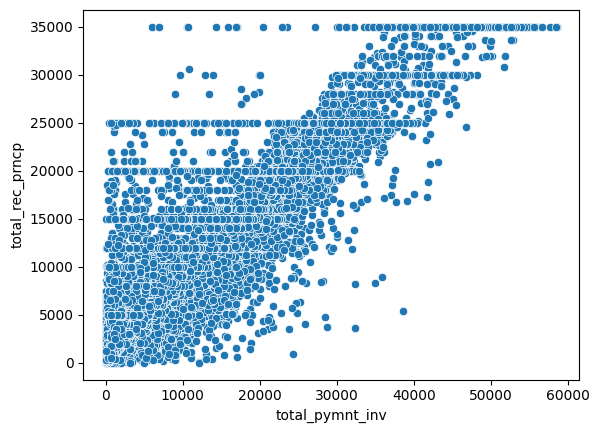

Creating Scatterplot for  total_pymnt_inv vs total_rec_int


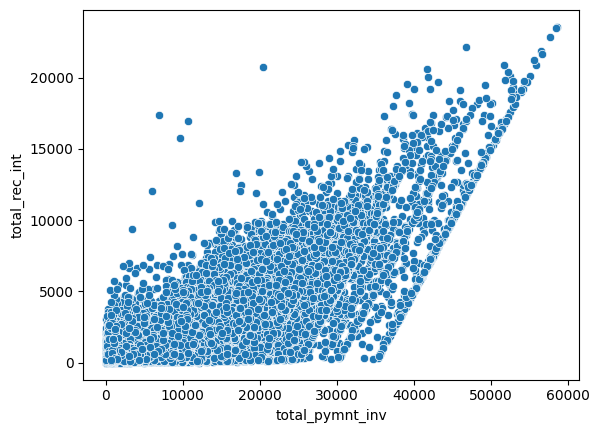

Creating Scatterplot for  total_pymnt_inv vs total_rec_late_fee


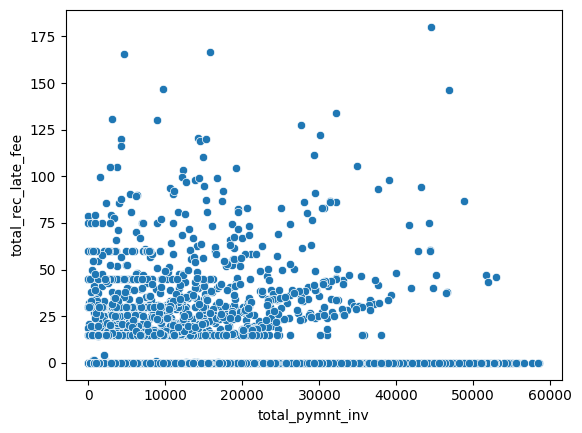

Creating Scatterplot for  total_pymnt_inv vs recoveries


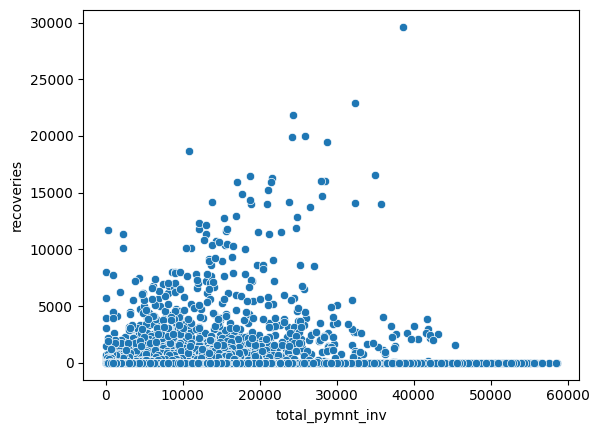

Creating Scatterplot for  total_pymnt_inv vs collection_recovery_fee


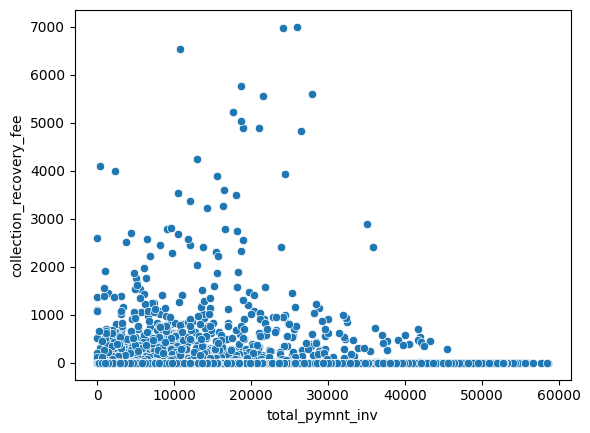

Creating Scatterplot for  total_pymnt_inv vs last_pymnt_amnt


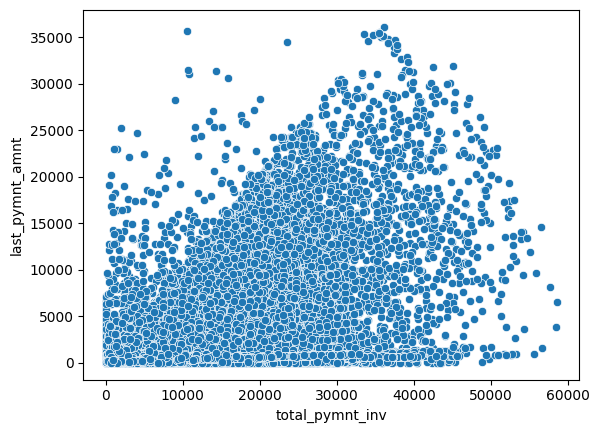

Creating Scatterplot for  total_rec_prncp vs loan_amnt


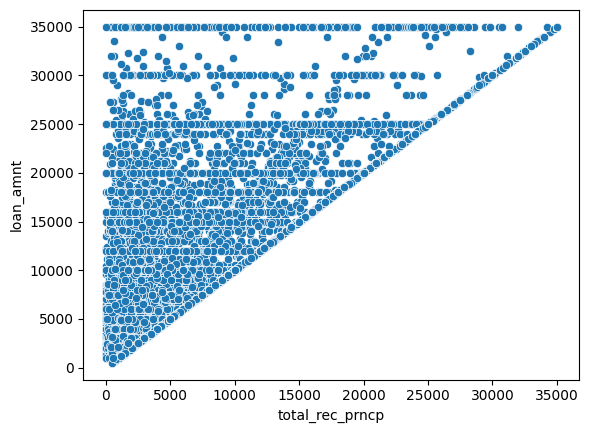

Creating Scatterplot for  total_rec_prncp vs funded_amnt


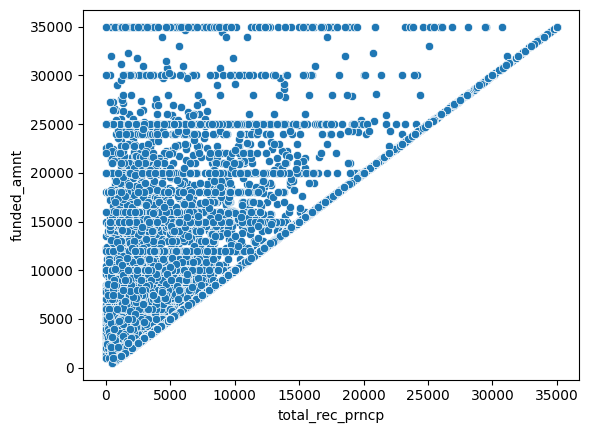

Creating Scatterplot for  total_rec_prncp vs funded_amnt_inv


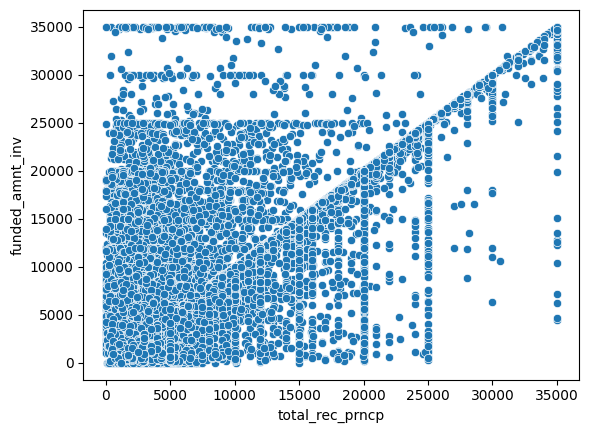

Creating Scatterplot for  total_rec_prncp vs int_rate


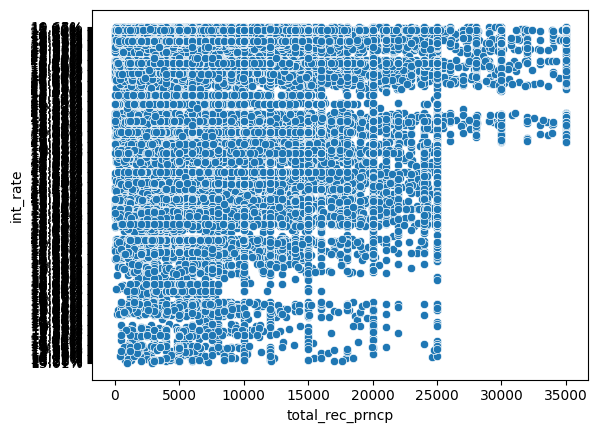

Creating Scatterplot for  total_rec_prncp vs installment


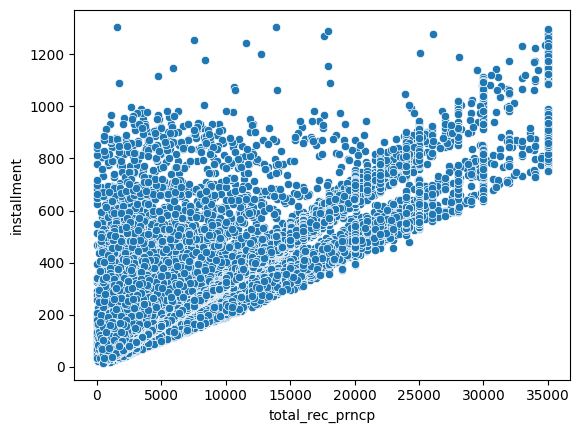

Creating Scatterplot for  total_rec_prncp vs annual_inc


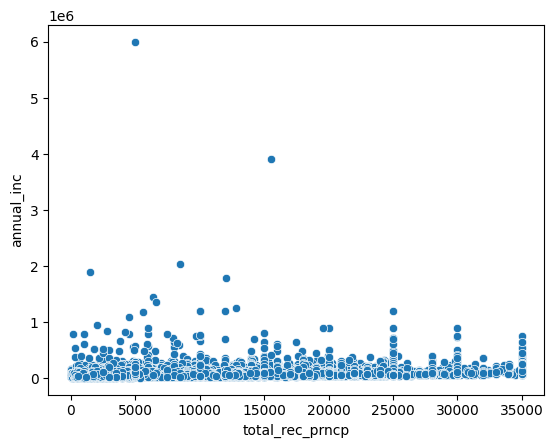

Creating Scatterplot for  total_rec_prncp vs dti


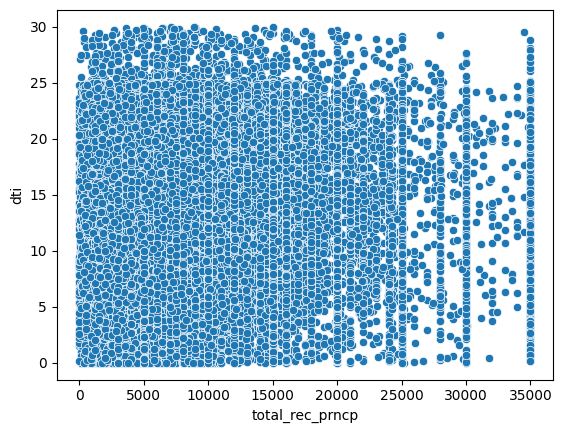

Creating Scatterplot for  total_rec_prncp vs revol_bal


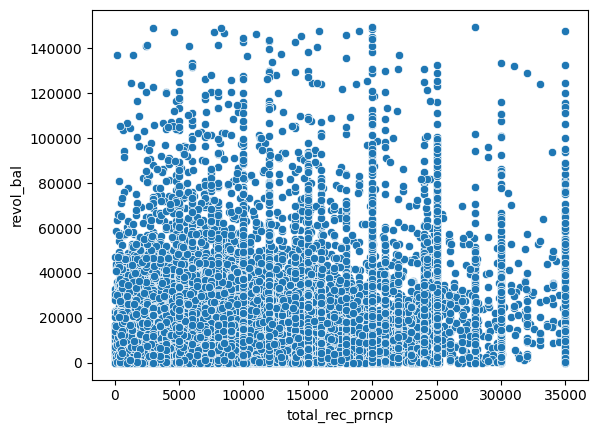

Creating Scatterplot for  total_rec_prncp vs revol_util


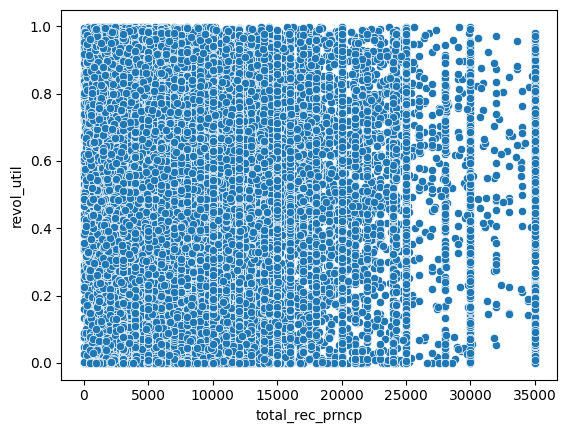

Creating Scatterplot for  total_rec_prncp vs total_pymnt


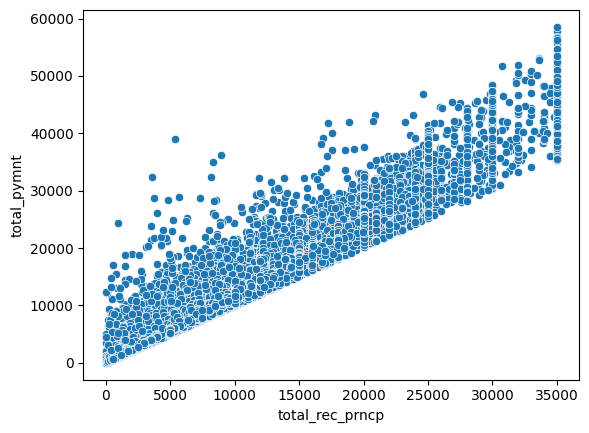

Creating Scatterplot for  total_rec_prncp vs total_pymnt_inv


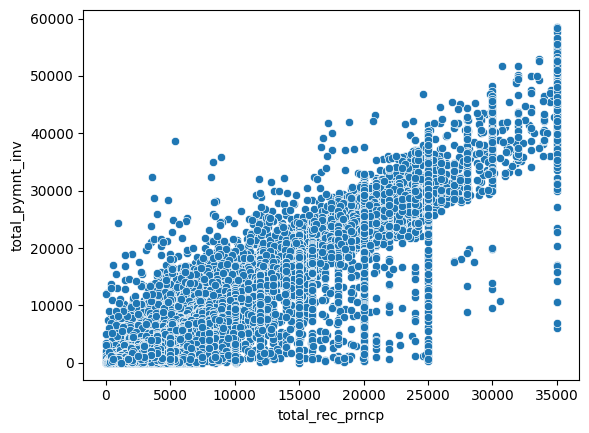

Creating Scatterplot for  total_rec_prncp vs total_rec_prncp


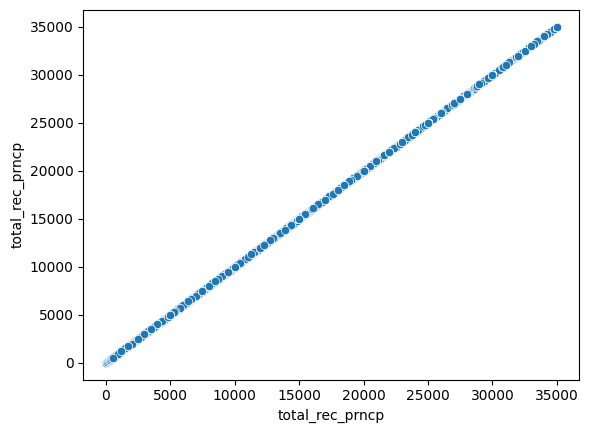

Creating Scatterplot for  total_rec_prncp vs total_rec_int


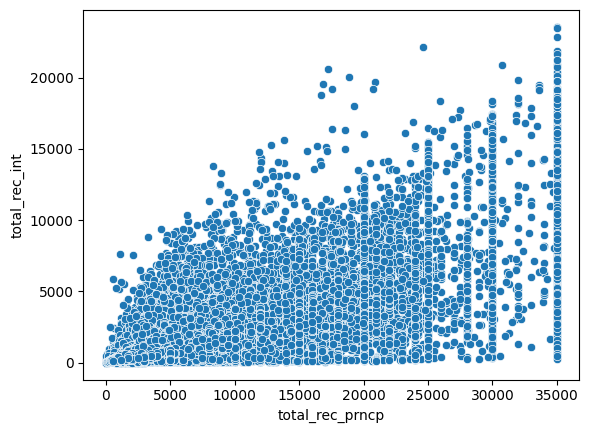

Creating Scatterplot for  total_rec_prncp vs total_rec_late_fee


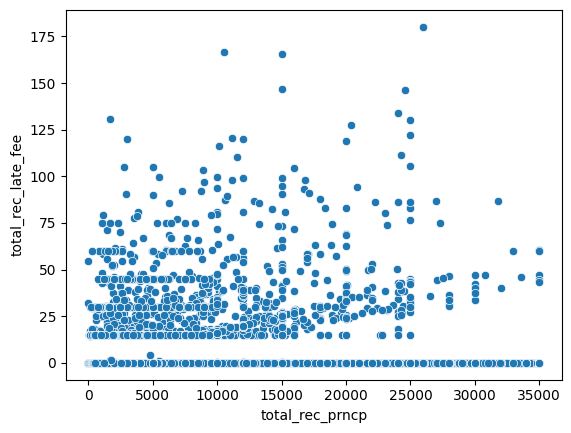

Creating Scatterplot for  total_rec_prncp vs recoveries


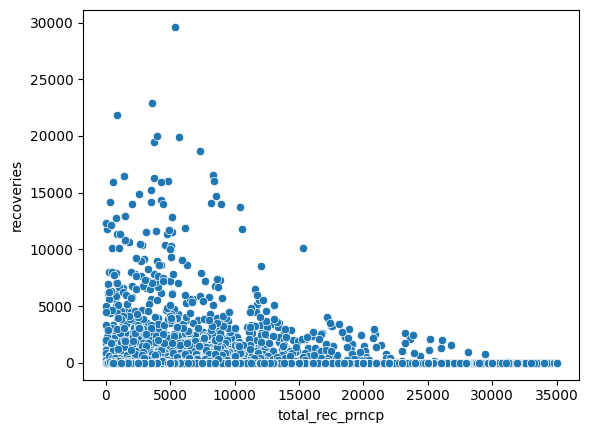

Creating Scatterplot for  total_rec_prncp vs collection_recovery_fee


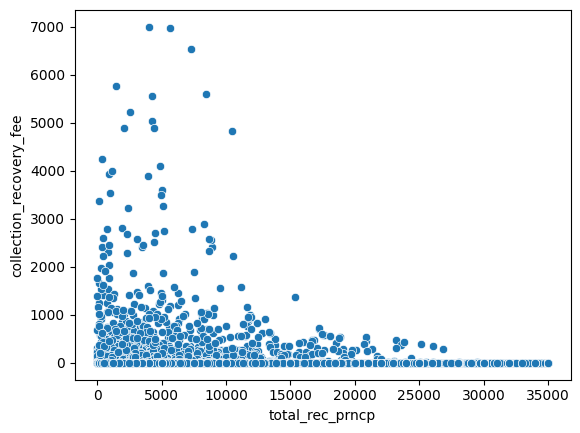

Creating Scatterplot for  total_rec_prncp vs last_pymnt_amnt


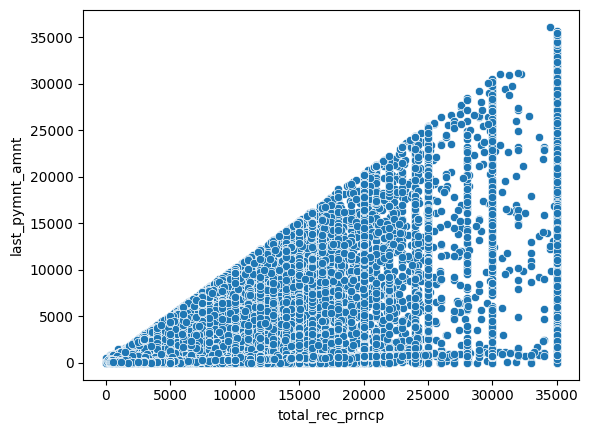

Creating Scatterplot for  total_rec_int vs loan_amnt


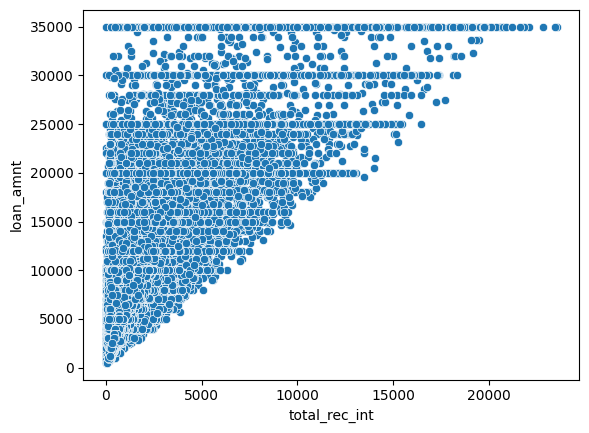

Creating Scatterplot for  total_rec_int vs funded_amnt


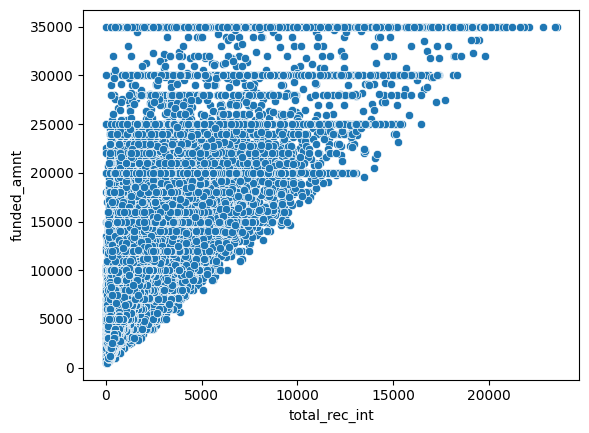

Creating Scatterplot for  total_rec_int vs funded_amnt_inv


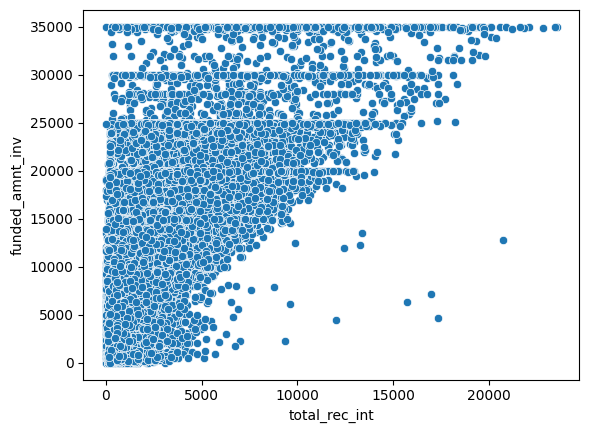

Creating Scatterplot for  total_rec_int vs int_rate


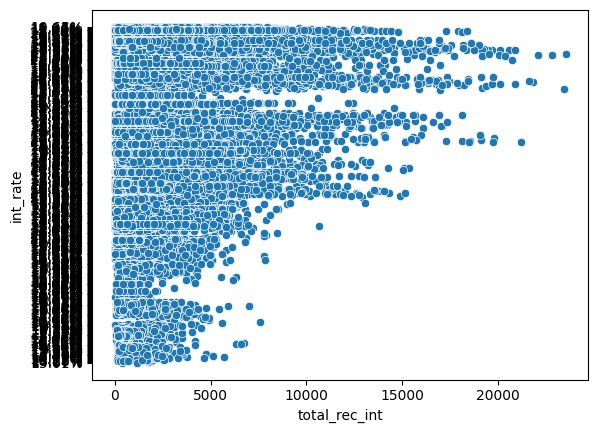

Creating Scatterplot for  total_rec_int vs installment


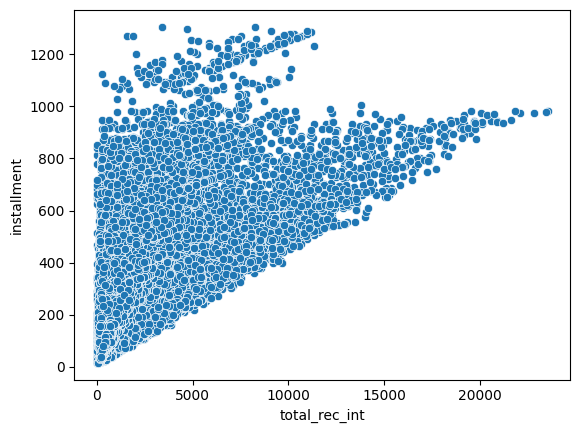

Creating Scatterplot for  total_rec_int vs annual_inc


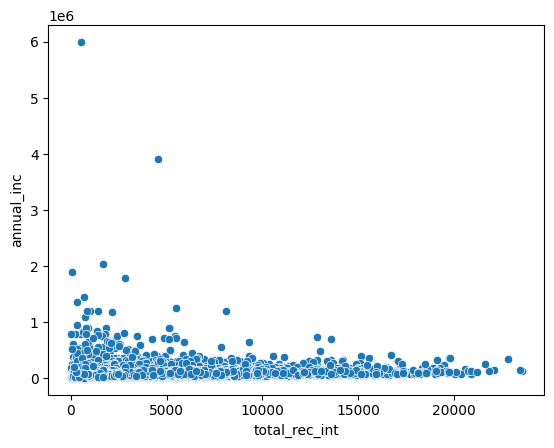

Creating Scatterplot for  total_rec_int vs dti


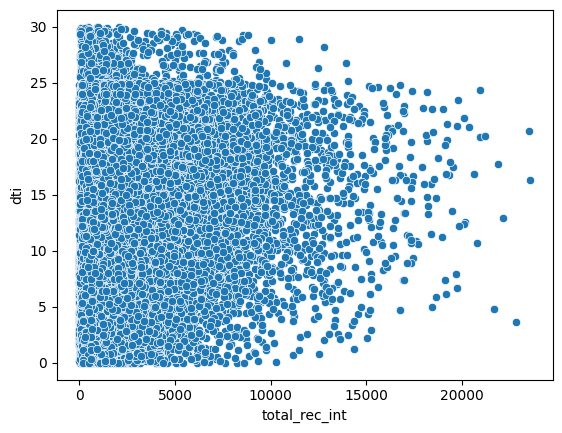

Creating Scatterplot for  total_rec_int vs revol_bal


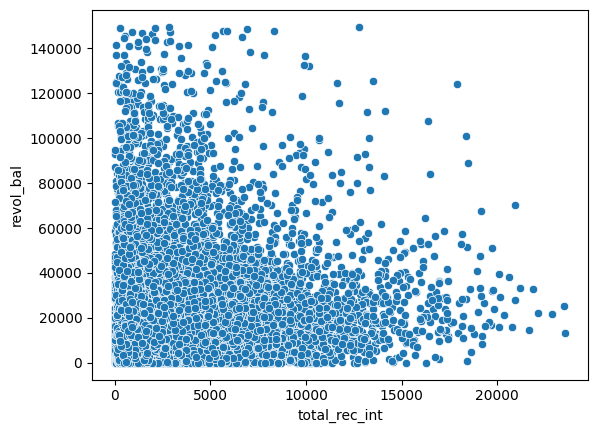

Creating Scatterplot for  total_rec_int vs revol_util


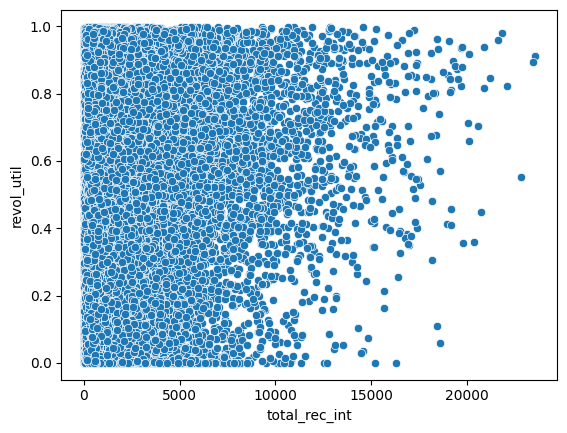

Creating Scatterplot for  total_rec_int vs total_pymnt


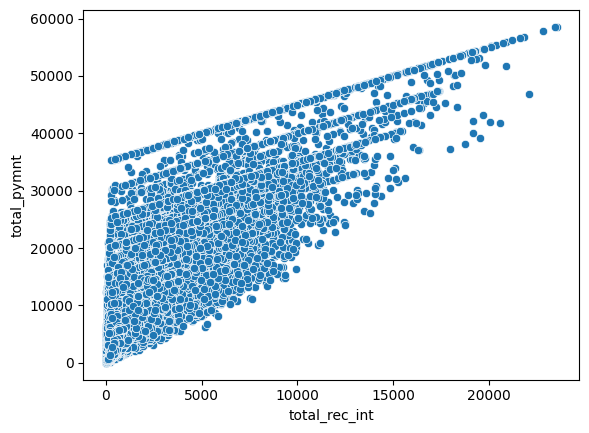

Creating Scatterplot for  total_rec_int vs total_pymnt_inv


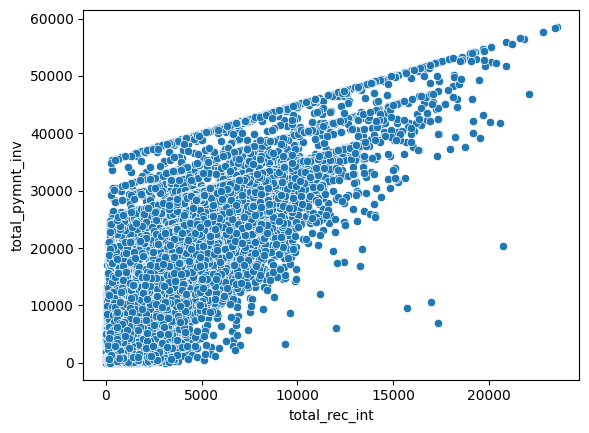

Creating Scatterplot for  total_rec_int vs total_rec_prncp


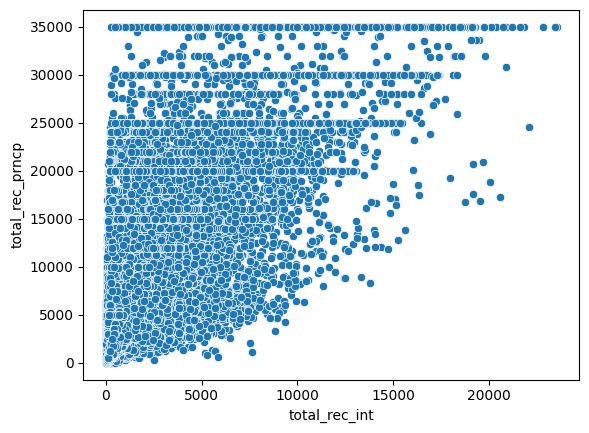

Creating Scatterplot for  total_rec_int vs total_rec_int


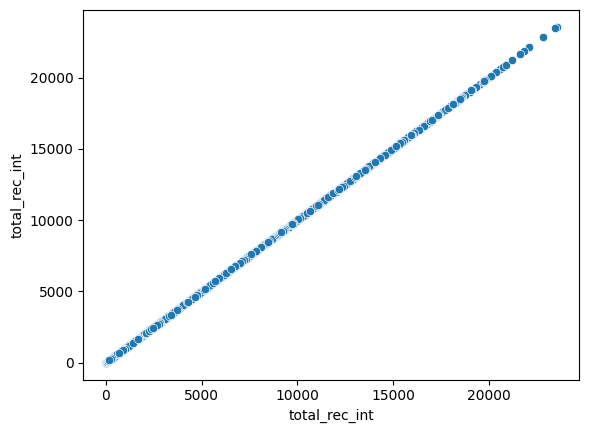

Creating Scatterplot for  total_rec_int vs total_rec_late_fee


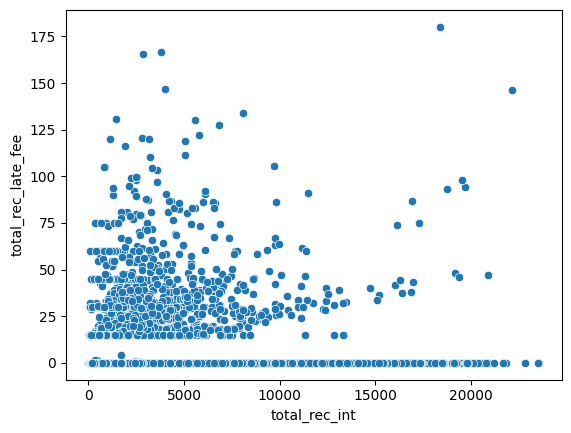

Creating Scatterplot for  total_rec_int vs recoveries


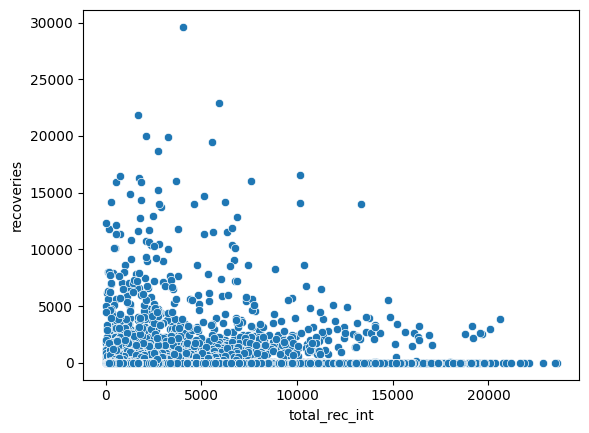

Creating Scatterplot for  total_rec_int vs collection_recovery_fee


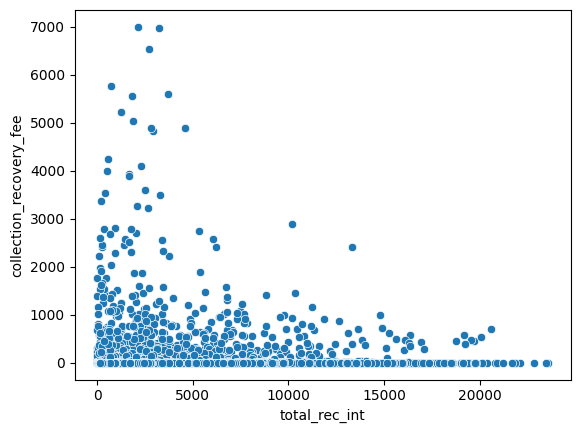

Creating Scatterplot for  total_rec_int vs last_pymnt_amnt


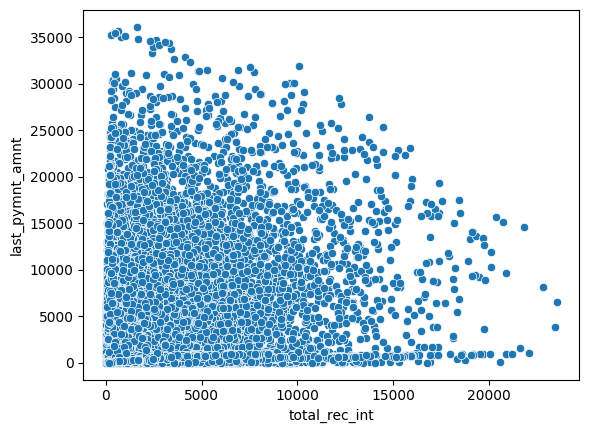

Creating Scatterplot for  total_rec_late_fee vs loan_amnt


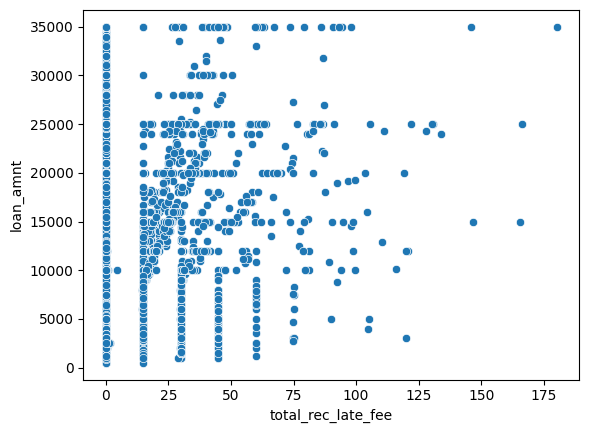

Creating Scatterplot for  total_rec_late_fee vs funded_amnt


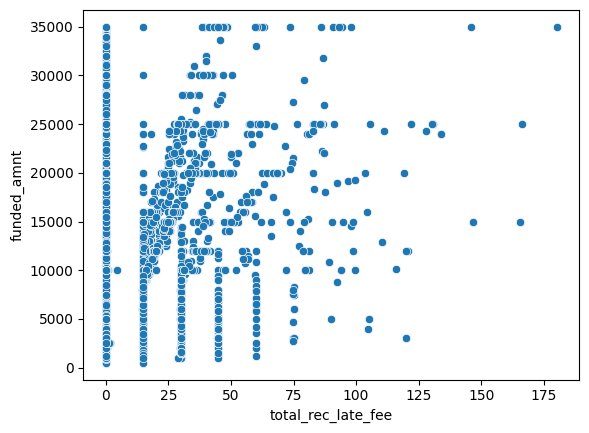

Creating Scatterplot for  total_rec_late_fee vs funded_amnt_inv


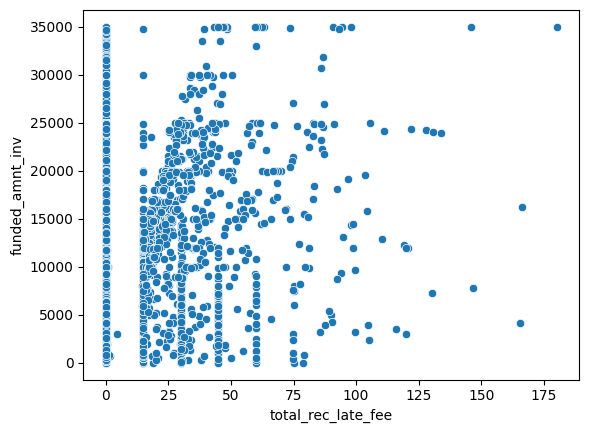

Creating Scatterplot for  total_rec_late_fee vs int_rate


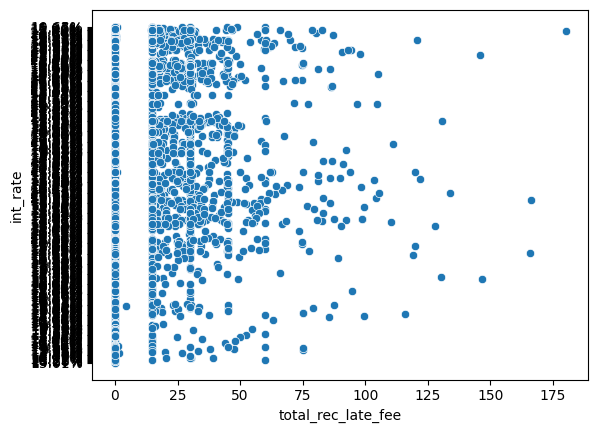

Creating Scatterplot for  total_rec_late_fee vs installment


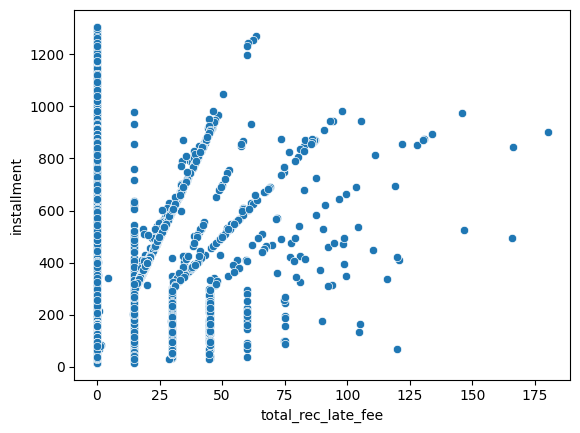

Creating Scatterplot for  total_rec_late_fee vs annual_inc


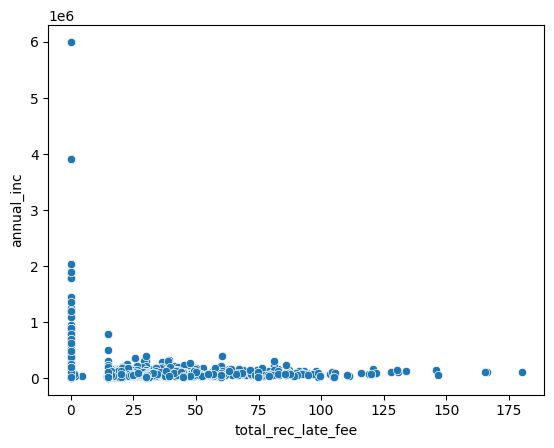

Creating Scatterplot for  total_rec_late_fee vs dti


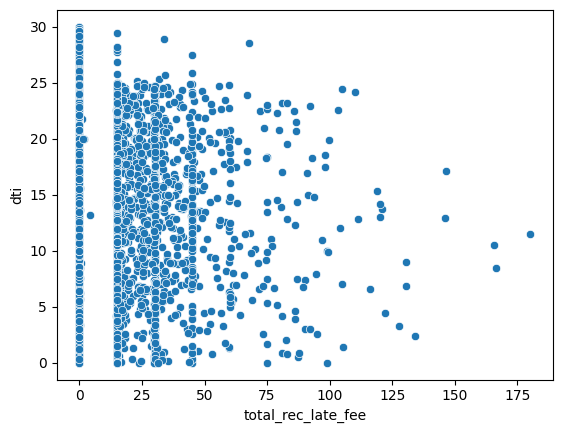

Creating Scatterplot for  total_rec_late_fee vs revol_bal


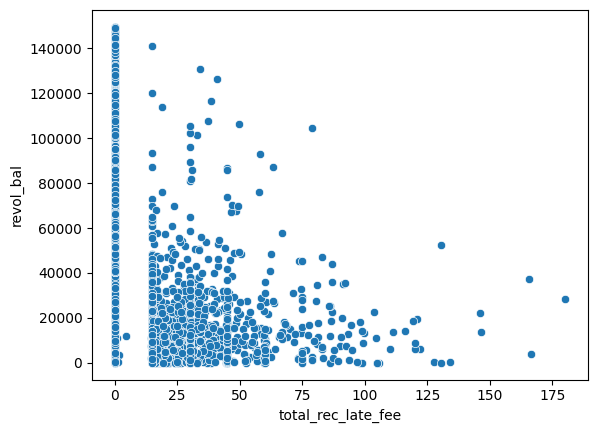

Creating Scatterplot for  total_rec_late_fee vs revol_util


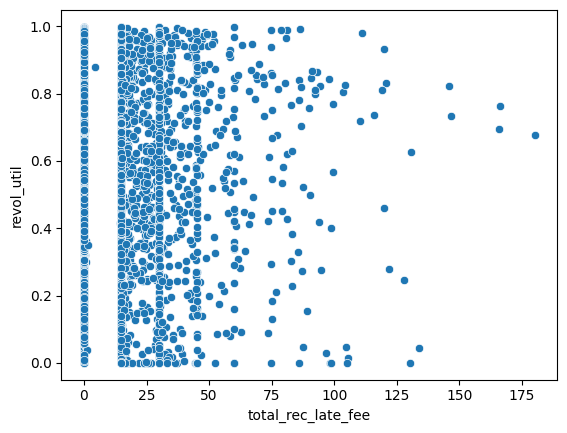

Creating Scatterplot for  total_rec_late_fee vs total_pymnt


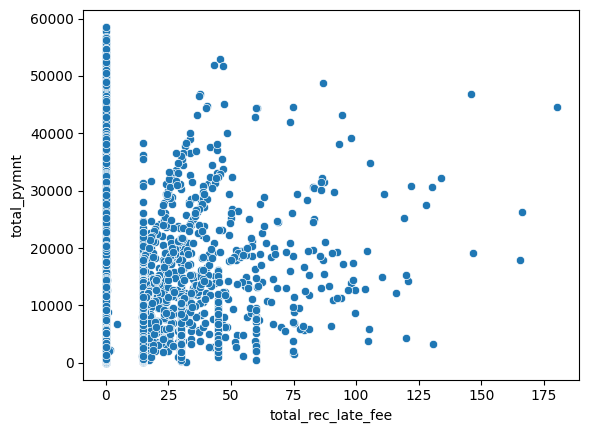

Creating Scatterplot for  total_rec_late_fee vs total_pymnt_inv


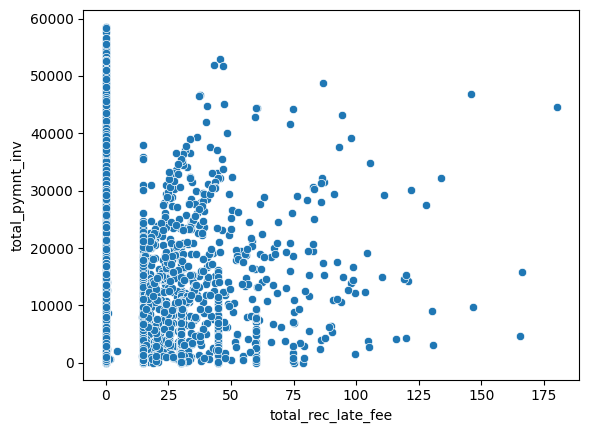

Creating Scatterplot for  total_rec_late_fee vs total_rec_prncp


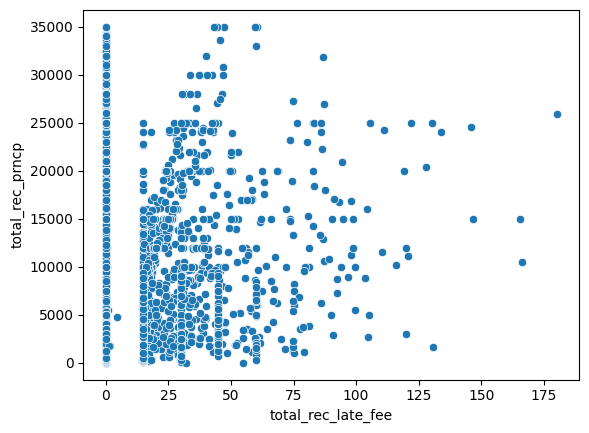

Creating Scatterplot for  total_rec_late_fee vs total_rec_int


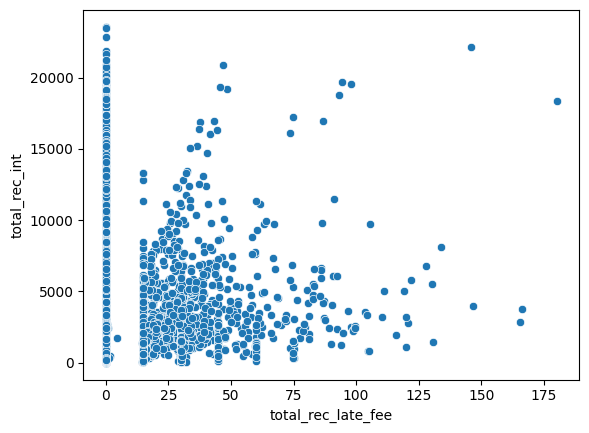

Creating Scatterplot for  total_rec_late_fee vs total_rec_late_fee


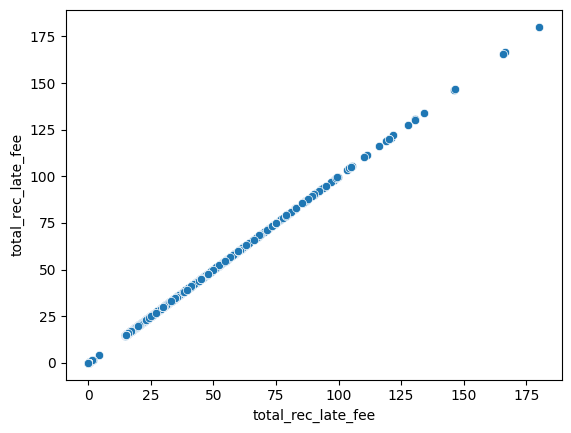

Creating Scatterplot for  total_rec_late_fee vs recoveries


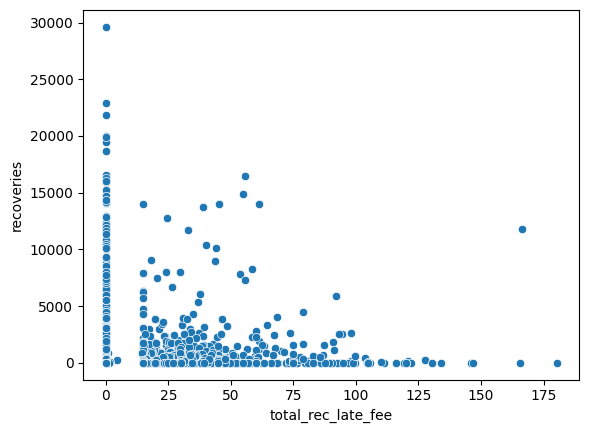

Creating Scatterplot for  total_rec_late_fee vs collection_recovery_fee


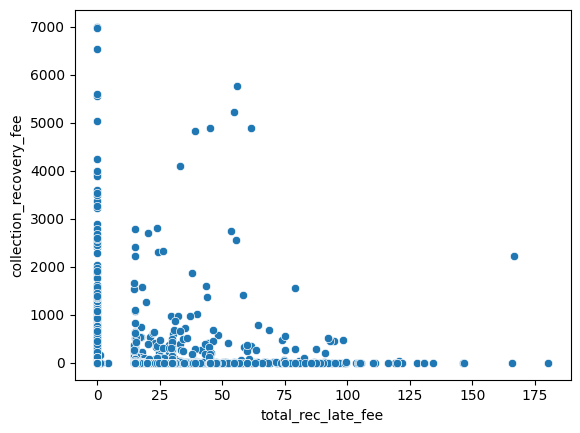

Creating Scatterplot for  total_rec_late_fee vs last_pymnt_amnt


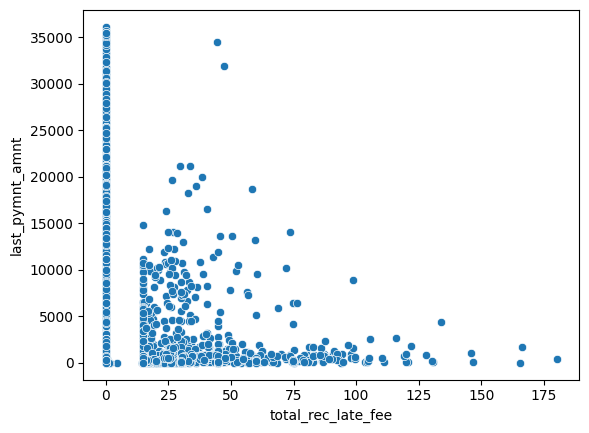

Creating Scatterplot for  recoveries vs loan_amnt


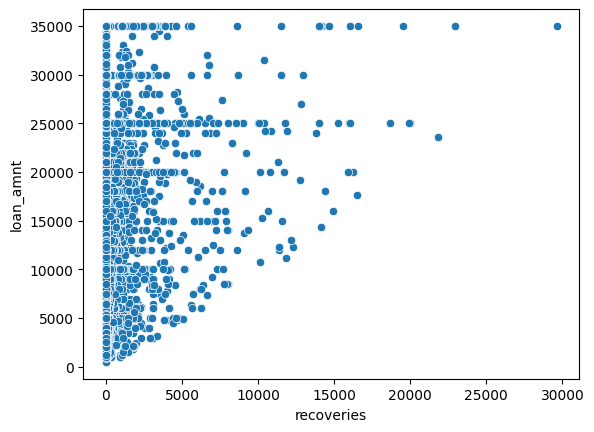

Creating Scatterplot for  recoveries vs funded_amnt


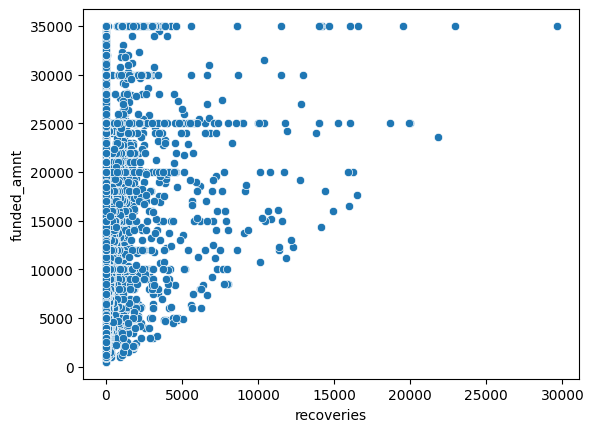

Creating Scatterplot for  recoveries vs funded_amnt_inv


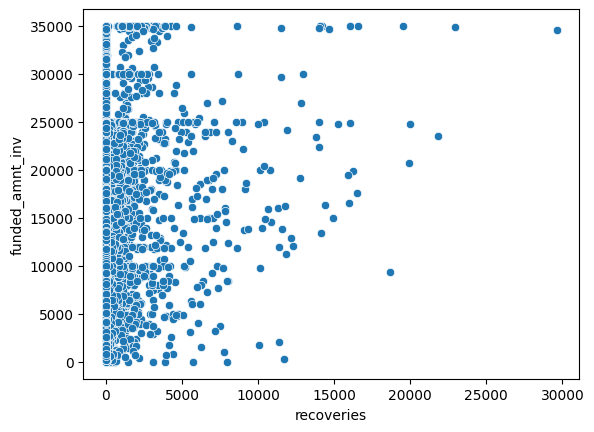

Creating Scatterplot for  recoveries vs int_rate


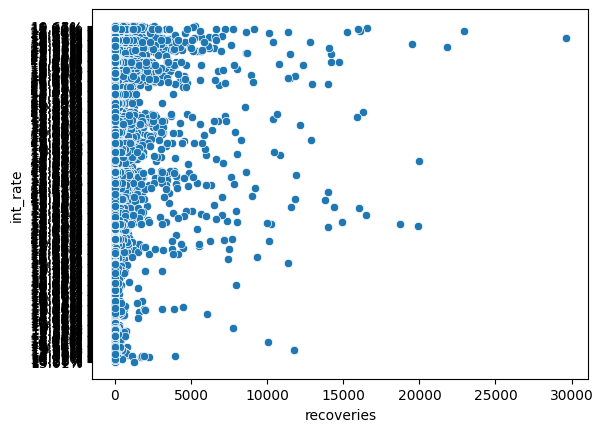

Creating Scatterplot for  recoveries vs installment


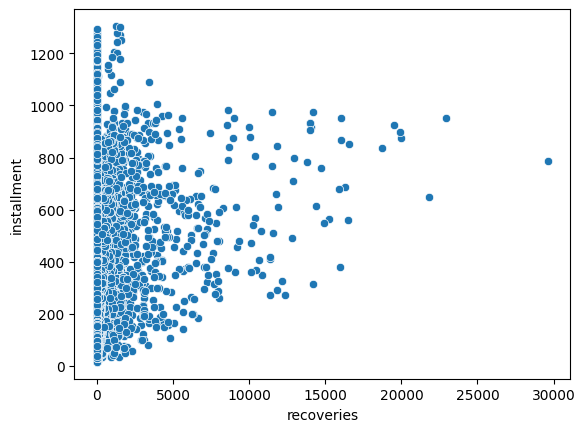

Creating Scatterplot for  recoveries vs annual_inc


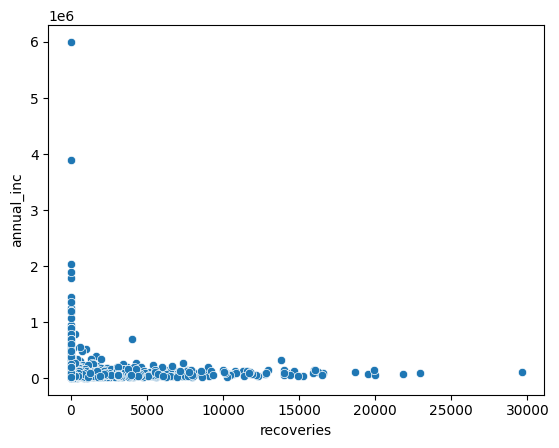

Creating Scatterplot for  recoveries vs dti


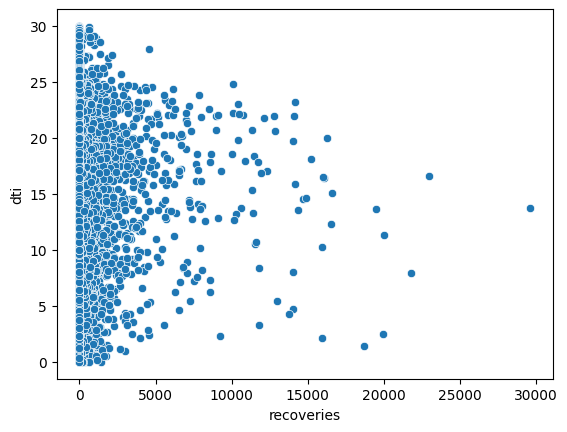

Creating Scatterplot for  recoveries vs revol_bal


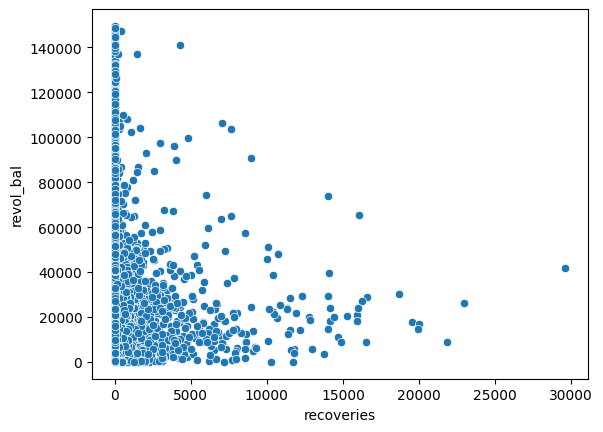

Creating Scatterplot for  recoveries vs revol_util


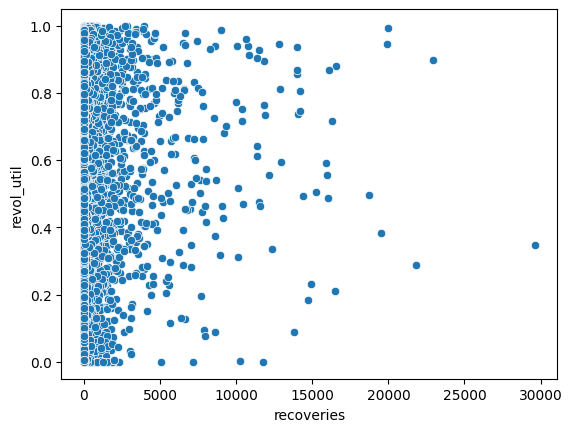

Creating Scatterplot for  recoveries vs total_pymnt


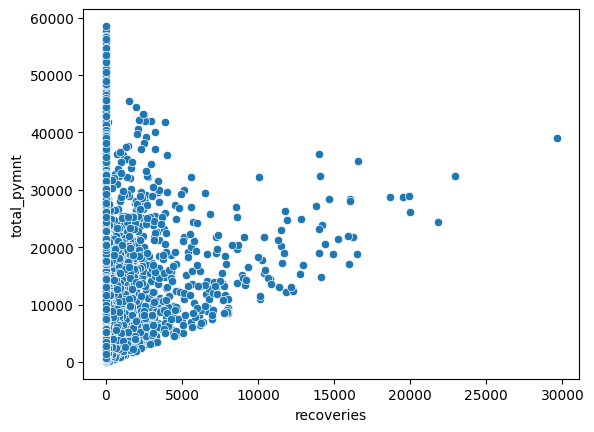

Creating Scatterplot for  recoveries vs total_pymnt_inv


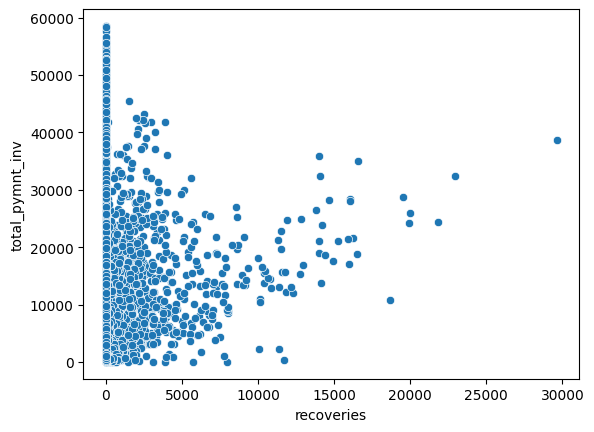

Creating Scatterplot for  recoveries vs total_rec_prncp


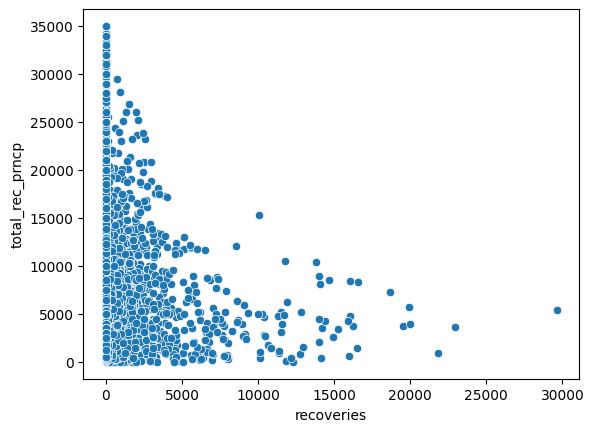

Creating Scatterplot for  recoveries vs total_rec_int


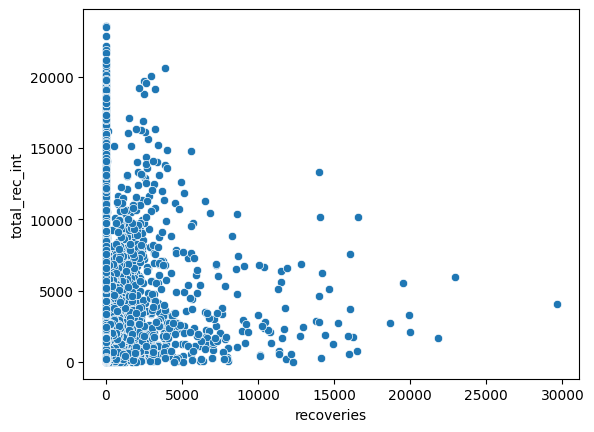

Creating Scatterplot for  recoveries vs total_rec_late_fee


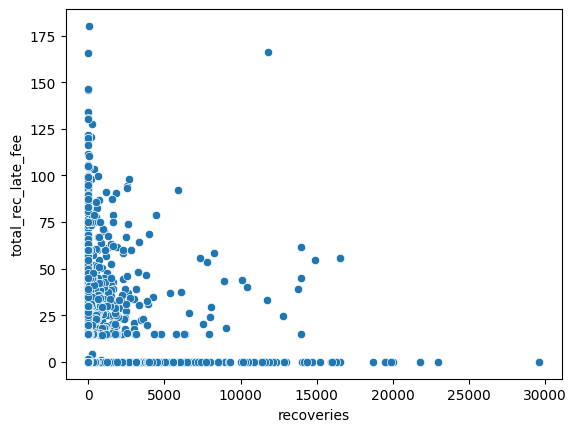

Creating Scatterplot for  recoveries vs recoveries


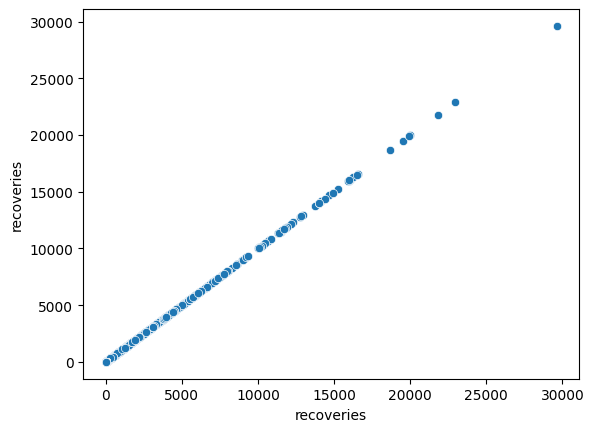

Creating Scatterplot for  recoveries vs collection_recovery_fee


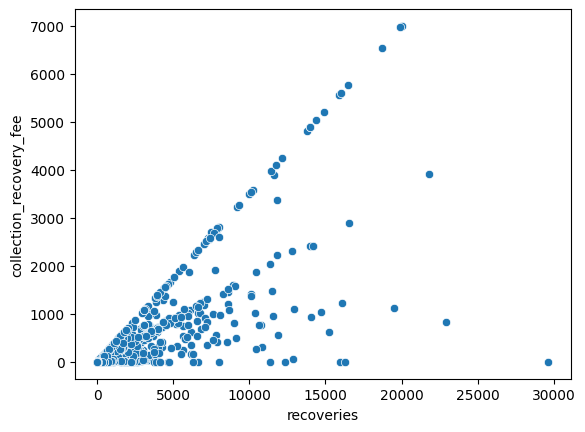

Creating Scatterplot for  recoveries vs last_pymnt_amnt


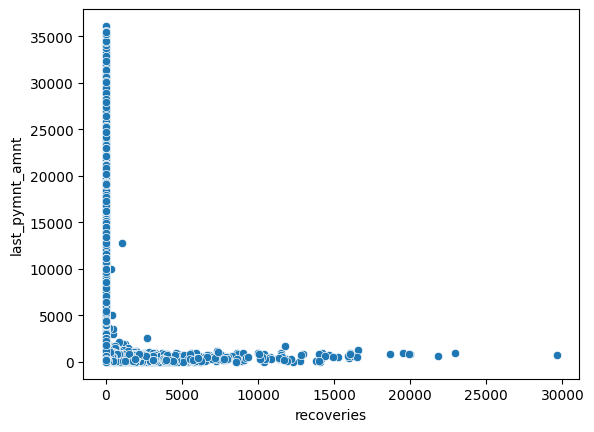

Creating Scatterplot for  collection_recovery_fee vs loan_amnt


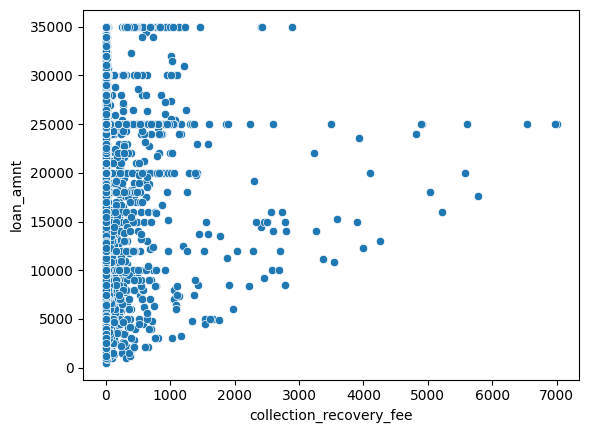

Creating Scatterplot for  collection_recovery_fee vs funded_amnt


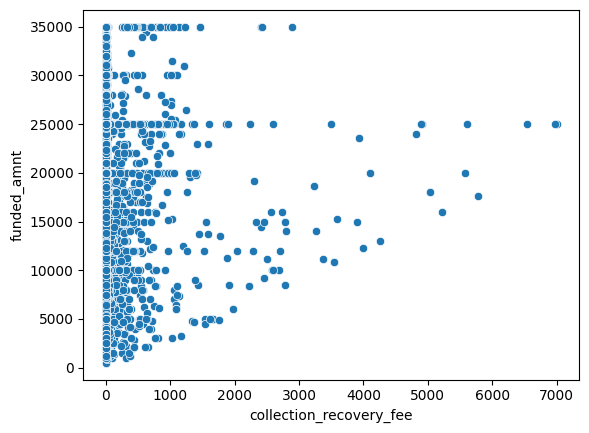

Creating Scatterplot for  collection_recovery_fee vs funded_amnt_inv


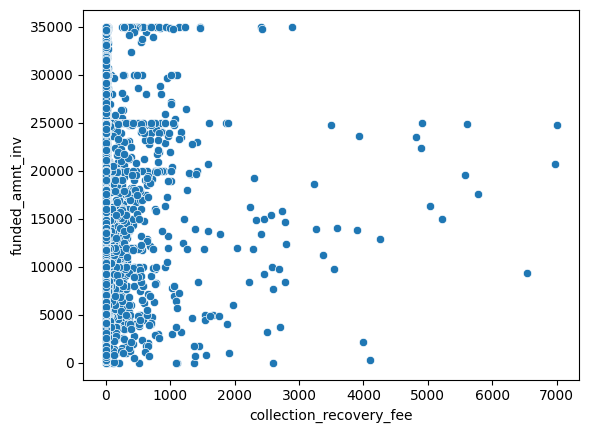

Creating Scatterplot for  collection_recovery_fee vs int_rate


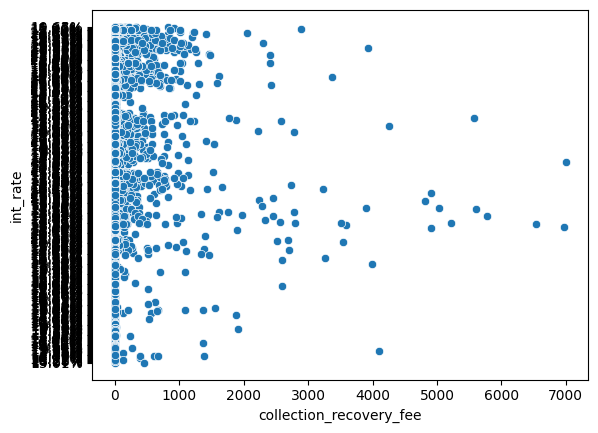

Creating Scatterplot for  collection_recovery_fee vs installment


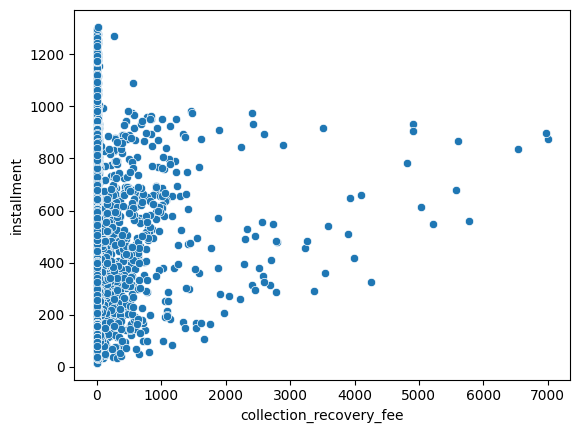

Creating Scatterplot for  collection_recovery_fee vs annual_inc


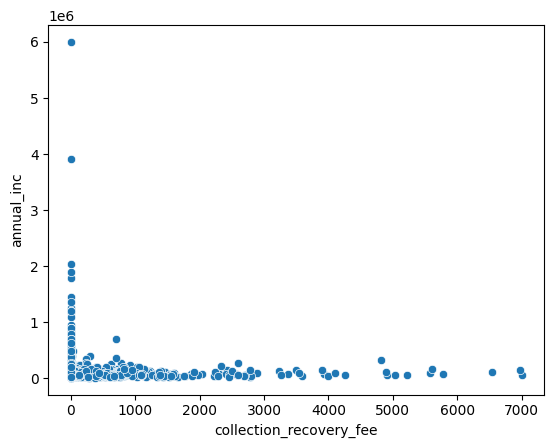

Creating Scatterplot for  collection_recovery_fee vs dti


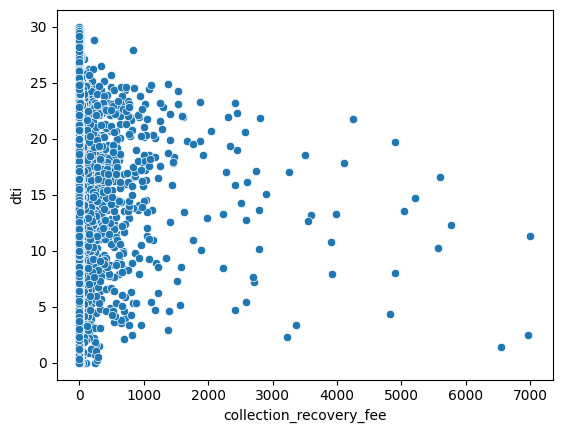

Creating Scatterplot for  collection_recovery_fee vs revol_bal


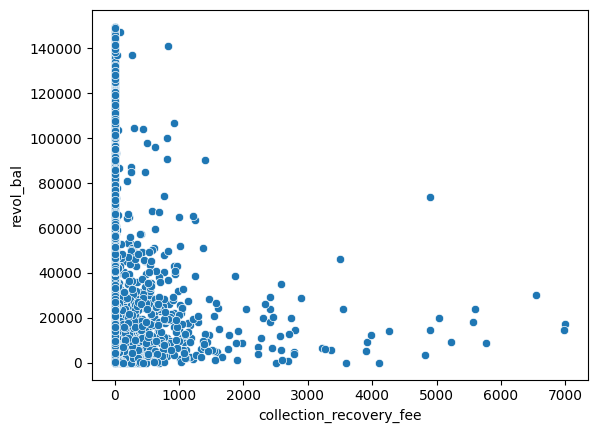

Creating Scatterplot for  collection_recovery_fee vs revol_util


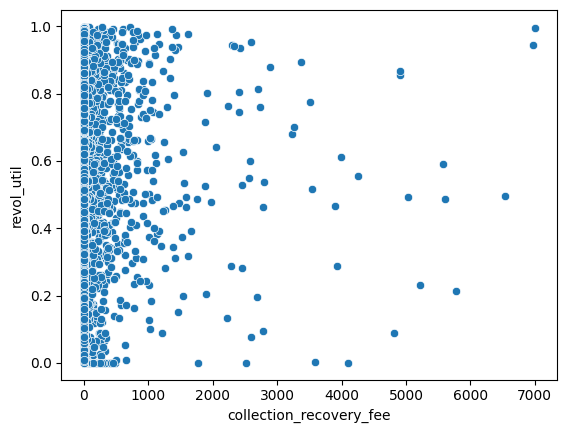

Creating Scatterplot for  collection_recovery_fee vs total_pymnt


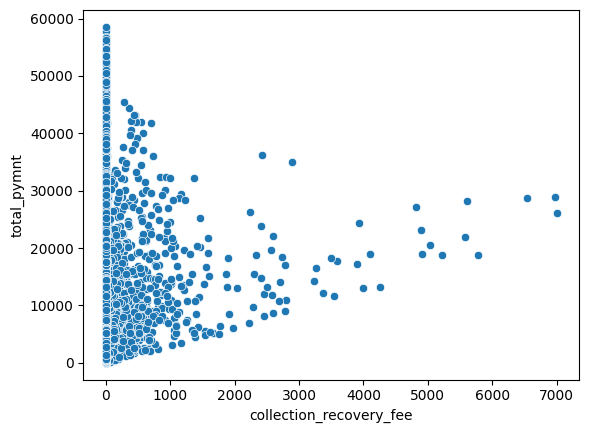

Creating Scatterplot for  collection_recovery_fee vs total_pymnt_inv


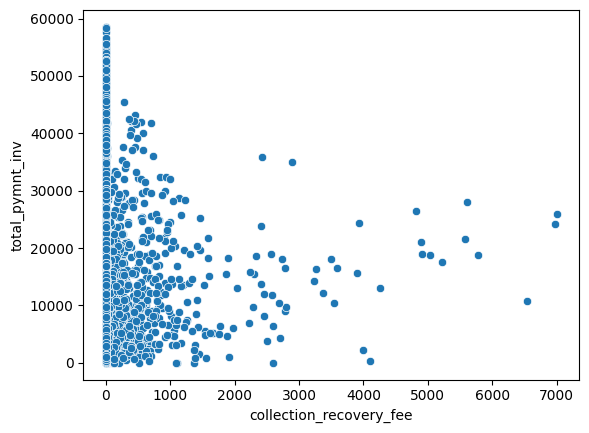

Creating Scatterplot for  collection_recovery_fee vs total_rec_prncp


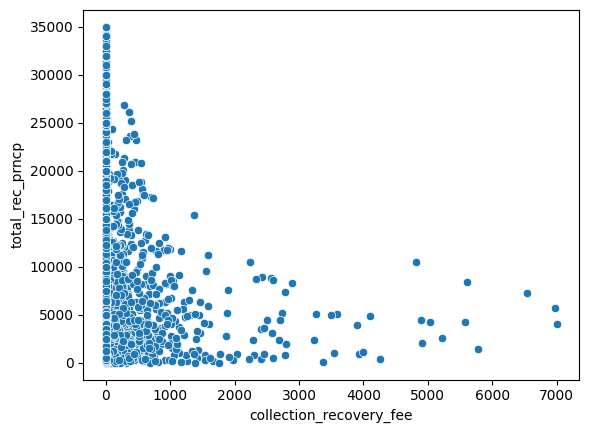

Creating Scatterplot for  collection_recovery_fee vs total_rec_int


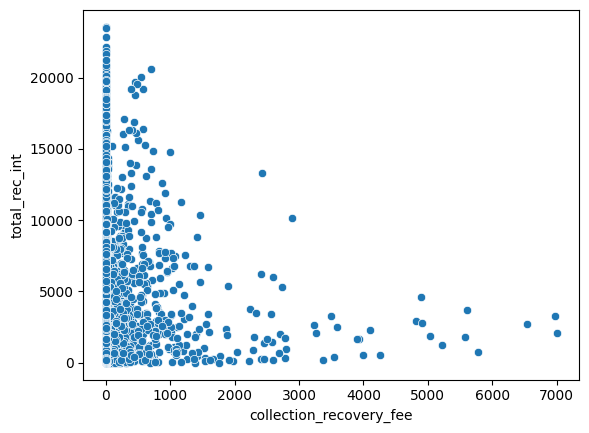

Creating Scatterplot for  collection_recovery_fee vs total_rec_late_fee


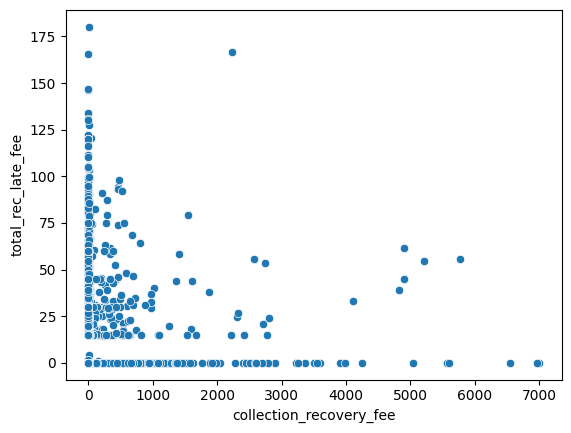

Creating Scatterplot for  collection_recovery_fee vs recoveries


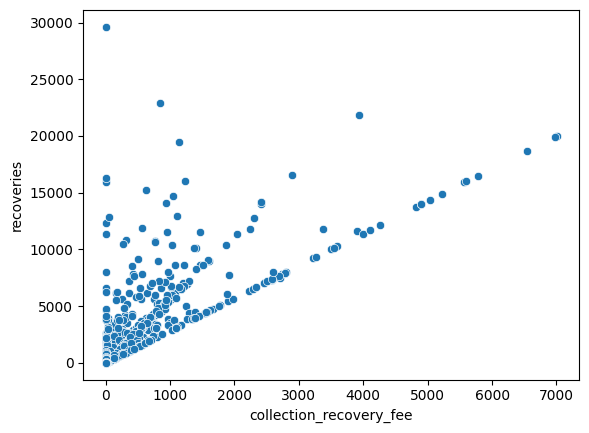

Creating Scatterplot for  collection_recovery_fee vs collection_recovery_fee


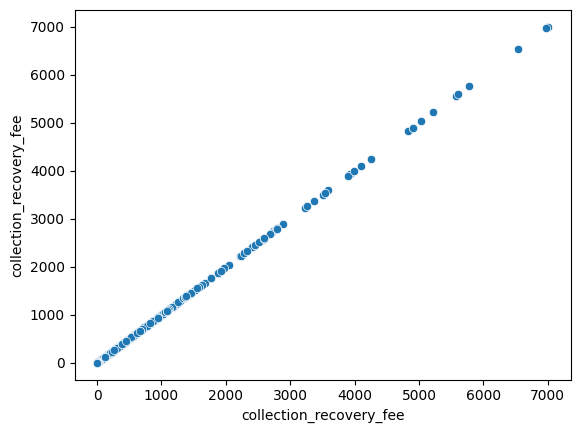

Creating Scatterplot for  collection_recovery_fee vs last_pymnt_amnt


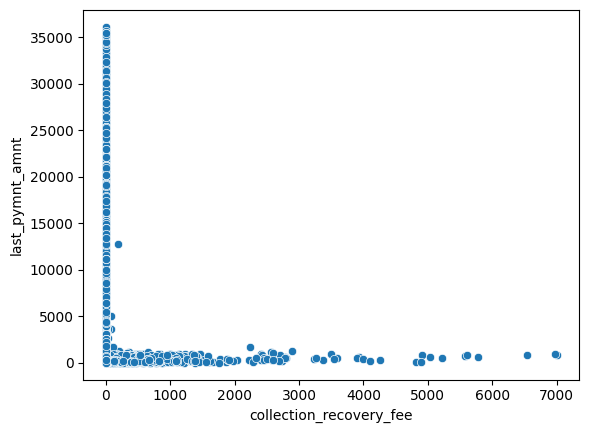

Creating Scatterplot for  last_pymnt_amnt vs loan_amnt


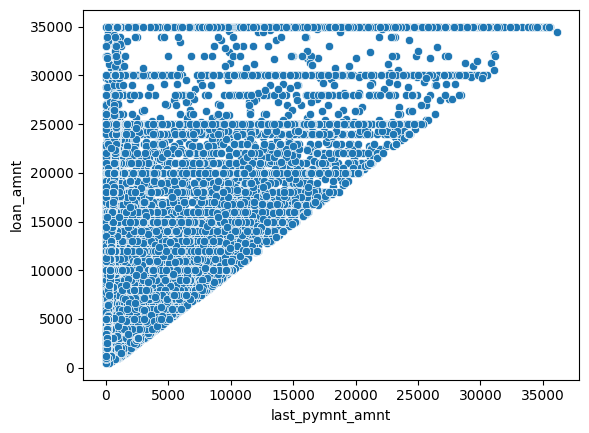

Creating Scatterplot for  last_pymnt_amnt vs funded_amnt


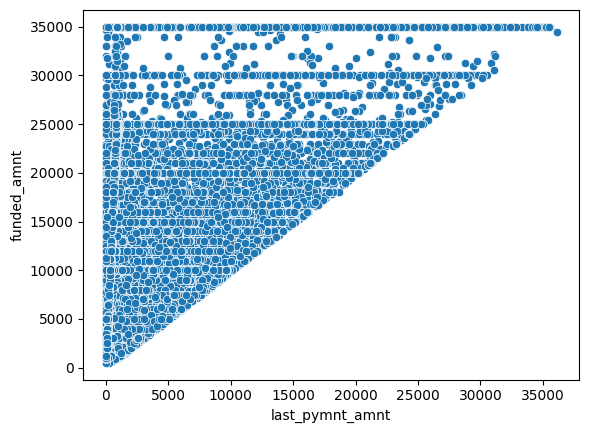

Creating Scatterplot for  last_pymnt_amnt vs funded_amnt_inv


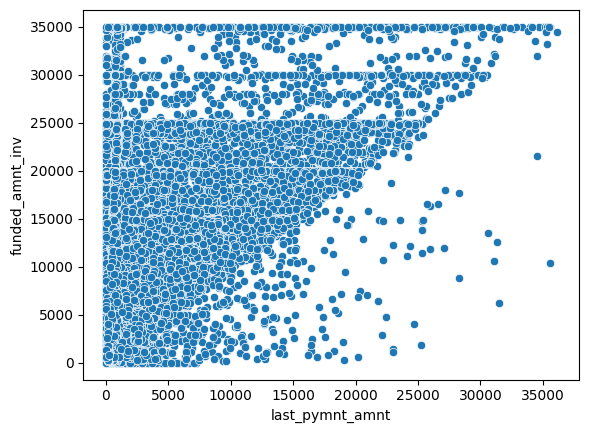

Creating Scatterplot for  last_pymnt_amnt vs int_rate


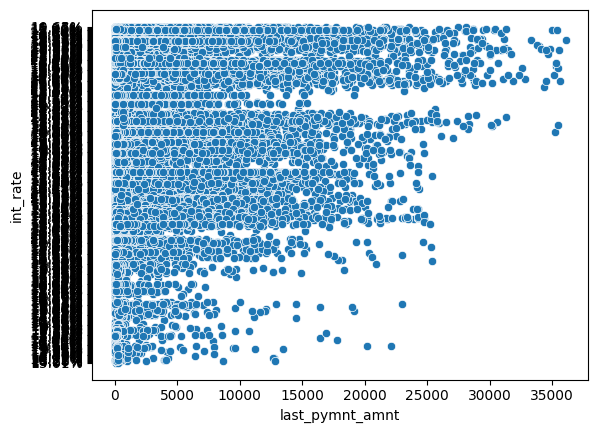

Creating Scatterplot for  last_pymnt_amnt vs installment


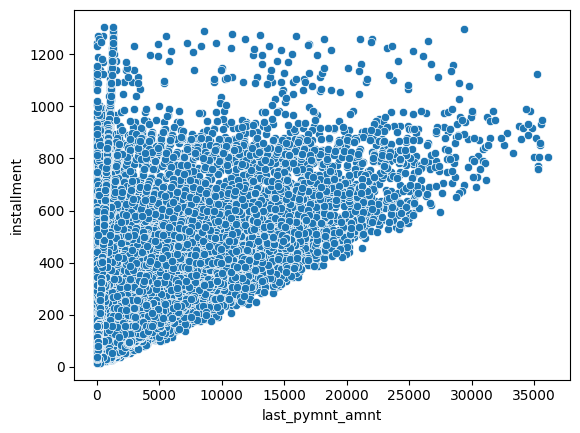

Creating Scatterplot for  last_pymnt_amnt vs annual_inc


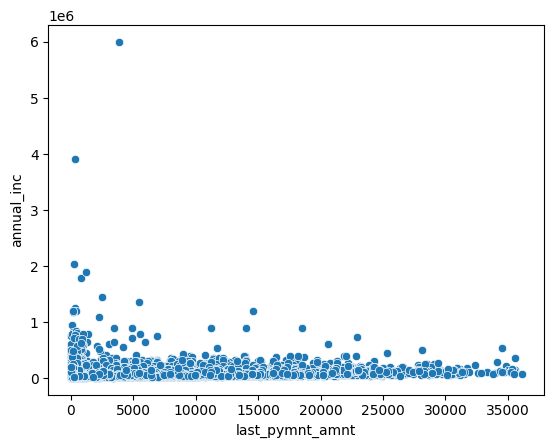

Creating Scatterplot for  last_pymnt_amnt vs dti


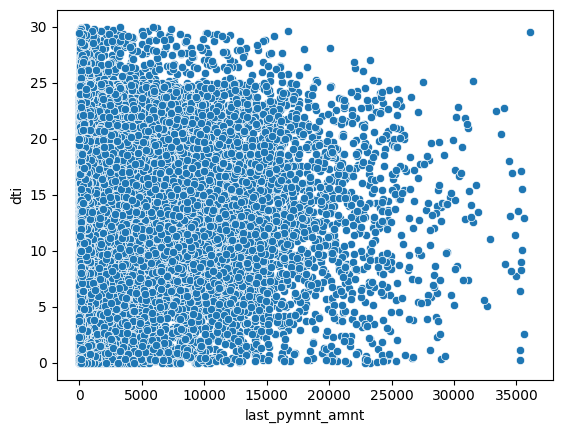

Creating Scatterplot for  last_pymnt_amnt vs revol_bal


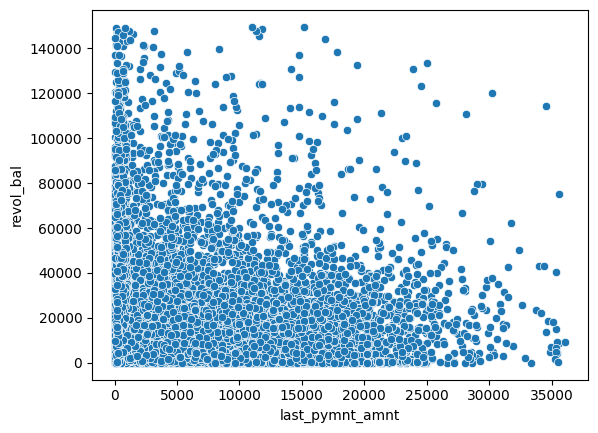

Creating Scatterplot for  last_pymnt_amnt vs revol_util


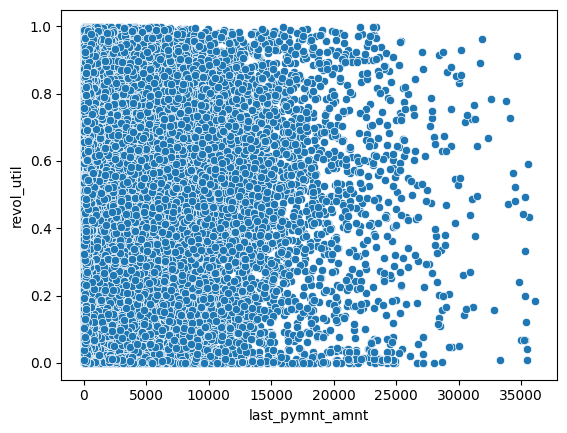

Creating Scatterplot for  last_pymnt_amnt vs total_pymnt


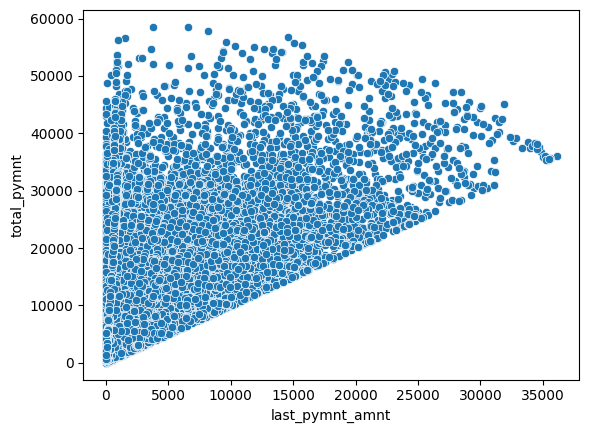

Creating Scatterplot for  last_pymnt_amnt vs total_pymnt_inv


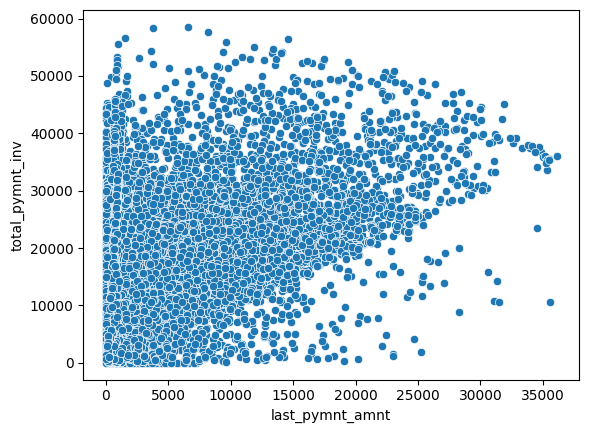

Creating Scatterplot for  last_pymnt_amnt vs total_rec_prncp


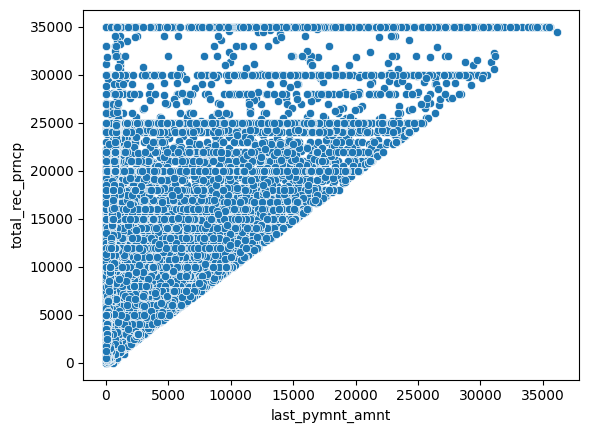

Creating Scatterplot for  last_pymnt_amnt vs total_rec_int


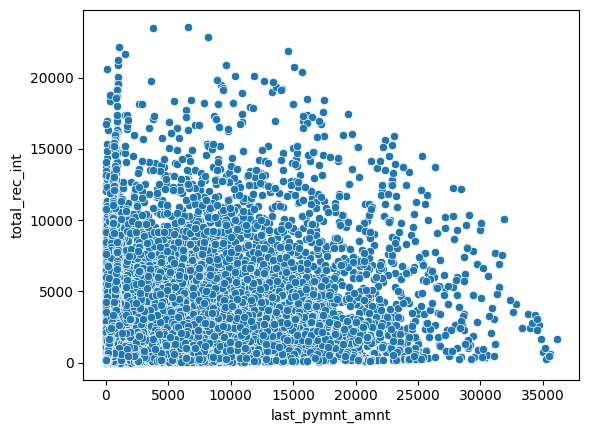

Creating Scatterplot for  last_pymnt_amnt vs total_rec_late_fee


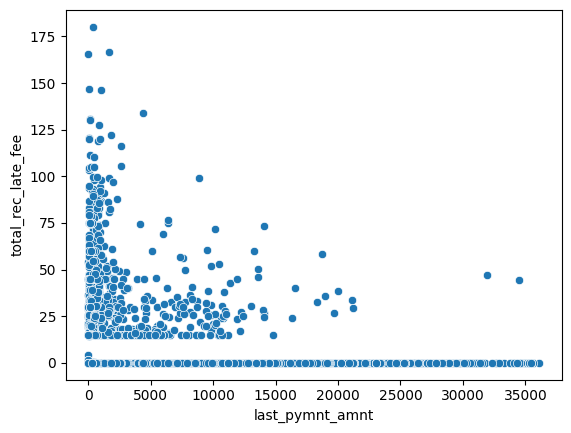

Creating Scatterplot for  last_pymnt_amnt vs recoveries


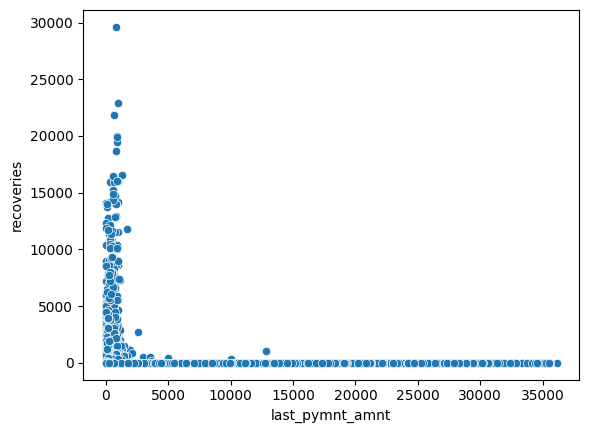

Creating Scatterplot for  last_pymnt_amnt vs collection_recovery_fee


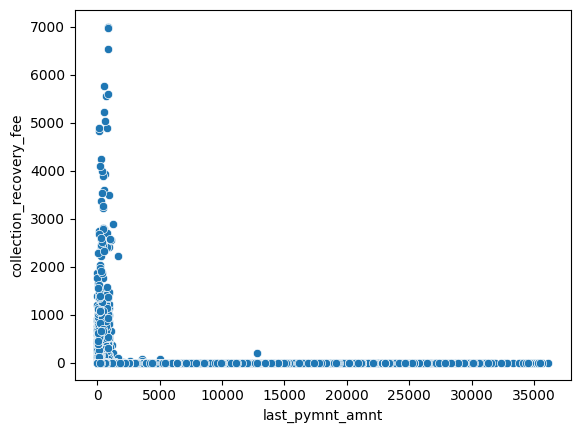

Creating Scatterplot for  last_pymnt_amnt vs last_pymnt_amnt


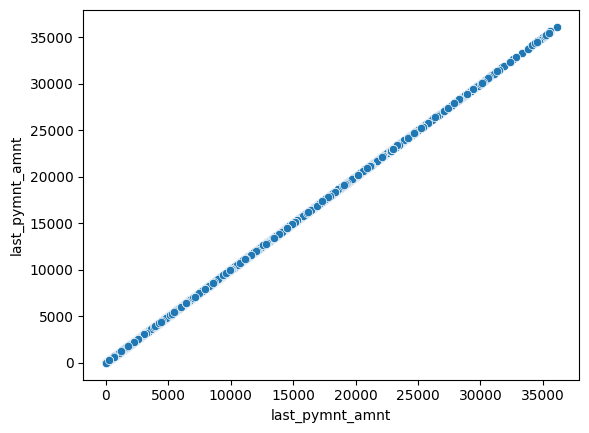

In [18]:
# Bivariate Analysis for Numerical Columns

for num in num_cols:
  for num_var in num_cols:
    print('Creating Scatterplot for ', num, 'vs', num_var)
    sns.scatterplot(x = df[num], y = df[num_var])
    plt.show()

Creating Boxplot for  term vs Loan Status
term
 36 months    29096
 60 months     9481
Name: count, dtype: int64


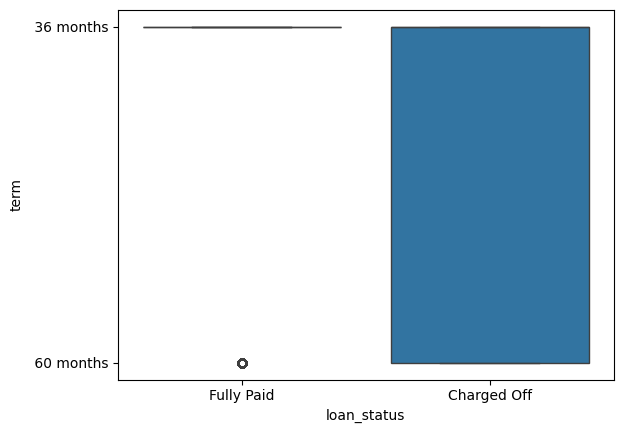

Creating Boxplot for  grade vs Loan Status
grade
B    11675
A    10045
C     7834
D     5085
E     2663
F      976
G      299
Name: count, dtype: int64


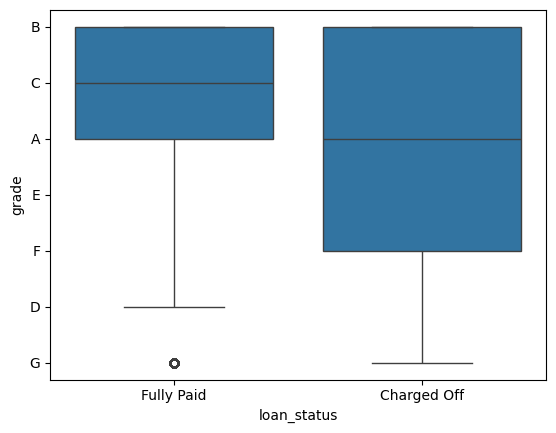

Creating Boxplot for  sub_grade vs Loan Status
sub_grade
A4    2873
B3    2825
A5    2715
B5    2615
B4    2437
C1    2055
B2    2001
C2    1931
A3    1810
B1    1797
A2    1508
C3    1488
D2    1286
C4    1206
C5    1154
A1    1139
D3    1116
D1     931
D4     918
D5     834
E1     722
E2     614
E3     516
E4     424
E5     387
F1     305
F2     233
F3     174
F4     151
F5     113
G1      94
G2      77
G4      54
G3      45
G5      29
Name: count, dtype: int64


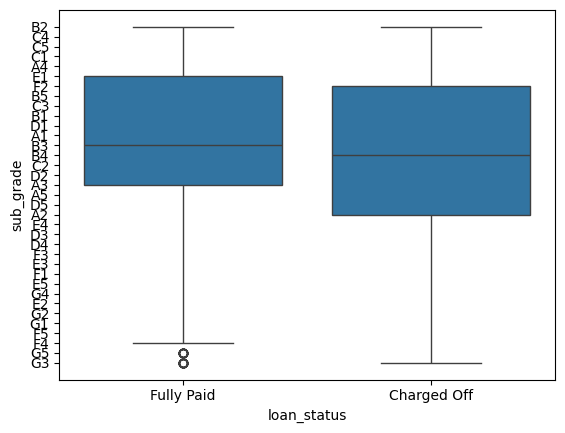

Creating Boxplot for  emp_length vs Loan Status
emp_length
10+     9521
< 1     4508
2       4291
3       4012
4       3342
5       3194
1       3169
6       2168
7       1711
8       1435
9       1226
Name: count, dtype: int64


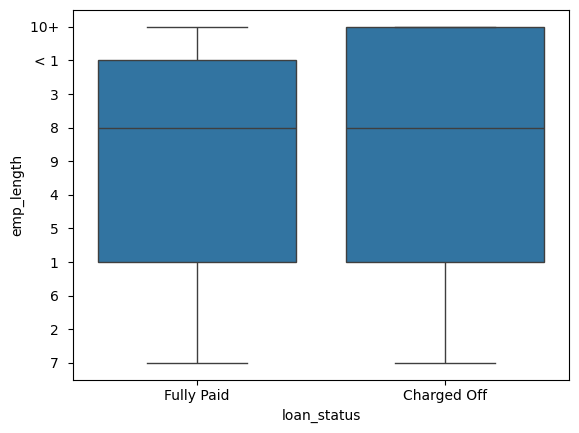

Creating Boxplot for  home_ownership vs Loan Status
home_ownership
RENT        18480
MORTGAGE    17021
OWN          2975
OTHER          98
NONE            3
Name: count, dtype: int64


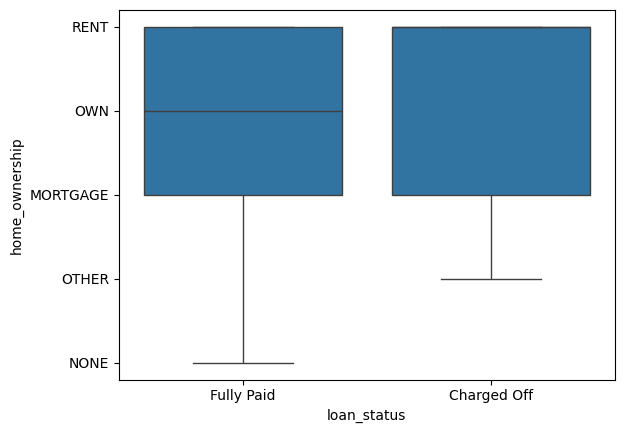

Creating Boxplot for  verification_status vs Loan Status
verification_status
Not Verified       16694
Verified           12206
Source Verified     9677
Name: count, dtype: int64


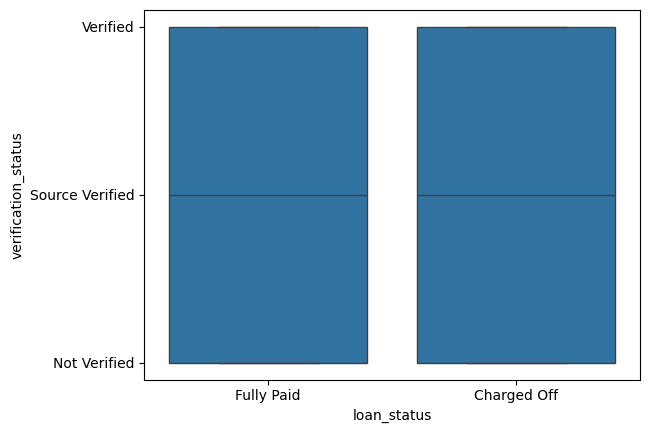

Creating Boxplot for  loan_status vs Loan Status
loan_status
Fully Paid     32950
Charged Off     5627
Name: count, dtype: int64


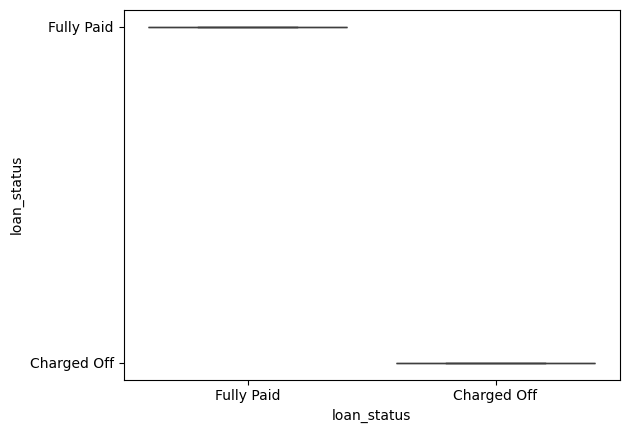

Creating Boxplot for  purpose vs Loan Status
purpose
debt_consolidation    18055
credit_card            5027
other                  3865
home_improvement       2875
major_purchase         2150
small_business         1754
car                    1499
wedding                 926
medical                 681
moving                  576
vacation                375
house                   367
educational             325
renewable_energy        102
Name: count, dtype: int64


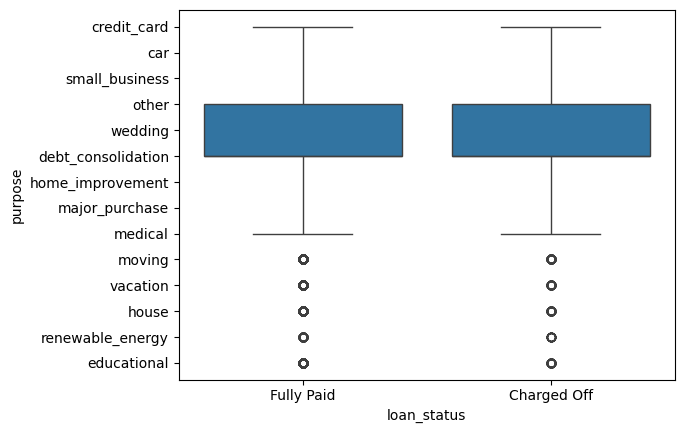

Creating Boxplot for  zip_code vs Loan Status
zip_code
100xx    583
945xx    531
112xx    502
606xx    493
070xx    455
900xx    446
021xx    383
300xx    383
926xx    366
750xx    356
941xx    355
921xx    341
917xx    340
331xx    337
770xx    316
117xx    293
113xx    274
852xx    267
913xx    265
330xx    249
891xx    242
080xx    235
925xx    232
334xx    229
902xx    229
201xx    223
920xx    221
951xx    219
980xx    217
303xx    217
200xx    211
104xx    205
928xx    202
923xx    200
301xx    195
940xx    195
950xx    193
802xx    193
212xx    184
554xx    184
600xx    183
956xx    182
088xx    181
773xx    181
191xx    180
787xx    177
207xx    175
850xx    174
752xx    174
604xx    169
328xx    169
981xx    167
601xx    167
853xx    159
333xx    159
190xx    150
060xx    149
064xx    149
208xx    149
958xx    146
481xx    145
327xx    143
774xx    142
210xx    140
028xx    137
114xx    132
432xx    132
760xx    132
018xx    130
890xx    129
336xx    128
800xx    126
152xx    

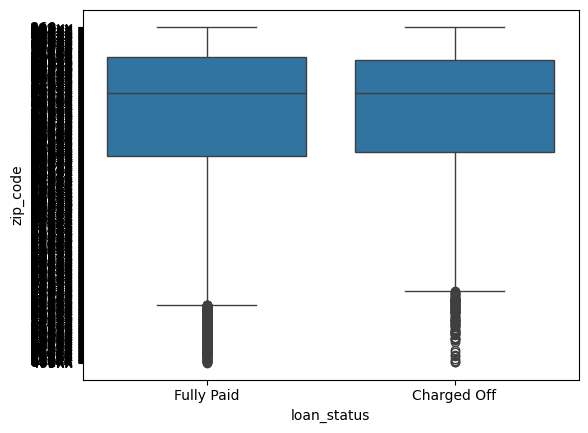

Creating Boxplot for  addr_state vs Loan Status
addr_state
CA    6949
NY    3698
FL    2781
TX    2659
NJ    1790
IL    1478
PA    1468
VA    1369
GA    1359
MA    1297
OH    1178
MD    1023
AZ     849
WA     818
CO     766
NC     750
CT     726
MI     704
MO     670
MN     605
NV     479
SC     459
WI     440
AL     435
OR     435
LA     427
KY     311
OK     287
KS     255
UT     252
AR     235
DC     211
RI     194
NM     183
WV     172
NH     166
HI     166
DE     113
MT      83
WY      80
AK      78
SD      62
VT      53
MS      19
TN      17
IN       9
ID       6
IA       5
NE       5
ME       3
Name: count, dtype: int64


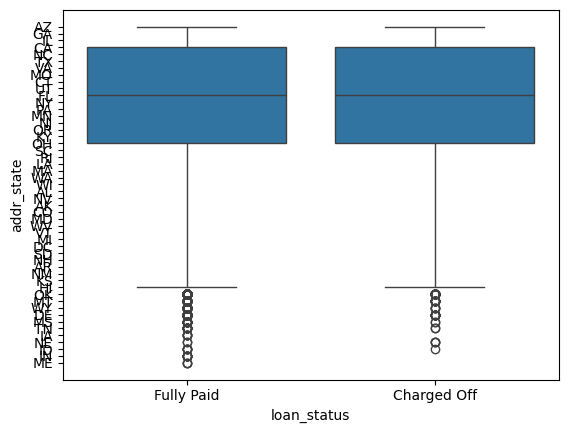

Creating Boxplot for  delinq_2yrs vs Loan Status
delinq_2yrs
0     34386
1      3207
2       673
3       212
4        60
5        21
6        10
7         4
8         2
9         1
11        1
Name: count, dtype: int64


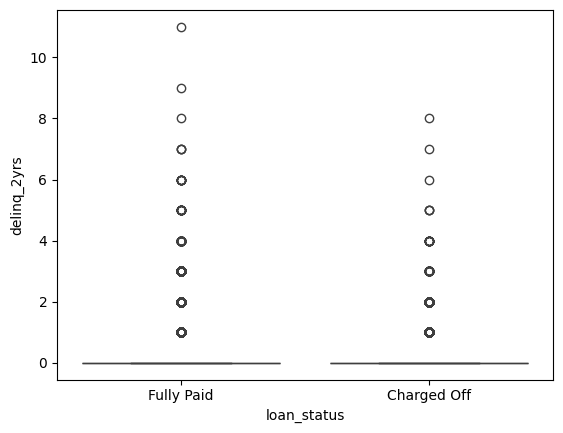

Creating Boxplot for  inq_last_6mths vs Loan Status
inq_last_6mths
0    18709
1    10660
2     5654
3     2983
4      316
5      144
6       63
7       34
8       14
Name: count, dtype: int64


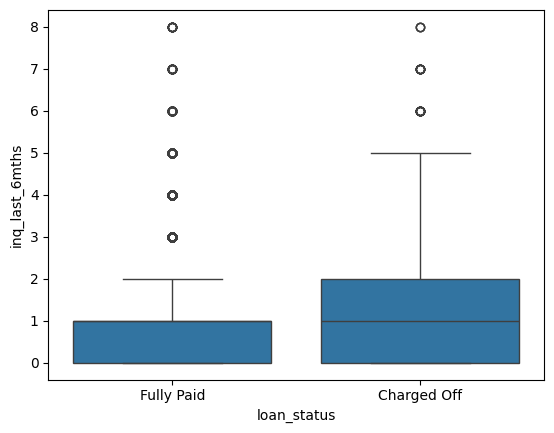

Creating Boxplot for  open_acc vs Loan Status
open_acc
7     3909
6     3846
8     3814
9     3607
5     3111
10    3097
11    2666
4     2300
12    2198
13    1855
3     1470
14    1427
15    1146
16     908
17     716
2      596
18     516
19     384
20     281
21     235
22     137
23      93
24      75
25      53
26      34
28      24
27      22
30      15
29      13
31       7
34       5
35       4
32       3
33       3
36       2
39       1
38       1
44       1
41       1
42       1
Name: count, dtype: int64


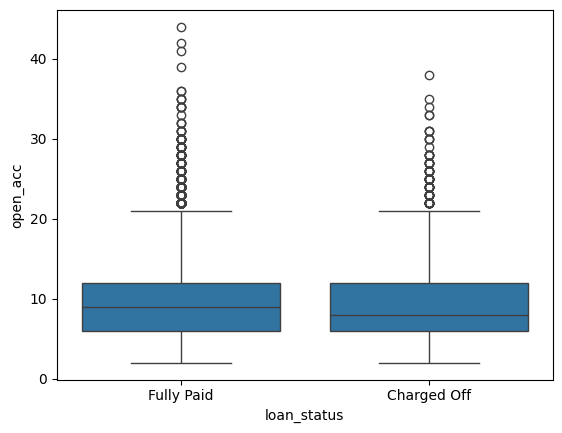

Creating Boxplot for  pub_rec vs Loan Status
pub_rec
0    36507
1     2013
2       48
3        7
4        2
Name: count, dtype: int64


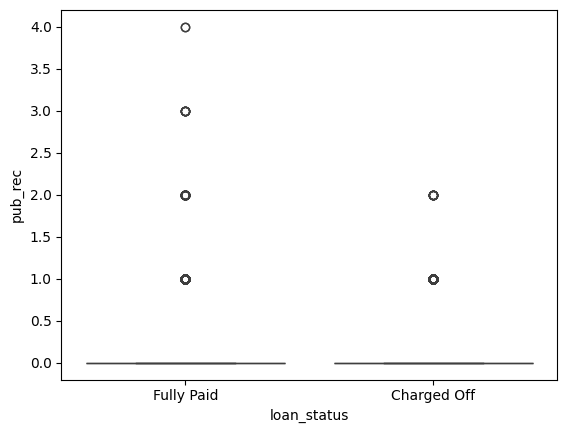

Creating Boxplot for  total_acc vs Loan Status
total_acc
16    1424
15    1418
17    1411
14    1403
20    1390
18    1379
13    1366
21    1356
19    1303
12    1291
22    1256
11    1241
24    1221
23    1211
10    1172
25    1116
9     1056
27    1051
26    1026
8      989
28     945
29     894
30     846
7      813
31     767
32     760
6      674
33     624
34     612
35     560
5      543
36     502
37     464
38     437
39     427
4      415
40     316
41     284
42     276
43     251
44     220
46     182
3      179
45     178
47     164
48     146
49     126
50     114
52      99
63      93
53      83
51      79
54      64
55      54
56      48
57      42
61      41
59      39
62      37
58      33
60      27
64       5
66       4
67       4
2        4
65       3
76       2
79       2
75       2
71       1
68       1
70       1
73       1
69       1
72       1
80       1
81       1
74       1
77       1
78       1
87       1
90       1
Name: count, dtype: int64


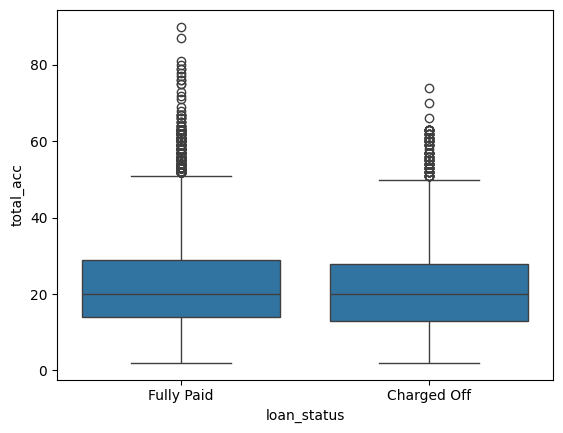

Creating Boxplot for  pub_rec_bankruptcies vs Loan Status
pub_rec_bankruptcies
0.0    36935
1.0     1637
2.0        5
Name: count, dtype: int64


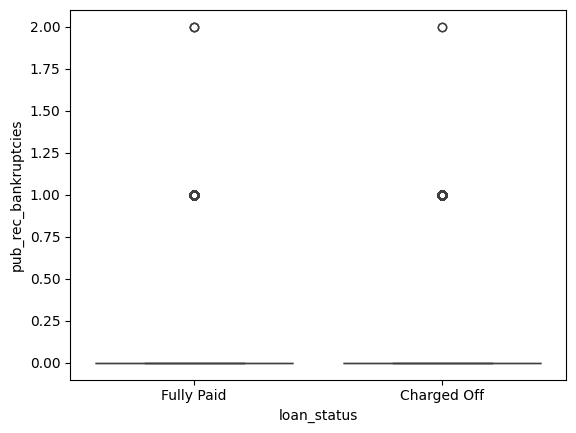

In [19]:
for cat in cat_cols:
  print('Creating Boxplot for ', cat, 'vs Loan Status')
  sns.boxplot(x = df['loan_status'], y = df[cat])
  print(df[cat].value_counts())
  plt.show()

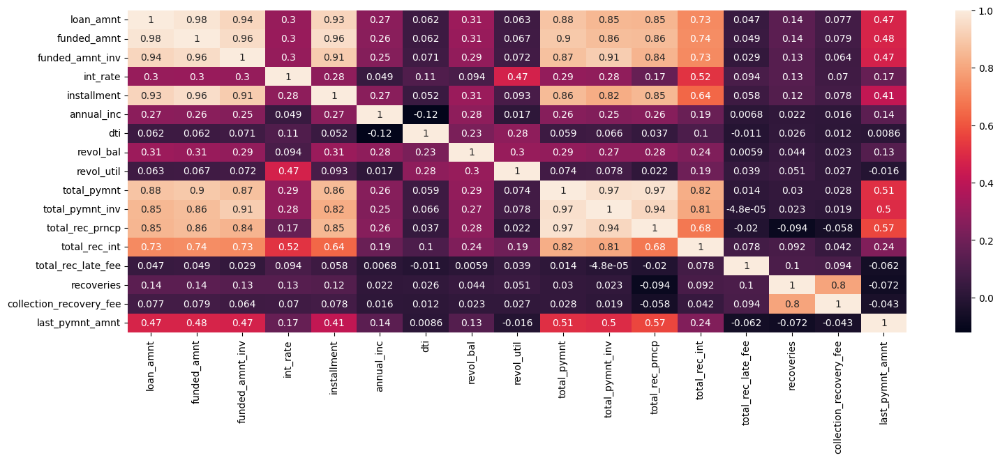

In [22]:
# Multivariate Analysis of Numerical Columns
df['int_rate'] = df['int_rate'].str.replace('%', '').astype(float)

# Perform correlation analysis
plt.figure(figsize=(18, 6))
sns.heatmap(df[num_cols].corr(), annot=True)
plt.show()
